# CSE 576 (Spring 2020) Homework 4

Welcome friends, it's time for Deep Learning with PyTorch! This homework might need a longer running time. 
Keep this in mind and start early.

PyTorch is a deep learning framework for fast, flexible experimentation. We are going to use it to train our classifiers.

For this homework you need to turn in this file `hw4.ipynb` after running your results and answering questions in-line.

**Notes**: 
 - This assignment was designed to be used with Google Colab, but feel free to set up your own environment if you wish. Just bear in mind that we cannot provide support for custom environments.
 - Feel free to create new cells as needed, but please **do not delete existing cells**.

Before you get started, we suggest you do the [PyTorch tutorial first](https://github.com/param087/Pytorch-tutorial-on-Google-colab).

You should at least do the 60 Minute Blitz up until "Training a Classifier".

**How to use this notebook:**
 - Each cell with a grey background is executable.
 - They can be executed by pressing the "Play" button or by hitting `Shift+Enter`
 - Cells can be executed out of order.
 - You can add new cells by clicking on the `+ Code` button in the header.
 - Made a mistake a need to start over? Click *(Runtime => Restart runtime)*
 - Check out this [Colab Introduction](https://colab.research.google.com/notebooks/intro.ipynb#scrollTo=5fCEDCU_qrC0) if you're having trouble.


 This will make sure that your progress will be saved to your Google Drive, and won't be lost if your browser refreshes for some reason. 

## Setup

This will set up the environment without GPUs. This is the recommended setup.

In [1]:
! pip install torch==1.5.0+cpu torchvision==0.6.0+cpu -f https://download.pytorch.org/whl/torch_stable.html 
! pip install tqdm matplotlib

Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 127.3MB 88kB/s 
     |████████████████████████████████| 5.7MB 3.8MB/s 
  Found existing installation: torch 1.5.0+cu101
    Uninstalling torch-1.5.0+cu101:
      Successfully uninstalled torch-1.5.0+cu101
  Found existing installation: torchvision 0.6.0+cu101
    Uninstalling torchvision-0.6.0+cu101:
      Successfully uninstalled torchvision-0.6.0+cu101


In [0]:
# We're not using the GPU.
use_gpu = False

### With GPUs
If you're feeling adventurous you can use GPUs to accelerate training. Follow the following steps. Just note that GPUs might not be available. The course staff also can't provide support for GPU-related issues so if you're having trouble please just use the CPU runtime.

 1. Go to Runtime > Change runtime type and select 'GPU'
 2. Restart the Runtime, uncomment the commands below and run them.

In [3]:
# Install the necessary packages

! pip install torch==1.5.0+cu101 torchvision==0.6.0+cu101 -f https://download.pytorch.org/whl/torch_stable.html 
! pip install tqdm matplotlib

Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 703.8MB 26kB/s 
     |████████████████████████████████| 6.6MB 56.9MB/s 
  Found existing installation: torch 1.5.0+cpu
    Uninstalling torch-1.5.0+cpu:
      Successfully uninstalled torch-1.5.0+cpu
  Found existing installation: torchvision 0.6.0+cpu
    Uninstalling torchvision-0.6.0+cpu:
      Successfully uninstalled torchvision-0.6.0+cpu


If you want to use the GPU, uncomment the line below and run it.

In [0]:
# Uncomment this and execute if you're using the GPU.
use_gpu = True

### Check that things are working.

In [5]:
# Make sure things work.

import torch

if use_gpu:
    print(torch.zeros(10).cuda())
else:
    print(torch.zeros(10))

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0.], device='cuda:0')


 ## Initialize Datasets

 This code defines the data loaders that will be used to train and test our networks. It also defines data augmentation functions.

In [6]:
import torch
import torchvision
from torchvision import transforms

classes = ('plane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck')

default_train_transform = transforms.Compose([
    transforms.ToTensor(),
    # Normalize rescales and shifts the data so that it has a zero mean 
    # and unit variance. This reduces bias and makes it easier to learn!
    # The values here are the mean and variance of our inputs.
    # This will change the input images to be centered at 0 and be 
    # between -1 and 1.
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

default_test_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)), 
])


def get_train_loader(batch_size, transform=default_train_transform):
    trainset = torchvision.datasets.CIFAR10(
        root='./data', 
        train=True, 
        download=True, 
        transform=transform)
    return torch.utils.data.DataLoader(
        trainset, batch_size=batch_size, shuffle=True, num_workers=4)


def get_test_loader(batch_size, transform=default_test_transform):
    testset = torchvision.datasets.CIFAR10(
        root='./data', 
        train=False, 
        download=True, 
        transform=transform) 
    return torch.utils.data.DataLoader(
        testset, batch_size=batch_size, shuffle=False, num_workers=4)


# This downloads the datasets.
get_train_loader(1)
get_test_loader(1);

Failed download. Trying https -> http instead. Downloading http://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz to ./data/cifar-10-python.tar.gz


Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified


## Define code that trains and tests code.

This code will train your model. Feel free to read the code below, but we suggest you don't modify it unless you know what you're doing.

In [0]:
from matplotlib import pyplot as plt
from tqdm.auto import tqdm

# The function we'll call to train the network each epoch
def train(net, loader, optimizer, criterion, epoch, use_gpu=False):
    running_loss = 0.0
    total_loss = 0.0

    # Send the network to the correct device
    if use_gpu:
        net = net.cuda()
    else:
        net = net.cpu()

    # tqdm is a useful package for adding a progress bar to your loops
    pbar = tqdm(loader)
    for i, data in enumerate(pbar):
        inputs, labels = data

        # If we're using the GPU, send the data to the GPU
        if use_gpu:
            inputs, labels = inputs.cuda(), labels.cuda()

        optimizer.zero_grad()  # Set the gradients of the parameters to zero.
        outputs = net(inputs)  # Forward pass (send the images through the network)
        loss = criterion(outputs, labels)  # Compute the loss w.r.t the labels.
        loss.backward()  # Backward pass (compute gradients).
        optimizer.step()  # Use the gradients to update the weights of the network.

        running_loss += loss.item()
        total_loss += loss.item()
        pbar.set_description(f"[epoch {epoch+1}] loss = {running_loss/(i+1):.03f}")
    
    average_loss = total_loss / (i + 1)
    tqdm.write(f"Epoch {epoch} summary -- loss = {average_loss:.03f}")
    
    return average_loss


This code will evaluate the performance of you network. It won't update the weights, just compute from evaluation metrics.

In [0]:
from collections import defaultdict
from torchvision.utils import make_grid
from PIL import Image
from IPython import display as ipd


def show_hard_negatives(hard_negatives, label, nrow=10):
    """Visualizes hard negatives"""
    grid = make_grid([(im+1)/2 for im, score in hard_negatives[label]], 
                     nrow=nrow, padding=1)
    grid = grid.permute(1, 2, 0).mul(255).byte().cpu().data.numpy()
    ipd.display(Image.fromarray((grid)))


# The function we'll call to test the network
def test(net, loader, tag='', use_gpu=False, num_hard_negatives=10):
    correct = 0
    total = 0

    # Send the network to the correct device
    net = net.cuda() if use_gpu else net.cpu()
    # switching to evaluation mode to disable dropout during inference
    # net.eval()

    # Compute the overall accuracy of the network
    with torch.no_grad():
        for data in tqdm(loader, desc=f"Evaluating {tag}"):
            images, labels = data

            # If we're using the GPU, send the data to the GPU
            if use_gpu:
                images = images.cuda()
                labels = labels.cuda()

            # Forward pass (send the images through the network)
            outputs = net(images)

            # Take the output of the network, and extract the index 
            # of the largest prediction for each example
            _, predicted = torch.max(outputs.data, 1)

            # Count the number of correct predictions
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    average_accuracy = correct/total
    tqdm.write(f'{tag} accuracy of the network: {100*average_accuracy:.02f}%')

    # Repeat above, but estimate the testing accuracy for each of the labels
    class_correct = list(0. for i in range(10))
    class_total = list(0. for i in range(10))
    hard_negatives = defaultdict(list)
    with torch.no_grad():
        for data in loader:
            images, labels = data
            if use_gpu:
                images = images.cuda()
                labels = labels.cuda()
            outputs = net(images)
            predicted_scores, predicted_labels = torch.max(outputs, 1)
            correct_mask = (predicted_labels == labels).squeeze()
            incorrect_mask = ~correct_mask
            unique_labels, unique_counts = torch.unique(labels, return_counts=True)
            for l, c in zip(unique_labels, unique_counts):
                l = l.item()
                label_mask = (labels == l)
                predicted_mask = (predicted_labels == l)
                # This keeps track of the most hardest negatives
                # i.e. mistakes with the highest confidence.
                hard_negative_mask = (~correct_mask & predicted_mask)
                if hard_negative_mask.sum() > 0:
                    hard_negatives[l].extend([
                        (im, score.item()) 
                        for im, score in zip(images[hard_negative_mask], 
                                             predicted_scores[hard_negative_mask])])
                    hard_negatives[l].sort(key=lambda x: x[1], reverse=True)
                    hard_negatives[l] = hard_negatives[l][:num_hard_negatives]
                class_correct[l] += (correct_mask & label_mask).sum()
                class_total[l] += c


    for i in range(10):
        tqdm.write(f'{tag} accuracy of {classes[i]} = {100*class_correct[i]/class_total[i]:.02f}%')
        
        if not hard_negatives[i]:
          print(f'No hard negatives for class: {classes[i]}')
        else:
          print(f'Hard negatives for {classes[i]}')
          show_hard_negatives(hard_negatives, i, nrow=10)

    
    return average_accuracy

This is a wrapper function we provide that handles all the book keeping. It will train your network for an epoch and then test it every couple epochs.

In [0]:
def train_network(net, 
                  lr, 
                  epochs, 
                  batch_size, 
                  criterion=None,
                  lr_func=None,
                  train_transform=default_train_transform, 
                  eval_interval=10,
                  use_gpu=use_gpu): 
    # Initialize the optimizer
    optimizer = optim.SGD(net.parameters(), lr=lr)

    # Initialize the loss function
    if criterion is None:
        # Note that CrossEntropyLoss has the Softmax built in!
        # This is good for numerical stability. 
        # Read: https://pytorch.org/docs/stable/nn.html#torch.nn.CrossEntropyLoss
        criterion = nn.CrossEntropyLoss()

    # Initialize the data loaders
    train_loader = get_train_loader(batch_size, transform=train_transform)
    test_loader = get_test_loader(batch_size)
    
    train_losses = []
    train_accuracies = []
    test_accuracies = []

    for epoch in range(epochs):  # loop over the dataset multiple times
        if lr_func is not None:
            lr_func(optimizer, epoch, lr)

        train_loss = train(net, train_loader, optimizer, criterion, epoch, use_gpu=use_gpu)
        train_losses.append(train_loss)

        # Evaluate the model every `eval_interval` epochs.
        if (epoch + 1) % eval_interval == 0:
            print(f"Evaluating epoch {epoch+1}")
            train_accuracy = test(net, train_loader, 'Train', use_gpu=use_gpu)
            test_accuracy = test(net, test_loader, 'Test', use_gpu=use_gpu)
            train_accuracies.append(train_accuracy)
            test_accuracies.append(test_accuracy)
    
    return train_losses, train_accuracies, test_accuracies
    

# A function to plot the losses over time
def plot_results(train_losses, train_accuracies, test_accuracies):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    axes[0].plot(train_losses)
    axes[0].set_title('Training Loss')
    axes[0].set_xlabel('Epoch')
    axes[0].set_ylabel('Loss')
    
    axes[1].plot(train_accuracies)
    axes[1].set_title('Training Accuracy')
    axes[1].set_xlabel('Epoch')
    axes[1].set_ylabel('Accuracy')
    
    axes[2].plot(test_accuracies)
    axes[2].set_title('Testing Accuracy')
    axes[2].set_xlabel('Epoch')
    axes[2].set_ylabel('Accuracy')



## 2.1. Training a classifier using only one fully connected Layer

Implement a model to classify the images from Cifar-10 into ten categories using just one fully connected layer (remember that fully connected layers are called Linear in PyTorch).

If you are new to PyTorch you may want to check out the tutorial on MNIST [here](https://pytorch.org/tutorials/beginner/blitz/neural_networks_tutorial.html#sphx-glr-beginner-blitz-neural-networks-tutorial-py).

Fill in the code for LazyNet here.

**Hints:**
 - Note that `nn.CrossEntropyLoss` has the Softmax built in for numerical stability. This means that the output layer of your network should be linear and not contain a Softmax. You can read more about it [here](https://pytorch.org/docs/stable/nn.html#torch.nn.CrossEntropyLoss)
 - You can use the `view()` function to flatten your input image to a vector e.g., if `x` is a `(100,3,4,4)` tensor then `x.view(-1, 3*4*4)` will flatten it into a vector of size `48`.
 - The images in MNIST are 32x32.

In [10]:
from torch import nn
from torch import optim

class LazyNet(nn.Module):
    def __init__(self):
        super().__init__()
        # TODO: Define model here
        self.fc1 = torch.nn.Linear(3*32*32, 10)

    def forward(self, x):
        # TODO: Implement forward pass for LazyNet
        x = x.view(-1, 3*32*32)
        x = self.fc1(x)
        return x

net = LazyNet()
net

LazyNet(
  (fc1): Linear(in_features=3072, out_features=10, bias=True)
)

#### Run the model for 15 epochs and report the plots and accuracies.

Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 2.047



Epoch 1 summary -- loss = 1.907



Epoch 2 summary -- loss = 1.863



Epoch 3 summary -- loss = 1.839



Epoch 4 summary -- loss = 1.822
Evaluating epoch 5



Train accuracy of the network: 38.53%
Train accuracy of plane = 41.92%
Hard negatives for plane


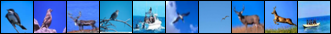

Train accuracy of car = 43.74%
Hard negatives for car


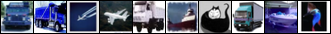

Train accuracy of bird = 17.26%
Hard negatives for bird


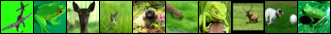

Train accuracy of cat = 15.02%
Hard negatives for cat


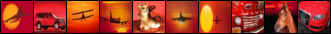

Train accuracy of deer = 33.88%
Hard negatives for deer


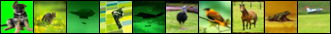

Train accuracy of dog = 34.84%
Hard negatives for dog


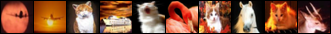

Train accuracy of frog = 52.74%
Hard negatives for frog


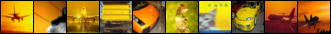

Train accuracy of horse = 39.94%
Hard negatives for horse


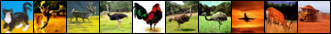

Train accuracy of ship = 54.90%
Hard negatives for ship


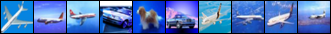

Train accuracy of truck = 51.08%
Hard negatives for truck


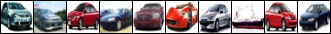


Test accuracy of the network: 38.36%
Test accuracy of plane = 41.80%
Hard negatives for plane


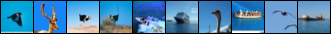

Test accuracy of car = 42.90%
Hard negatives for car


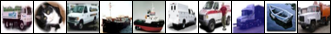

Test accuracy of bird = 18.70%
Hard negatives for bird


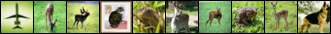

Test accuracy of cat = 15.20%
Hard negatives for cat


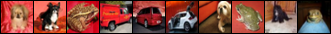

Test accuracy of deer = 32.80%
Hard negatives for deer


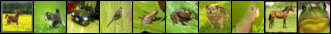

Test accuracy of dog = 32.80%
Hard negatives for dog


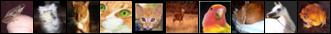

Test accuracy of frog = 53.50%
Hard negatives for frog


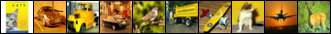

Test accuracy of horse = 40.30%
Hard negatives for horse


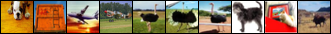

Test accuracy of ship = 53.90%
Hard negatives for ship


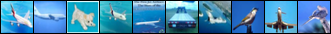

Test accuracy of truck = 51.70%
Hard negatives for truck


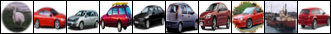


Epoch 5 summary -- loss = 1.809



Epoch 6 summary -- loss = 1.799



Epoch 7 summary -- loss = 1.791



Epoch 8 summary -- loss = 1.783



Epoch 9 summary -- loss = 1.777
Evaluating epoch 10



Train accuracy of the network: 40.14%
Train accuracy of plane = 42.58%
Hard negatives for plane


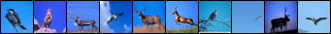

Train accuracy of car = 47.38%
Hard negatives for car


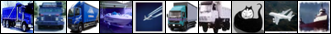

Train accuracy of bird = 20.34%
Hard negatives for bird


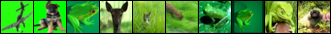

Train accuracy of cat = 20.62%
Hard negatives for cat


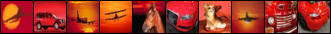

Train accuracy of deer = 33.38%
Hard negatives for deer


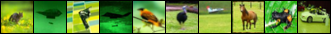

Train accuracy of dog = 31.16%
Hard negatives for dog


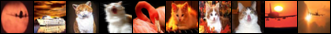

Train accuracy of frog = 55.06%
Hard negatives for frog


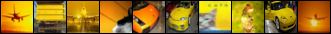

Train accuracy of horse = 43.16%
Hard negatives for horse


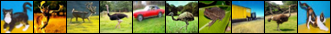

Train accuracy of ship = 55.60%
Hard negatives for ship


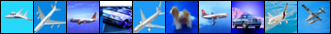

Train accuracy of truck = 52.12%
Hard negatives for truck


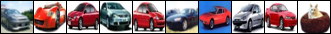


Test accuracy of the network: 39.52%
Test accuracy of plane = 42.90%
Hard negatives for plane


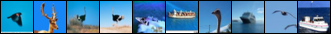

Test accuracy of car = 45.10%
Hard negatives for car


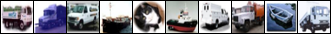

Test accuracy of bird = 20.00%
Hard negatives for bird


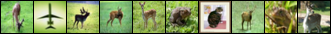

Test accuracy of cat = 20.90%
Hard negatives for cat


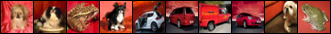

Test accuracy of deer = 31.70%
Hard negatives for deer


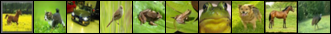

Test accuracy of dog = 30.00%
Hard negatives for dog


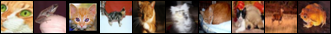

Test accuracy of frog = 55.20%
Hard negatives for frog


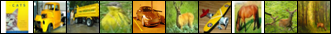

Test accuracy of horse = 42.50%
Hard negatives for horse


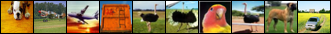

Test accuracy of ship = 54.60%
Hard negatives for ship


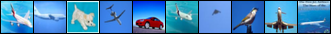

Test accuracy of truck = 52.30%
Hard negatives for truck


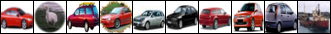


Epoch 10 summary -- loss = 1.772



Epoch 11 summary -- loss = 1.766



Epoch 12 summary -- loss = 1.762



Epoch 13 summary -- loss = 1.758



Epoch 14 summary -- loss = 1.754
Evaluating epoch 15



Train accuracy of the network: 40.93%
Train accuracy of plane = 43.60%
Hard negatives for plane


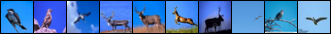

Train accuracy of car = 50.36%
Hard negatives for car


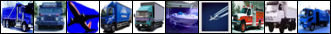

Train accuracy of bird = 22.30%
Hard negatives for bird


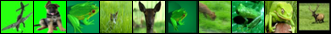

Train accuracy of cat = 20.70%
Hard negatives for cat


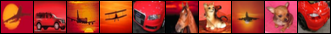

Train accuracy of deer = 32.16%
Hard negatives for deer


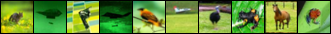

Train accuracy of dog = 32.28%
Hard negatives for dog


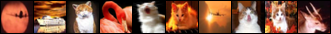

Train accuracy of frog = 55.72%
Hard negatives for frog


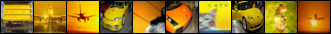

Train accuracy of horse = 44.32%
Hard negatives for horse


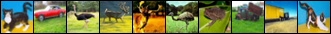

Train accuracy of ship = 55.62%
Hard negatives for ship


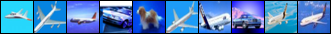

Train accuracy of truck = 52.26%
Hard negatives for truck


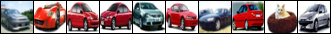


Test accuracy of the network: 40.04%
Test accuracy of plane = 43.50%
Hard negatives for plane


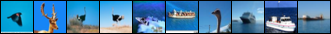

Test accuracy of car = 48.40%
Hard negatives for car


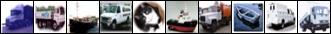

Test accuracy of bird = 21.30%
Hard negatives for bird


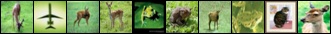

Test accuracy of cat = 19.90%
Hard negatives for cat


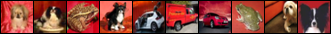

Test accuracy of deer = 29.40%
Hard negatives for deer


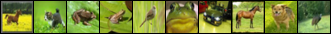

Test accuracy of dog = 31.20%
Hard negatives for dog


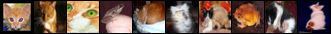

Test accuracy of frog = 56.80%
Hard negatives for frog


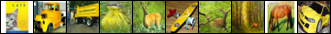

Test accuracy of horse = 43.80%
Hard negatives for horse


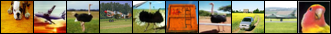

Test accuracy of ship = 54.80%
Hard negatives for ship


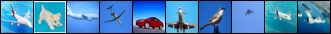

Test accuracy of truck = 51.30%
Hard negatives for truck


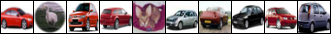

In [0]:
train_losses, train_accuracies, test_accuracies = train_network(
    net, 
    criterion=nn.CrossEntropyLoss(),
    lr=0.01, 
    epochs=15,
    eval_interval=5,
    batch_size=1024)

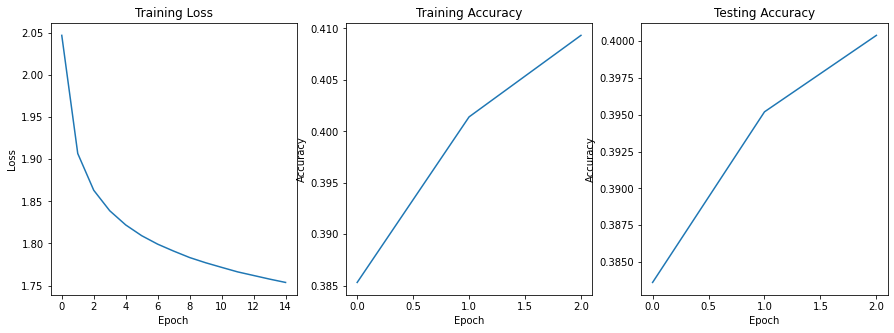

In [0]:
plot_results(train_losses, train_accuracies, test_accuracies)

Answer:

Using a classifier network with just one fully connected layer, the training accuracy is around 41% and test accuracy is around 40% (with batch size 1024, learning rate 0.01 and 15 training epochs)


## 2.2. Training a classifier using multiple fully connected layers ##

Implement a model for the same classification task using multiple fully connected layers.

Start with a fully connected layer that maps the data from image size (32 * 32 * 3) to a vector of size 120, followed by another fully connected that reduces the size to 84 and finally a layer that maps the vector of size 84 to 10 classes.

Use any activation you want.

Fill in the code for BoringNet below.

In [13]:
class BoringNet(nn.Module):
    def __init__(self):
        super().__init__()
        # TODO: Define model here
        self.fc1 = torch.nn.Linear(32*32*3, 120)
        self.fc2 = torch.nn.Linear(120, 84)
        self.fc3 = torch.nn.Linear(84, 10)
        self.relu = torch.nn.ReLU()
        
    def forward(self, x):
        # TODO: Implement forward pass for LazyNet
        x = x.view(-1, 32*32*3)
        x = self.fc1(x)
        x = self.relu(x)
        x = self.fc2(x)
        x = self.relu(x)
        x = self.fc3(x)
        return x

net = BoringNet()
net

BoringNet(
  (fc1): Linear(in_features=3072, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=10, bias=True)
  (relu): ReLU()
)

### Run the model for 30 epochs and report the plots and accuracies.

Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 2.292



Epoch 1 summary -- loss = 2.264



Epoch 2 summary -- loss = 2.233



Epoch 3 summary -- loss = 2.194



Epoch 4 summary -- loss = 2.152



Epoch 5 summary -- loss = 2.113



Epoch 6 summary -- loss = 2.078



Epoch 7 summary -- loss = 2.047



Epoch 8 summary -- loss = 2.019



Epoch 9 summary -- loss = 1.992
Evaluating epoch 10



Train accuracy of the network: 30.95%
Train accuracy of plane = 45.86%
Hard negatives for plane


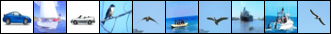

Train accuracy of car = 24.52%
Hard negatives for car


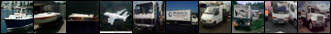

Train accuracy of bird = 1.96%
Hard negatives for bird


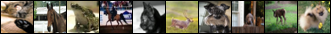

Train accuracy of cat = 3.36%
Hard negatives for cat


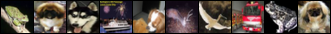

Train accuracy of deer = 25.20%
Hard negatives for deer


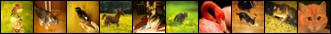

Train accuracy of dog = 26.42%
Hard negatives for dog


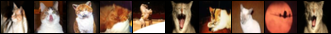

Train accuracy of frog = 52.68%
Hard negatives for frog


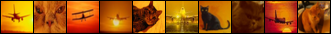

Train accuracy of horse = 31.12%
Hard negatives for horse


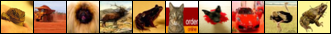

Train accuracy of ship = 48.08%
Hard negatives for ship


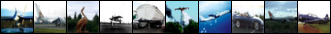

Train accuracy of truck = 50.32%
Hard negatives for truck


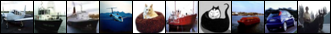


Test accuracy of the network: 31.60%
Test accuracy of plane = 49.50%
Hard negatives for plane


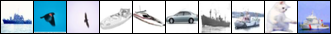

Test accuracy of car = 24.20%
Hard negatives for car


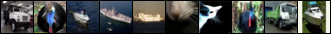

Test accuracy of bird = 2.30%
Hard negatives for bird


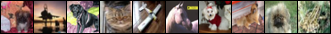

Test accuracy of cat = 2.70%
Hard negatives for cat


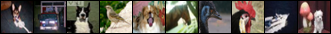

Test accuracy of deer = 24.70%
Hard negatives for deer


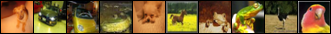

Test accuracy of dog = 26.20%
Hard negatives for dog


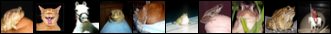

Test accuracy of frog = 55.40%
Hard negatives for frog


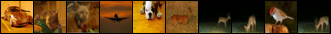

Test accuracy of horse = 30.40%
Hard negatives for horse


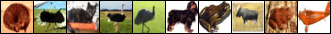

Test accuracy of ship = 50.10%
Hard negatives for ship


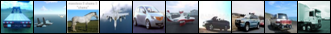

Test accuracy of truck = 50.50%
Hard negatives for truck


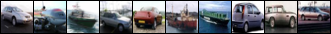


Epoch 10 summary -- loss = 1.967



Epoch 11 summary -- loss = 1.944



Epoch 12 summary -- loss = 1.924



Epoch 13 summary -- loss = 1.904



Epoch 14 summary -- loss = 1.887



Epoch 15 summary -- loss = 1.871



Epoch 16 summary -- loss = 1.855



Epoch 17 summary -- loss = 1.841



Epoch 18 summary -- loss = 1.828



Epoch 19 summary -- loss = 1.816
Evaluating epoch 20



Train accuracy of the network: 36.51%
Train accuracy of plane = 46.10%
Hard negatives for plane


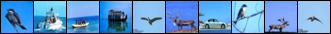

Train accuracy of car = 42.46%
Hard negatives for car


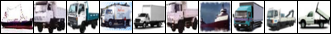

Train accuracy of bird = 10.60%
Hard negatives for bird


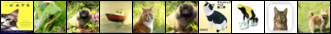

Train accuracy of cat = 9.78%
Hard negatives for cat


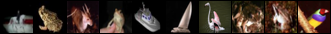

Train accuracy of deer = 29.20%
Hard negatives for deer


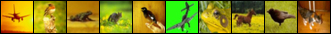

Train accuracy of dog = 39.30%
Hard negatives for dog


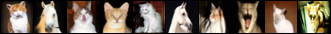

Train accuracy of frog = 49.16%
Hard negatives for frog


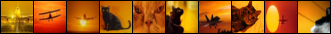

Train accuracy of horse = 39.82%
Hard negatives for horse


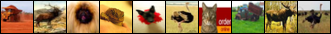

Train accuracy of ship = 52.24%
Hard negatives for ship


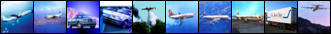

Train accuracy of truck = 46.46%
Hard negatives for truck


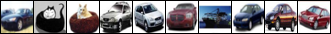


Test accuracy of the network: 36.59%
Test accuracy of plane = 47.70%
Hard negatives for plane


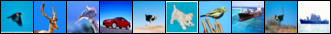

Test accuracy of car = 43.20%
Hard negatives for car


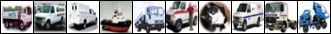

Test accuracy of bird = 10.40%
Hard negatives for bird


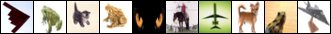

Test accuracy of cat = 8.60%
Hard negatives for cat


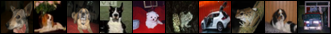

Test accuracy of deer = 29.90%
Hard negatives for deer


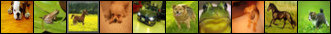

Test accuracy of dog = 38.70%
Hard negatives for dog


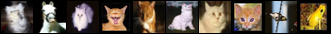

Test accuracy of frog = 49.20%
Hard negatives for frog


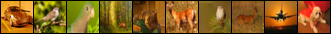

Test accuracy of horse = 39.90%
Hard negatives for horse


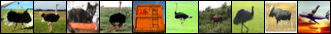

Test accuracy of ship = 52.50%
Hard negatives for ship


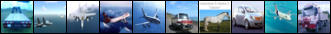

Test accuracy of truck = 45.80%
Hard negatives for truck


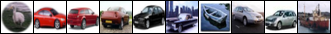


Epoch 20 summary -- loss = 1.804



Epoch 21 summary -- loss = 1.792



Epoch 22 summary -- loss = 1.781



Epoch 23 summary -- loss = 1.770



Epoch 24 summary -- loss = 1.760



Epoch 25 summary -- loss = 1.750



Epoch 26 summary -- loss = 1.740



Epoch 27 summary -- loss = 1.730



Epoch 28 summary -- loss = 1.722



Epoch 29 summary -- loss = 1.713
Evaluating epoch 30



Train accuracy of the network: 40.02%
Train accuracy of plane = 45.10%
Hard negatives for plane


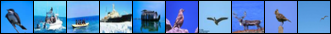

Train accuracy of car = 48.02%
Hard negatives for car


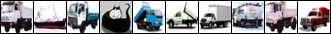

Train accuracy of bird = 20.40%
Hard negatives for bird


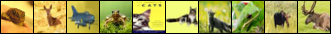

Train accuracy of cat = 22.30%
Hard negatives for cat


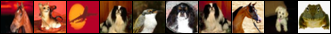

Train accuracy of deer = 31.32%
Hard negatives for deer


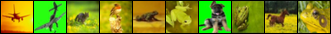

Train accuracy of dog = 37.32%
Hard negatives for dog


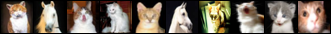

Train accuracy of frog = 49.84%
Hard negatives for frog


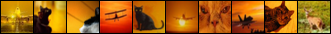

Train accuracy of horse = 43.40%
Hard negatives for horse


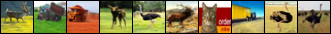

Train accuracy of ship = 55.70%
Hard negatives for ship


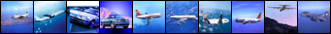

Train accuracy of truck = 46.82%
Hard negatives for truck


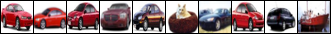


Test accuracy of the network: 40.21%
Test accuracy of plane = 46.70%
Hard negatives for plane


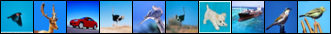

Test accuracy of car = 49.00%
Hard negatives for car


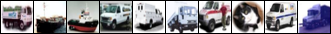

Test accuracy of bird = 20.70%
Hard negatives for bird


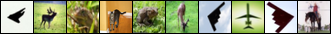

Test accuracy of cat = 21.10%
Hard negatives for cat


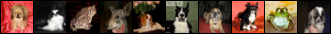

Test accuracy of deer = 31.90%
Hard negatives for deer


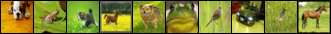

Test accuracy of dog = 36.80%
Hard negatives for dog


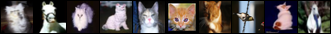

Test accuracy of frog = 50.10%
Hard negatives for frog


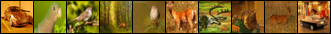

Test accuracy of horse = 43.90%
Hard negatives for horse


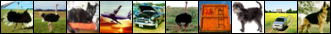

Test accuracy of ship = 55.70%
Hard negatives for ship


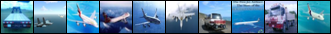

Test accuracy of truck = 46.20%
Hard negatives for truck


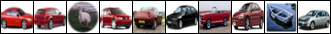

In [14]:
train_losses, train_accuracies, test_accuracies = train_network(
    net, 
    criterion=nn.CrossEntropyLoss(),
    lr=0.01, 
    epochs=30, 
    batch_size=1024)

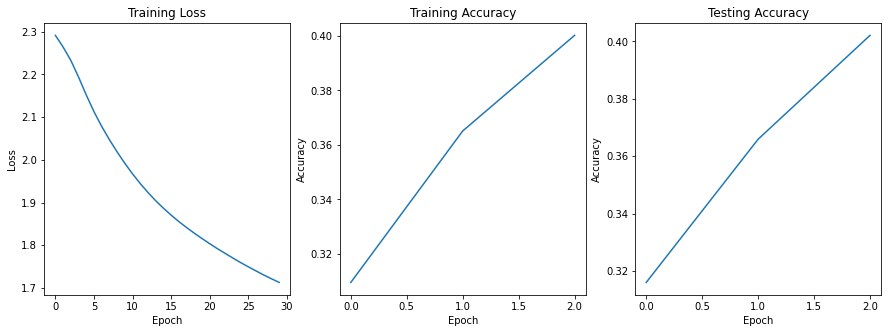

In [15]:
plot_results(train_losses, train_accuracies, test_accuracies)

Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 2.205



Epoch 1 summary -- loss = 2.083



Epoch 2 summary -- loss = 2.015



Epoch 3 summary -- loss = 1.969



Epoch 4 summary -- loss = 1.937



Epoch 5 summary -- loss = 1.914



Epoch 6 summary -- loss = 1.896



Epoch 7 summary -- loss = 1.881



Epoch 8 summary -- loss = 1.869



Epoch 9 summary -- loss = 1.857
Evaluating epoch 10



Train accuracy of the network: 36.50%
Train accuracy of plane = 43.92%
Hard negatives for plane


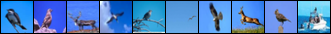

Train accuracy of car = 42.58%
Hard negatives for car


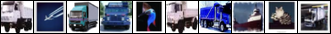

Train accuracy of bird = 16.26%
Hard negatives for bird


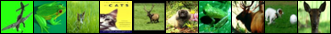

Train accuracy of cat = 12.68%
Hard negatives for cat


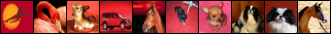

Train accuracy of deer = 31.96%
Hard negatives for deer


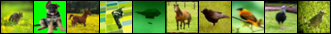

Train accuracy of dog = 31.98%
Hard negatives for dog


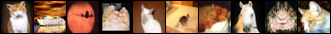

Train accuracy of frog = 52.34%
Hard negatives for frog


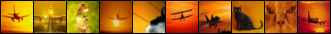

Train accuracy of horse = 32.30%
Hard negatives for horse


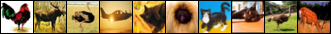

Train accuracy of ship = 50.12%
Hard negatives for ship


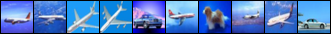

Train accuracy of truck = 50.88%
Hard negatives for truck


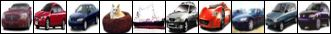


Test accuracy of the network: 36.48%
Test accuracy of plane = 45.60%
Hard negatives for plane


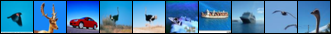

Test accuracy of car = 42.70%
Hard negatives for car


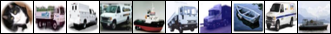

Test accuracy of bird = 17.00%
Hard negatives for bird


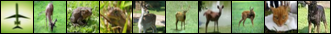

Test accuracy of cat = 12.70%
Hard negatives for cat


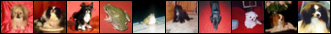

Test accuracy of deer = 29.00%
Hard negatives for deer


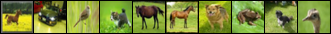

Test accuracy of dog = 30.80%
Hard negatives for dog


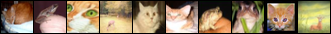

Test accuracy of frog = 53.90%
Hard negatives for frog


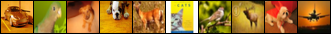

Test accuracy of horse = 31.80%
Hard negatives for horse


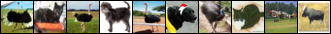

Test accuracy of ship = 50.60%
Hard negatives for ship


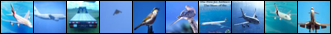

Test accuracy of truck = 50.70%
Hard negatives for truck


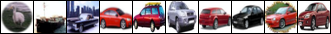


Epoch 10 summary -- loss = 1.848



Epoch 11 summary -- loss = 1.839



Epoch 12 summary -- loss = 1.831



Epoch 13 summary -- loss = 1.823



Epoch 14 summary -- loss = 1.816



Epoch 15 summary -- loss = 1.809



Epoch 16 summary -- loss = 1.803



Epoch 17 summary -- loss = 1.798



Epoch 18 summary -- loss = 1.792



Epoch 19 summary -- loss = 1.787
Evaluating epoch 20



Train accuracy of the network: 38.78%
Train accuracy of plane = 45.12%
Hard negatives for plane


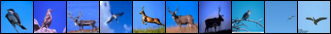

Train accuracy of car = 48.52%
Hard negatives for car


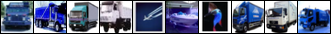

Train accuracy of bird = 21.34%
Hard negatives for bird


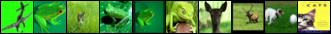

Train accuracy of cat = 20.50%
Hard negatives for cat


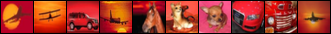

Train accuracy of deer = 30.60%
Hard negatives for deer


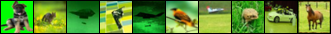

Train accuracy of dog = 33.30%
Hard negatives for dog


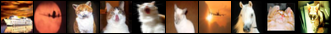

Train accuracy of frog = 49.94%
Hard negatives for frog


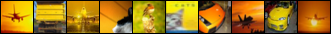

Train accuracy of horse = 39.04%
Hard negatives for horse


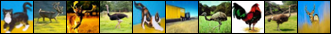

Train accuracy of ship = 50.72%
Hard negatives for ship


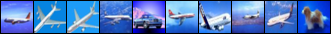

Train accuracy of truck = 48.76%
Hard negatives for truck


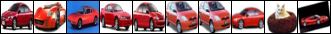


Test accuracy of the network: 38.64%
Test accuracy of plane = 45.50%
Hard negatives for plane


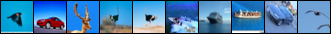

Test accuracy of car = 48.80%
Hard negatives for car


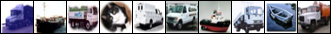

Test accuracy of bird = 22.30%
Hard negatives for bird


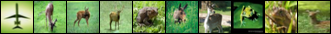

Test accuracy of cat = 19.70%
Hard negatives for cat


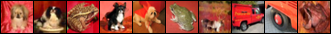

Test accuracy of deer = 30.30%
Hard negatives for deer


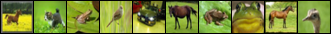

Test accuracy of dog = 31.50%
Hard negatives for dog


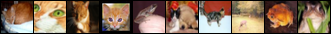

Test accuracy of frog = 50.70%
Hard negatives for frog


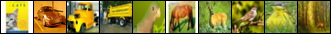

Test accuracy of horse = 39.40%
Hard negatives for horse


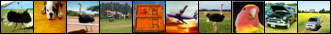

Test accuracy of ship = 50.20%
Hard negatives for ship


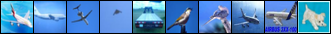

Test accuracy of truck = 48.00%
Hard negatives for truck


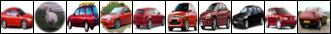


Epoch 20 summary -- loss = 1.783



Epoch 21 summary -- loss = 1.778



Epoch 22 summary -- loss = 1.774



Epoch 23 summary -- loss = 1.770



Epoch 24 summary -- loss = 1.767



Epoch 25 summary -- loss = 1.763



Epoch 26 summary -- loss = 1.760



Epoch 27 summary -- loss = 1.757



Epoch 28 summary -- loss = 1.753



Epoch 29 summary -- loss = 1.751
Evaluating epoch 30



Train accuracy of the network: 39.95%
Train accuracy of plane = 45.34%
Hard negatives for plane


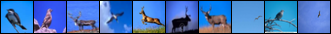

Train accuracy of car = 51.04%
Hard negatives for car


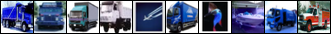

Train accuracy of bird = 23.96%
Hard negatives for bird


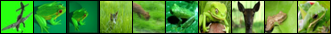

Train accuracy of cat = 23.34%
Hard negatives for cat


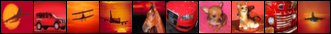

Train accuracy of deer = 27.58%
Hard negatives for deer


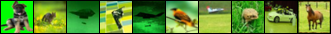

Train accuracy of dog = 33.64%
Hard negatives for dog


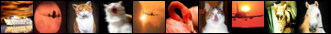

Train accuracy of frog = 51.08%
Hard negatives for frog


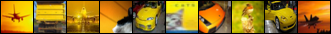

Train accuracy of horse = 42.60%
Hard negatives for horse


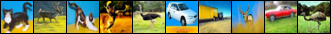

Train accuracy of ship = 52.16%
Hard negatives for ship


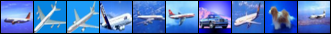

Train accuracy of truck = 48.74%
Hard negatives for truck


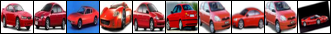


Test accuracy of the network: 39.85%
Test accuracy of plane = 45.60%
Hard negatives for plane


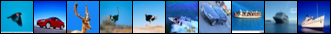

Test accuracy of car = 51.10%
Hard negatives for car


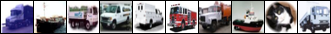

Test accuracy of bird = 24.10%
Hard negatives for bird


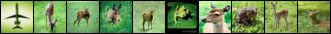

Test accuracy of cat = 22.90%
Hard negatives for cat


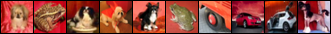

Test accuracy of deer = 27.20%
Hard negatives for deer


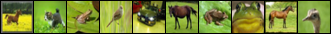

Test accuracy of dog = 32.20%
Hard negatives for dog


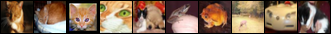

Test accuracy of frog = 53.90%
Hard negatives for frog


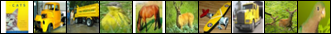

Test accuracy of horse = 43.20%
Hard negatives for horse


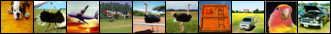

Test accuracy of ship = 51.20%
Hard negatives for ship


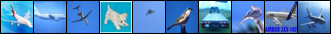

Test accuracy of truck = 47.10%
Hard negatives for truck


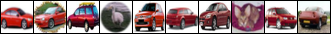

In [16]:
# without ReLU activation
class BoringNet(nn.Module):
    def __init__(self):
        super().__init__()
        # TODO: Define model here
        self.fc1 = torch.nn.Linear(32*32*3, 120)
        self.fc2 = torch.nn.Linear(120, 84)
        self.fc3 = torch.nn.Linear(84, 10)
        self.relu = torch.nn.ReLU()
        
    def forward(self, x):
        # TODO: Implement forward pass for LazyNet
        x = x.view(-1, 32*32*3)
        x = self.fc1(x)
        x = self.fc2(x)
        x = self.fc3(x)
        return x

net = BoringNet()
net

train_losses, train_accuracies, test_accuracies = train_network(
    net, 
    criterion=nn.CrossEntropyLoss(),
    lr=0.01, 
    epochs=30, 
    batch_size=1024)

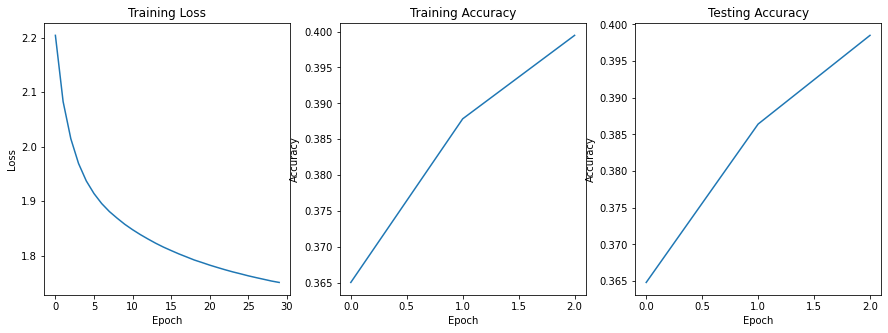

In [17]:
plot_results(train_losses, train_accuracies, test_accuracies)

### Question

Try training this model with and without activations. How does the activations (such as ReLU) affect the training process and why?


*TODO: Your answer here.*


Without any non-linear activations (such as ReLU), the neural network just learns a linear mapping from the input space to the output space, and is hence limited in performance when utilized for complex problems which can't be approximated via a linear transformation. Hence, after some time only during the training process, the training loss starts saturating. For example, in the above example, training loss gets saturated around 1.9-1.7 between 4th and 30th epochs. Also, the training accuracy (39.95%) and test accuracy (39.85%) are slightly lower than when using ReLU activation (40.2% and 40.02%), but this could be because it's simply a 3-layer fully connected neural network, with no convolutions.

When we use activations such as ReLU, we introduce non-linearity to the network and under the "Universal Approximation Theorem", one can approximate continuous functions using a feedforward fully connected layer with assumptions related to the activation function.

Even with variety of activations functions (such as sigmoid, tanh, ReLU), ReLU has an addded advantage as it doesn't squish the input into a very small range (vanishing gradient problem), thus its derivative doesn't saturate in one direction.


## 2.3. Training a classifier using convolutions ##

Implement a model using convolutional, pooling and fully connected layers.

You are free to choose any parameters for these layers (we would like you to play around with some values).

Fill in the code for CoolNet below. Explain why you have chosen these layers and how they affected the performance. Analyze the behavior of your model and report the plots in your report file.

In [34]:
class CoolNet(nn.Module):
    def __init__(self):
        super().__init__()
        # TODO: Define model here
        self.conv_block = torch.nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(),

            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2,2),

            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),

            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2,2),

            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),

            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2,2)
        )
        self.fc1 = nn.Linear(4096, 1024)
        self.relu = nn.ReLU()
        # self.dropout = nn.Dropout(p=0.25)
        self.fc2 = nn.Linear(1024, 128)
        self.fc3 = nn.Linear(128, 10)

    def forward(self, x):
        # TODO: Implement forward pass for LazyNet
        x = self.conv_block(x)
        x = x.view(x.size(0), -1)
        x = self.fc1(x)
        x = self.relu(x)
        # x = self.dropout(x)
        x = self.fc2(x)
        x = self.relu(x)
        x = self.fc3(x)
        return x

net = CoolNet()
net

CoolNet(
  (conv_block): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): ReLU()
    (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): ReLU()
    (11): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (12): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (14): ReLU()
    (15): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), 

Here, I have used 6 convolutional layers (to learn important low-level features such as edges and eventually high-level features as we go deep into network,taking advantage of local connectivity and parameter sharing ability of convolutional layers), each with a kernel size of 3x3, padding of 1 and stride of 1. An odd kernel size of 3 is chosen taking into consideration the property of symmetry of previous pixels around the output pixel as well as the input image size of 32x32. The output channels are increased subsequentally, from 3 to 32 to 64 to 128 to finally 256. 

In alternate layers, batch normalization and Max-pooling (to reduce output size) are used. ReLU activation is applied before max-pooling layer and after Batch normalization layers. Finally we use a dropout layer after the flattening layer to prevent over-fitting. And then used 3 fully connected layers with ReLU activation (except for last)

### Run the model for 30 epochs and report the plots and accuracies 

Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 2.293



Epoch 1 summary -- loss = 2.260



Epoch 2 summary -- loss = 2.187



Epoch 3 summary -- loss = 2.032



Epoch 4 summary -- loss = 1.847



Epoch 5 summary -- loss = 1.707



Epoch 6 summary -- loss = 1.617



Epoch 7 summary -- loss = 1.541



Epoch 8 summary -- loss = 1.477



Epoch 9 summary -- loss = 1.420
Evaluating epoch 10



Train accuracy of the network: 49.09%
Train accuracy of plane = 60.48%
Hard negatives for plane


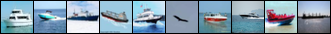

Train accuracy of car = 65.04%
Hard negatives for car


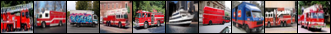

Train accuracy of bird = 32.74%
Hard negatives for bird


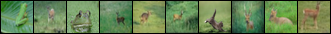

Train accuracy of cat = 41.68%
Hard negatives for cat


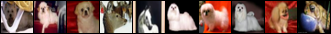

Train accuracy of deer = 30.08%
Hard negatives for deer


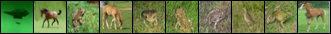

Train accuracy of dog = 32.06%
Hard negatives for dog


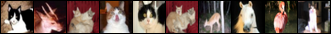

Train accuracy of frog = 65.74%
Hard negatives for frog


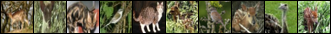

Train accuracy of horse = 53.98%
Hard negatives for horse


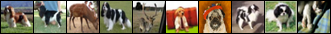

Train accuracy of ship = 50.80%
Hard negatives for ship


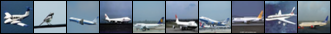

Train accuracy of truck = 57.58%
Hard negatives for truck


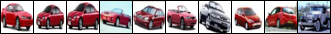


Test accuracy of the network: 48.42%
Test accuracy of plane = 60.40%
Hard negatives for plane


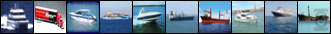

Test accuracy of car = 63.50%
Hard negatives for car


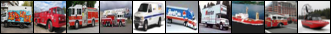

Test accuracy of bird = 30.70%
Hard negatives for bird


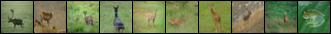

Test accuracy of cat = 37.20%
Hard negatives for cat


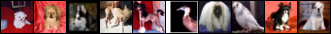

Test accuracy of deer = 29.40%
Hard negatives for deer


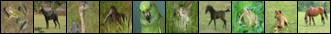

Test accuracy of dog = 33.70%
Hard negatives for dog


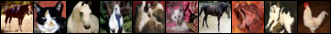

Test accuracy of frog = 67.50%
Hard negatives for frog


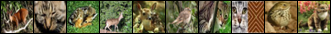

Test accuracy of horse = 58.00%
Hard negatives for horse


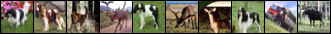

Test accuracy of ship = 48.80%
Hard negatives for ship


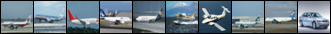

Test accuracy of truck = 55.00%
Hard negatives for truck


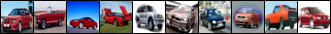


Epoch 10 summary -- loss = 1.381



Epoch 11 summary -- loss = 1.329



Epoch 12 summary -- loss = 1.294



Epoch 13 summary -- loss = 1.270



Epoch 14 summary -- loss = 1.225



Epoch 15 summary -- loss = 1.191



Epoch 16 summary -- loss = 1.158



Epoch 17 summary -- loss = 1.138



Epoch 18 summary -- loss = 1.099



Epoch 19 summary -- loss = 1.056
Evaluating epoch 20



Train accuracy of the network: 61.76%
Train accuracy of plane = 56.42%
Hard negatives for plane


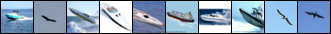

Train accuracy of car = 69.40%
Hard negatives for car


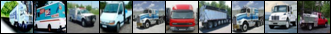

Train accuracy of bird = 39.50%
Hard negatives for bird


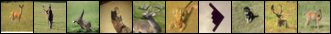

Train accuracy of cat = 51.68%
Hard negatives for cat


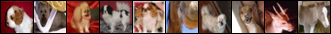

Train accuracy of deer = 48.08%
Hard negatives for deer


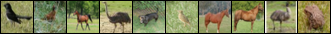

Train accuracy of dog = 41.72%
Hard negatives for dog


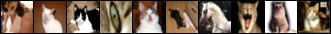

Train accuracy of frog = 77.72%
Hard negatives for frog


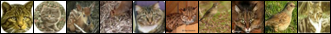

Train accuracy of horse = 69.92%
Hard negatives for horse


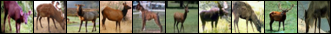

Train accuracy of ship = 77.24%
Hard negatives for ship


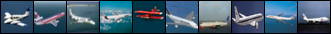

Train accuracy of truck = 85.46%
Hard negatives for truck


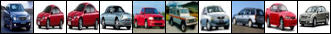


Test accuracy of the network: 60.51%
Test accuracy of plane = 55.40%
Hard negatives for plane


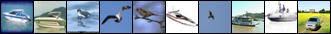

Test accuracy of car = 68.50%
Hard negatives for car


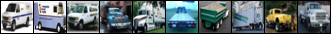

Test accuracy of bird = 37.20%
Hard negatives for bird


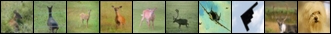

Test accuracy of cat = 51.20%
Hard negatives for cat


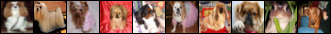

Test accuracy of deer = 46.60%
Hard negatives for deer


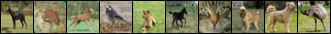

Test accuracy of dog = 41.90%
Hard negatives for dog


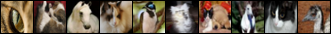

Test accuracy of frog = 77.70%
Hard negatives for frog


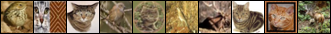

Test accuracy of horse = 68.10%
Hard negatives for horse


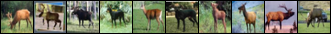

Test accuracy of ship = 75.30%
Hard negatives for ship


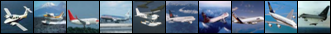

Test accuracy of truck = 83.20%
Hard negatives for truck


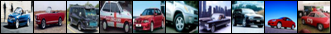


Epoch 20 summary -- loss = 1.033



Epoch 21 summary -- loss = 1.009



Epoch 22 summary -- loss = 0.975



Epoch 23 summary -- loss = 0.951



Epoch 24 summary -- loss = 0.933



Epoch 25 summary -- loss = 0.909



Epoch 26 summary -- loss = 0.885



Epoch 27 summary -- loss = 0.867



Epoch 28 summary -- loss = 0.845



Epoch 29 summary -- loss = 0.820
Evaluating epoch 30



Train accuracy of the network: 71.66%
Train accuracy of plane = 76.20%
Hard negatives for plane


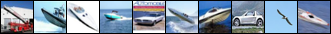

Train accuracy of car = 79.00%
Hard negatives for car


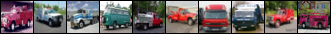

Train accuracy of bird = 65.32%
Hard negatives for bird


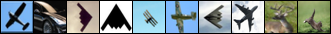

Train accuracy of cat = 60.14%
Hard negatives for cat


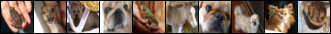

Train accuracy of deer = 71.70%
Hard negatives for deer


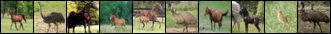

Train accuracy of dog = 50.88%
Hard negatives for dog


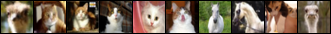

Train accuracy of frog = 78.84%
Hard negatives for frog


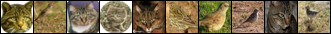

Train accuracy of horse = 71.42%
Hard negatives for horse


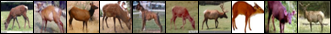

Train accuracy of ship = 87.24%
Hard negatives for ship


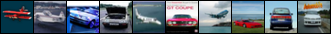

Train accuracy of truck = 76.06%
Hard negatives for truck


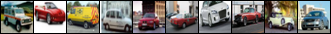


Test accuracy of the network: 68.98%
Test accuracy of plane = 73.50%
Hard negatives for plane


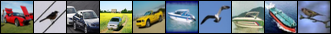

Test accuracy of car = 76.30%
Hard negatives for car


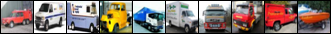

Test accuracy of bird = 59.80%
Hard negatives for bird


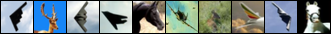

Test accuracy of cat = 57.60%
Hard negatives for cat


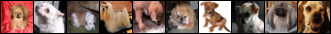

Test accuracy of deer = 68.00%
Hard negatives for deer


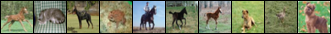

Test accuracy of dog = 49.40%
Hard negatives for dog


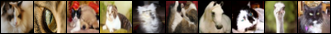

Test accuracy of frog = 77.60%
Hard negatives for frog


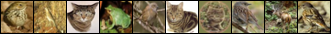

Test accuracy of horse = 69.50%
Hard negatives for horse


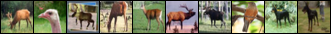

Test accuracy of ship = 84.60%
Hard negatives for ship


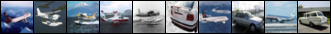

Test accuracy of truck = 73.50%
Hard negatives for truck


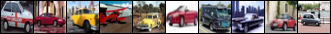

In [13]:
train_losses, train_accuracies, test_accuracies = train_network(
    net, 
    criterion=nn.CrossEntropyLoss(),
    lr=0.01, 
    epochs=30, 
    batch_size=1024)

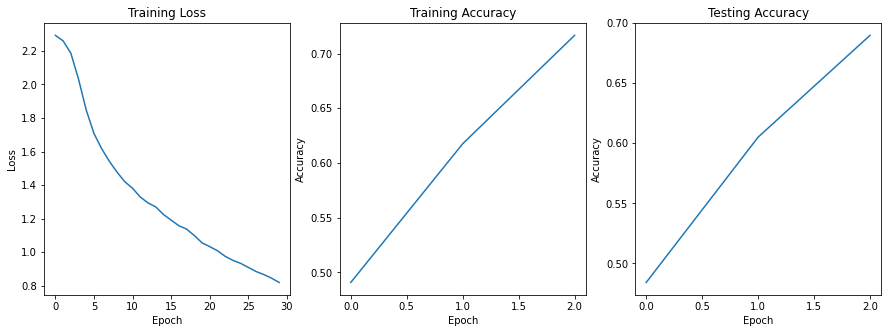

In [14]:
plot_results(train_losses, train_accuracies, test_accuracies)

Using the defined convolutional network (using max-pooling, batch normalization and dropout), the training accuracy and test accuracy improves to 71.67% and 69% as compared against the training accuracy of 40.2% and test accuracy of 40.02% when using the 3-layer fully connected network.

Since the loss doesn't get saturated, there's still potential to improve the model's performance by changing the learning rate and, scaling it (with \alpha < 1) in successive epochs.


### 2.3.1. How does batch size affect training?

Try using three different values for batch size. How do these values affect training and why?

Batch Size 32
Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 1.490



Epoch 1 summary -- loss = 0.939



Epoch 2 summary -- loss = 0.724



Epoch 3 summary -- loss = 0.592



Epoch 4 summary -- loss = 0.495



Epoch 5 summary -- loss = 0.410



Epoch 6 summary -- loss = 0.331



Epoch 7 summary -- loss = 0.263



Epoch 8 summary -- loss = 0.202



Epoch 9 summary -- loss = 0.151
Evaluating epoch 10



Train accuracy of the network: 96.84%
Train accuracy of plane = 97.68%
Hard negatives for plane


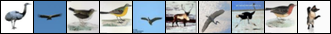

Train accuracy of car = 98.90%
Hard negatives for car


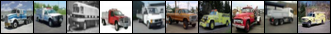

Train accuracy of bird = 95.84%
Hard negatives for bird


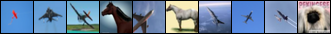

Train accuracy of cat = 90.68%
Hard negatives for cat


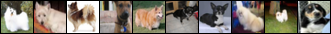

Train accuracy of deer = 97.94%
Hard negatives for deer


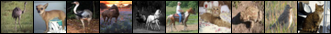

Train accuracy of dog = 94.84%
Hard negatives for dog


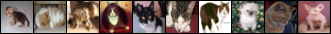

Train accuracy of frog = 97.92%
Hard negatives for frog


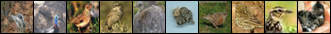

Train accuracy of horse = 97.02%
Hard negatives for horse


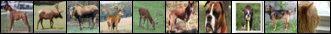

Train accuracy of ship = 99.38%
Hard negatives for ship


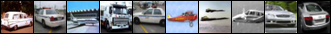

Train accuracy of truck = 97.48%
Hard negatives for truck


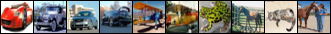


Test accuracy of the network: 82.27%
Test accuracy of plane = 86.20%
Hard negatives for plane


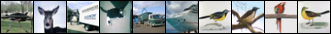

Test accuracy of car = 91.70%
Hard negatives for car


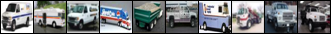

Test accuracy of bird = 73.80%
Hard negatives for bird


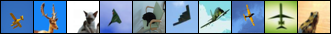

Test accuracy of cat = 60.00%
Hard negatives for cat


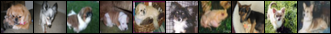

Test accuracy of deer = 85.30%
Hard negatives for deer


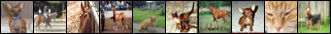

Test accuracy of dog = 75.50%
Hard negatives for dog


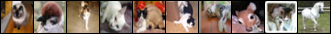

Test accuracy of frog = 87.20%
Hard negatives for frog


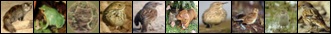

Test accuracy of horse = 82.10%
Hard negatives for horse


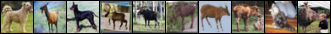

Test accuracy of ship = 92.80%
Hard negatives for ship


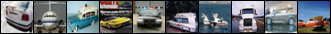

Test accuracy of truck = 88.10%
Hard negatives for truck


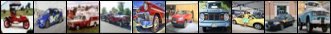


Epoch 10 summary -- loss = 0.107



Epoch 11 summary -- loss = 0.077



Epoch 12 summary -- loss = 0.055



Epoch 13 summary -- loss = 0.037



Epoch 14 summary -- loss = 0.026



Epoch 15 summary -- loss = 0.023



Epoch 16 summary -- loss = 0.014



Epoch 17 summary -- loss = 0.015



Epoch 18 summary -- loss = 0.004



Epoch 19 summary -- loss = 0.002
Evaluating epoch 20



Train accuracy of the network: 100.00%
Train accuracy of plane = 100.00%
No hard negatives for class: plane
Train accuracy of car = 100.00%
No hard negatives for class: car
Train accuracy of bird = 100.00%
No hard negatives for class: bird
Train accuracy of cat = 100.00%
No hard negatives for class: cat
Train accuracy of deer = 100.00%
No hard negatives for class: deer
Train accuracy of dog = 100.00%
No hard negatives for class: dog
Train accuracy of frog = 100.00%
No hard negatives for class: frog
Train accuracy of horse = 100.00%
No hard negatives for class: horse
Train accuracy of ship = 100.00%
No hard negatives for class: ship
Train accuracy of truck = 100.00%
No hard negatives for class: truck



Test accuracy of the network: 84.63%
Test accuracy of plane = 87.90%
Hard negatives for plane


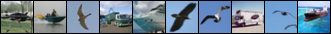

Test accuracy of car = 92.90%
Hard negatives for car


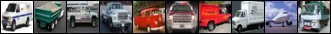

Test accuracy of bird = 77.30%
Hard negatives for bird


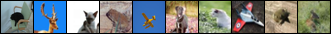

Test accuracy of cat = 68.80%
Hard negatives for cat


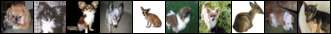

Test accuracy of deer = 84.70%
Hard negatives for deer


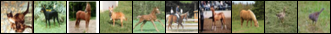

Test accuracy of dog = 77.10%
Hard negatives for dog


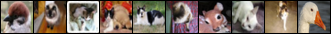

Test accuracy of frog = 89.60%
Hard negatives for frog


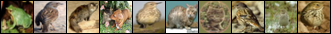

Test accuracy of horse = 87.20%
Hard negatives for horse


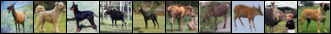

Test accuracy of ship = 90.80%
Hard negatives for ship


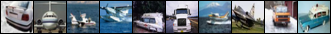

Test accuracy of truck = 90.00%
Hard negatives for truck


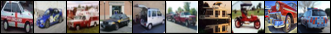


Epoch 20 summary -- loss = 0.001



Epoch 21 summary -- loss = 0.000



Epoch 22 summary -- loss = 0.000



Epoch 23 summary -- loss = 0.000



Epoch 24 summary -- loss = 0.000



Epoch 25 summary -- loss = 0.000



Epoch 26 summary -- loss = 0.000



Epoch 27 summary -- loss = 0.000



Epoch 28 summary -- loss = 0.000



Epoch 29 summary -- loss = 0.000
Evaluating epoch 30



Train accuracy of the network: 100.00%
Train accuracy of plane = 100.00%
No hard negatives for class: plane
Train accuracy of car = 100.00%
No hard negatives for class: car
Train accuracy of bird = 100.00%
No hard negatives for class: bird
Train accuracy of cat = 100.00%
No hard negatives for class: cat
Train accuracy of deer = 100.00%
No hard negatives for class: deer
Train accuracy of dog = 100.00%
No hard negatives for class: dog
Train accuracy of frog = 100.00%
No hard negatives for class: frog
Train accuracy of horse = 100.00%
No hard negatives for class: horse
Train accuracy of ship = 100.00%
No hard negatives for class: ship
Train accuracy of truck = 100.00%
No hard negatives for class: truck



Test accuracy of the network: 84.96%
Test accuracy of plane = 88.70%
Hard negatives for plane


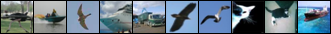

Test accuracy of car = 92.20%
Hard negatives for car


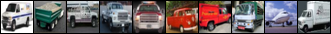

Test accuracy of bird = 78.70%
Hard negatives for bird


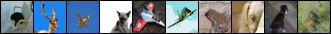

Test accuracy of cat = 69.50%
Hard negatives for cat


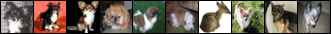

Test accuracy of deer = 84.60%
Hard negatives for deer


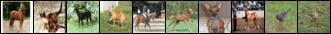

Test accuracy of dog = 77.60%
Hard negatives for dog


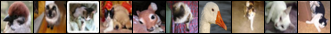

Test accuracy of frog = 89.30%
Hard negatives for frog


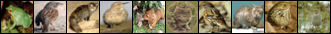

Test accuracy of horse = 87.40%
Hard negatives for horse


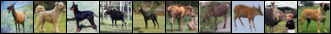

Test accuracy of ship = 90.90%
Hard negatives for ship


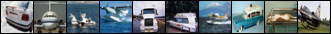

Test accuracy of truck = 90.70%
Hard negatives for truck


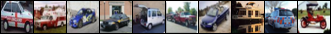

Batch Size 64
Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 1.691



Epoch 1 summary -- loss = 1.135



Epoch 2 summary -- loss = 0.879



Epoch 3 summary -- loss = 0.731



Epoch 4 summary -- loss = 0.626



Epoch 5 summary -- loss = 0.540



Epoch 6 summary -- loss = 0.471



Epoch 7 summary -- loss = 0.411



Epoch 8 summary -- loss = 0.352



Epoch 9 summary -- loss = 0.297
Evaluating epoch 10



Train accuracy of the network: 88.32%
Train accuracy of plane = 93.16%
Hard negatives for plane


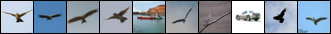

Train accuracy of car = 95.84%
Hard negatives for car


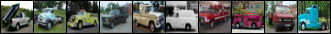

Train accuracy of bird = 58.38%
Hard negatives for bird


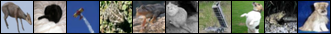

Train accuracy of cat = 85.18%
Hard negatives for cat


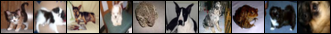

Train accuracy of deer = 84.20%
Hard negatives for deer


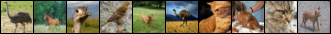

Train accuracy of dog = 88.02%
Hard negatives for dog


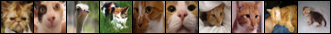

Train accuracy of frog = 86.36%
Hard negatives for frog


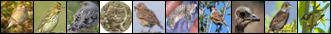

Train accuracy of horse = 98.74%
Hard negatives for horse


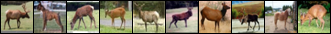

Train accuracy of ship = 98.34%
Hard negatives for ship


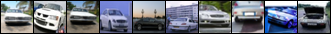

Train accuracy of truck = 96.70%
Hard negatives for truck


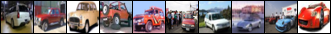


Test accuracy of the network: 77.41%
Test accuracy of plane = 82.60%
Hard negatives for plane


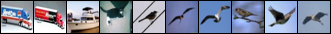

Test accuracy of car = 87.10%
Hard negatives for car


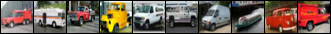

Test accuracy of bird = 42.70%
Hard negatives for bird


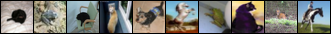

Test accuracy of cat = 69.80%
Hard negatives for cat


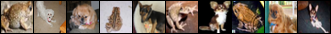

Test accuracy of deer = 71.00%
Hard negatives for deer


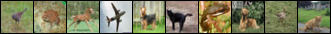

Test accuracy of dog = 74.20%
Hard negatives for dog


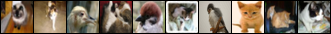

Test accuracy of frog = 76.10%
Hard negatives for frog


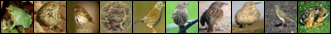

Test accuracy of horse = 90.50%
Hard negatives for horse


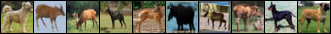

Test accuracy of ship = 91.90%
Hard negatives for ship


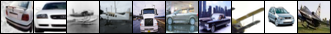

Test accuracy of truck = 88.20%
Hard negatives for truck


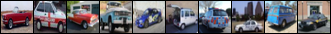


Epoch 10 summary -- loss = 0.245



Epoch 11 summary -- loss = 0.195



Epoch 12 summary -- loss = 0.159



Epoch 13 summary -- loss = 0.122



Epoch 14 summary -- loss = 0.095



Epoch 15 summary -- loss = 0.067



Epoch 16 summary -- loss = 0.045



Epoch 17 summary -- loss = 0.034



Epoch 18 summary -- loss = 0.022



Epoch 19 summary -- loss = 0.007
Evaluating epoch 20



Train accuracy of the network: 99.97%
Train accuracy of plane = 99.92%
No hard negatives for class: plane
Train accuracy of car = 99.98%
No hard negatives for class: car
Train accuracy of bird = 100.00%
Hard negatives for bird


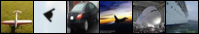

Train accuracy of cat = 100.00%
No hard negatives for class: cat
Train accuracy of deer = 99.98%
No hard negatives for class: deer
Train accuracy of dog = 100.00%
No hard negatives for class: dog
Train accuracy of frog = 100.00%
Hard negatives for frog


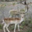

Train accuracy of horse = 100.00%
No hard negatives for class: horse
Train accuracy of ship = 99.98%
No hard negatives for class: ship
Train accuracy of truck = 100.00%
No hard negatives for class: truck



Test accuracy of the network: 82.76%
Test accuracy of plane = 84.00%
Hard negatives for plane


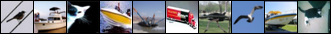

Test accuracy of car = 91.60%
Hard negatives for car


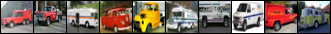

Test accuracy of bird = 79.50%
Hard negatives for bird


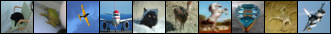

Test accuracy of cat = 71.70%
Hard negatives for cat


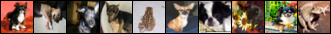

Test accuracy of deer = 77.00%
Hard negatives for deer


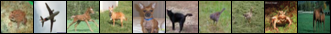

Test accuracy of dog = 74.20%
Hard negatives for dog


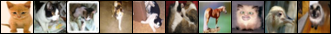

Test accuracy of frog = 87.10%
Hard negatives for frog


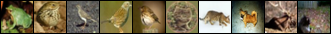

Test accuracy of horse = 85.00%
Hard negatives for horse


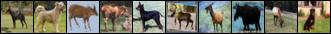

Test accuracy of ship = 90.00%
Hard negatives for ship


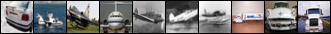

Test accuracy of truck = 87.50%
Hard negatives for truck


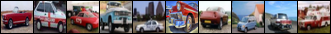


Epoch 20 summary -- loss = 0.003



Epoch 21 summary -- loss = 0.002



Epoch 22 summary -- loss = 0.002



Epoch 23 summary -- loss = 0.001



Epoch 24 summary -- loss = 0.001



Epoch 25 summary -- loss = 0.001



Epoch 26 summary -- loss = 0.001



Epoch 27 summary -- loss = 0.001



Epoch 28 summary -- loss = 0.001



Epoch 29 summary -- loss = 0.000
Evaluating epoch 30



Train accuracy of the network: 100.00%
Train accuracy of plane = 100.00%
No hard negatives for class: plane
Train accuracy of car = 100.00%
No hard negatives for class: car
Train accuracy of bird = 100.00%
No hard negatives for class: bird
Train accuracy of cat = 100.00%
No hard negatives for class: cat
Train accuracy of deer = 100.00%
No hard negatives for class: deer
Train accuracy of dog = 100.00%
No hard negatives for class: dog
Train accuracy of frog = 100.00%
No hard negatives for class: frog
Train accuracy of horse = 100.00%
No hard negatives for class: horse
Train accuracy of ship = 100.00%
No hard negatives for class: ship
Train accuracy of truck = 100.00%
No hard negatives for class: truck



Test accuracy of the network: 83.09%
Test accuracy of plane = 86.10%
Hard negatives for plane


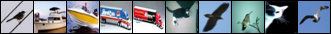

Test accuracy of car = 91.40%
Hard negatives for car


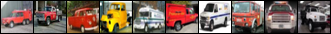

Test accuracy of bird = 76.30%
Hard negatives for bird


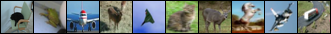

Test accuracy of cat = 65.60%
Hard negatives for cat


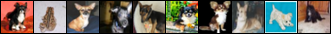

Test accuracy of deer = 80.00%
Hard negatives for deer


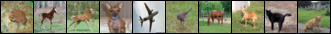

Test accuracy of dog = 77.30%
Hard negatives for dog


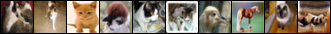

Test accuracy of frog = 86.50%
Hard negatives for frog


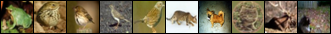

Test accuracy of horse = 87.70%
Hard negatives for horse


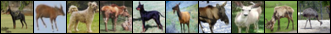

Test accuracy of ship = 90.40%
Hard negatives for ship


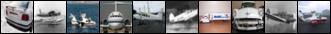

Test accuracy of truck = 89.60%
Hard negatives for truck


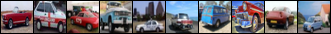

Batch Size 128
Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 1.920



Epoch 1 summary -- loss = 1.389



Epoch 2 summary -- loss = 1.153



Epoch 3 summary -- loss = 0.974



Epoch 4 summary -- loss = 0.844



Epoch 5 summary -- loss = 0.746



Epoch 6 summary -- loss = 0.667



Epoch 7 summary -- loss = 0.600



Epoch 8 summary -- loss = 0.541



Epoch 9 summary -- loss = 0.492
Evaluating epoch 10



Train accuracy of the network: 84.88%
Train accuracy of plane = 85.70%
Hard negatives for plane


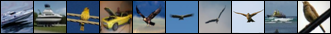

Train accuracy of car = 95.26%
Hard negatives for car


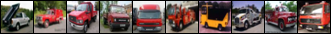

Train accuracy of bird = 84.58%
Hard negatives for bird


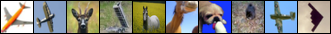

Train accuracy of cat = 82.50%
Hard negatives for cat


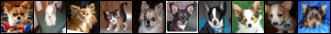

Train accuracy of deer = 88.04%
Hard negatives for deer


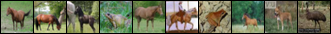

Train accuracy of dog = 53.28%
Hard negatives for dog


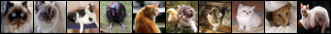

Train accuracy of frog = 82.60%
Hard negatives for frog


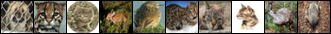

Train accuracy of horse = 90.04%
Hard negatives for horse


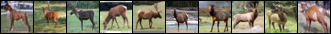

Train accuracy of ship = 94.62%
Hard negatives for ship


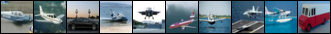

Train accuracy of truck = 92.26%
Hard negatives for truck


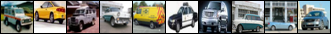


Test accuracy of the network: 77.35%
Test accuracy of plane = 77.90%
Hard negatives for plane


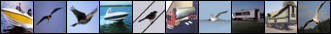

Test accuracy of car = 89.20%
Hard negatives for car


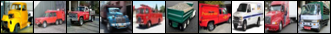

Test accuracy of bird = 73.30%
Hard negatives for bird


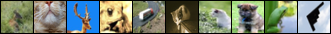

Test accuracy of cat = 72.10%
Hard negatives for cat


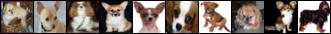

Test accuracy of deer = 79.80%
Hard negatives for deer


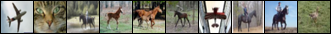

Test accuracy of dog = 49.20%
Hard negatives for dog


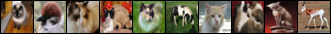

Test accuracy of frog = 77.00%
Hard negatives for frog


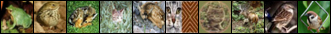

Test accuracy of horse = 82.60%
Hard negatives for horse


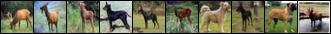

Test accuracy of ship = 87.10%
Hard negatives for ship


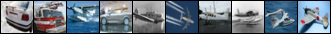

Test accuracy of truck = 85.30%
Hard negatives for truck


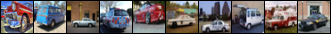


Epoch 10 summary -- loss = 0.439



Epoch 11 summary -- loss = 0.390



Epoch 12 summary -- loss = 0.350



Epoch 13 summary -- loss = 0.305



Epoch 14 summary -- loss = 0.269



Epoch 15 summary -- loss = 0.230



Epoch 16 summary -- loss = 0.191



Epoch 17 summary -- loss = 0.162



Epoch 18 summary -- loss = 0.138



Epoch 19 summary -- loss = 0.101
Evaluating epoch 20



Train accuracy of the network: 96.03%
Train accuracy of plane = 92.16%
Hard negatives for plane


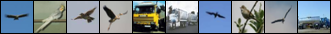

Train accuracy of car = 96.70%
Hard negatives for car


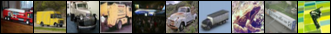

Train accuracy of bird = 94.94%
Hard negatives for bird


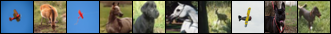

Train accuracy of cat = 90.84%
Hard negatives for cat


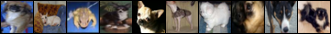

Train accuracy of deer = 98.48%
Hard negatives for deer


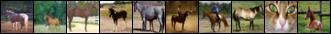

Train accuracy of dog = 97.04%
Hard negatives for dog


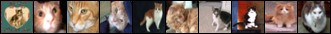

Train accuracy of frog = 98.92%
Hard negatives for frog


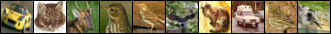

Train accuracy of horse = 96.80%
Hard negatives for horse


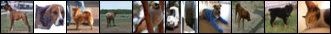

Train accuracy of ship = 99.82%
Hard negatives for ship


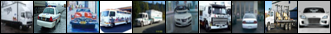

Train accuracy of truck = 94.68%
Hard negatives for truck


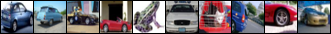


Test accuracy of the network: 78.78%
Test accuracy of plane = 74.20%
Hard negatives for plane


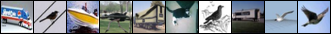

Test accuracy of car = 85.40%
Hard negatives for car


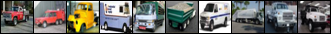

Test accuracy of bird = 65.60%
Hard negatives for bird


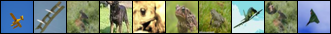

Test accuracy of cat = 58.40%
Hard negatives for cat


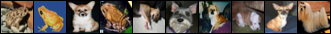

Test accuracy of deer = 79.90%
Hard negatives for deer


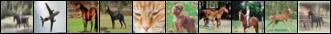

Test accuracy of dog = 80.10%
Hard negatives for dog


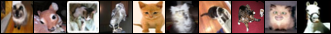

Test accuracy of frog = 86.50%
Hard negatives for frog


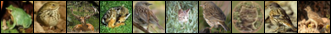

Test accuracy of horse = 81.10%
Hard negatives for horse


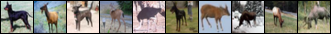

Test accuracy of ship = 94.20%
Hard negatives for ship


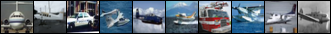

Test accuracy of truck = 82.40%
Hard negatives for truck


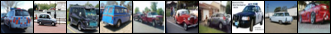


Epoch 20 summary -- loss = 0.100



Epoch 21 summary -- loss = 0.083



Epoch 22 summary -- loss = 0.042



Epoch 23 summary -- loss = 0.027



Epoch 24 summary -- loss = 0.083



Epoch 25 summary -- loss = 0.009



Epoch 26 summary -- loss = 0.005



Epoch 27 summary -- loss = 0.004



Epoch 28 summary -- loss = 0.003



Epoch 29 summary -- loss = 0.002
Evaluating epoch 30



Train accuracy of the network: 100.00%
Train accuracy of plane = 100.00%
No hard negatives for class: plane
Train accuracy of car = 100.00%
No hard negatives for class: car
Train accuracy of bird = 100.00%
No hard negatives for class: bird
Train accuracy of cat = 100.00%
No hard negatives for class: cat
Train accuracy of deer = 100.00%
No hard negatives for class: deer
Train accuracy of dog = 100.00%
No hard negatives for class: dog
Train accuracy of frog = 100.00%
No hard negatives for class: frog
Train accuracy of horse = 100.00%
No hard negatives for class: horse
Train accuracy of ship = 100.00%
No hard negatives for class: ship
Train accuracy of truck = 100.00%
No hard negatives for class: truck



Test accuracy of the network: 81.73%
Test accuracy of plane = 83.80%
Hard negatives for plane


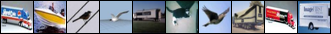

Test accuracy of car = 91.00%
Hard negatives for car


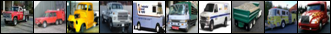

Test accuracy of bird = 72.80%
Hard negatives for bird


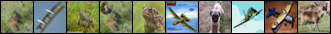

Test accuracy of cat = 68.50%
Hard negatives for cat


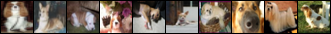

Test accuracy of deer = 77.40%
Hard negatives for deer


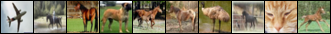

Test accuracy of dog = 74.70%
Hard negatives for dog


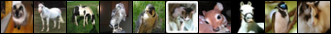

Test accuracy of frog = 86.70%
Hard negatives for frog


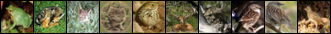

Test accuracy of horse = 85.50%
Hard negatives for horse


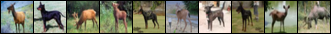

Test accuracy of ship = 89.20%
Hard negatives for ship


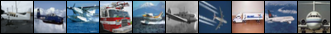

Test accuracy of truck = 87.70%
Hard negatives for truck


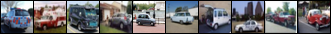

Batch Size 256
Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 2.154



Epoch 1 summary -- loss = 1.663



Epoch 2 summary -- loss = 1.444



Epoch 3 summary -- loss = 1.294



Epoch 4 summary -- loss = 1.160



Epoch 5 summary -- loss = 1.033



Epoch 6 summary -- loss = 0.939



Epoch 7 summary -- loss = 0.860



Epoch 8 summary -- loss = 0.795



Epoch 9 summary -- loss = 0.747
Evaluating epoch 10



Train accuracy of the network: 73.37%
Train accuracy of plane = 71.60%
Hard negatives for plane


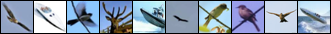

Train accuracy of car = 87.46%
Hard negatives for car


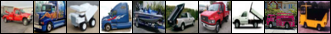

Train accuracy of bird = 36.84%
Hard negatives for bird


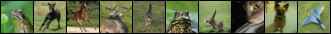

Train accuracy of cat = 40.82%
Hard negatives for cat


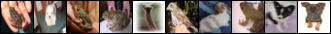

Train accuracy of deer = 77.16%
Hard negatives for deer


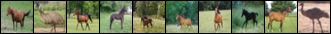

Train accuracy of dog = 78.38%
Hard negatives for dog


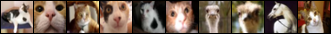

Train accuracy of frog = 79.50%
Hard negatives for frog


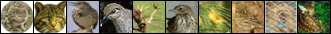

Train accuracy of horse = 83.26%
Hard negatives for horse


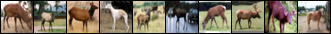

Train accuracy of ship = 85.06%
Hard negatives for ship


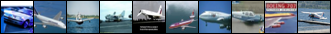

Train accuracy of truck = 92.76%
Hard negatives for truck


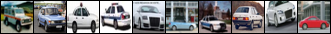


Test accuracy of the network: 70.30%
Test accuracy of plane = 68.70%
Hard negatives for plane


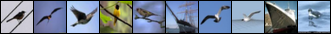

Test accuracy of car = 82.80%
Hard negatives for car


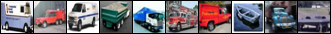

Test accuracy of bird = 32.60%
Hard negatives for bird


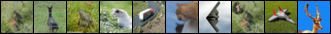

Test accuracy of cat = 40.00%
Hard negatives for cat


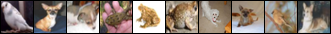

Test accuracy of deer = 74.40%
Hard negatives for deer


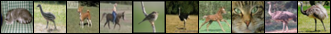

Test accuracy of dog = 76.00%
Hard negatives for dog


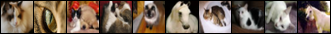

Test accuracy of frog = 77.20%
Hard negatives for frog


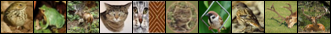

Test accuracy of horse = 81.60%
Hard negatives for horse


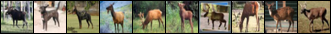

Test accuracy of ship = 80.50%
Hard negatives for ship


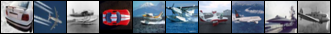

Test accuracy of truck = 89.20%
Hard negatives for truck


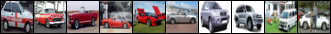


Epoch 10 summary -- loss = 0.692



Epoch 11 summary -- loss = 0.647



Epoch 12 summary -- loss = 0.616



Epoch 13 summary -- loss = 0.570



Epoch 14 summary -- loss = 0.532



Epoch 15 summary -- loss = 0.504



Epoch 16 summary -- loss = 0.468



Epoch 17 summary -- loss = 0.439



Epoch 18 summary -- loss = 0.404



Epoch 19 summary -- loss = 0.375
Evaluating epoch 20



Train accuracy of the network: 81.37%
Train accuracy of plane = 88.98%
Hard negatives for plane


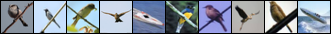

Train accuracy of car = 96.48%
Hard negatives for car


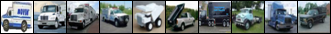

Train accuracy of bird = 79.98%
Hard negatives for bird


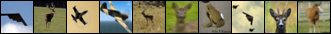

Train accuracy of cat = 52.02%
Hard negatives for cat


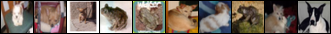

Train accuracy of deer = 58.32%
Hard negatives for deer


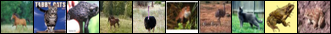

Train accuracy of dog = 88.26%
Hard negatives for dog


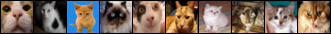

Train accuracy of frog = 60.70%
Hard negatives for frog


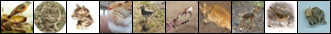

Train accuracy of horse = 97.62%
Hard negatives for horse


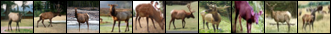

Train accuracy of ship = 96.16%
Hard negatives for ship


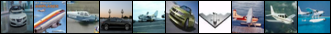

Train accuracy of truck = 94.46%
Hard negatives for truck


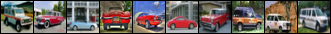


Test accuracy of the network: 71.94%
Test accuracy of plane = 79.10%
Hard negatives for plane


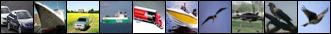

Test accuracy of car = 88.10%
Hard negatives for car


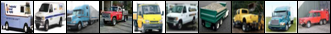

Test accuracy of bird = 65.60%
Hard negatives for bird


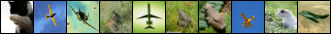

Test accuracy of cat = 42.70%
Hard negatives for cat


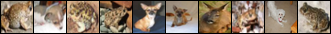

Test accuracy of deer = 46.30%
Hard negatives for deer


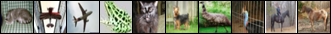

Test accuracy of dog = 80.00%
Hard negatives for dog


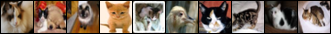

Test accuracy of frog = 53.30%
Hard negatives for frog


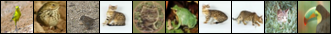

Test accuracy of horse = 91.20%
Hard negatives for horse


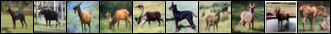

Test accuracy of ship = 87.40%
Hard negatives for ship


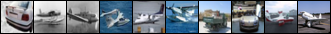

Test accuracy of truck = 85.70%
Hard negatives for truck


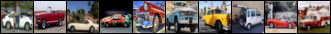


Epoch 20 summary -- loss = 0.357



Epoch 21 summary -- loss = 0.318



Epoch 22 summary -- loss = 0.291



Epoch 23 summary -- loss = 0.271



Epoch 24 summary -- loss = 0.227



Epoch 25 summary -- loss = 0.210



Epoch 26 summary -- loss = 0.192



Epoch 27 summary -- loss = 0.177



Epoch 28 summary -- loss = 0.157



Epoch 29 summary -- loss = 0.118
Evaluating epoch 30



Train accuracy of the network: 92.69%
Train accuracy of plane = 93.98%
Hard negatives for plane


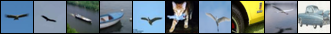

Train accuracy of car = 98.20%
Hard negatives for car


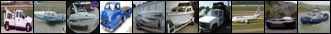

Train accuracy of bird = 88.40%
Hard negatives for bird


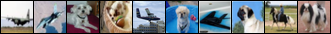

Train accuracy of cat = 75.80%
Hard negatives for cat


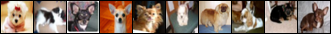

Train accuracy of deer = 97.78%
Hard negatives for deer


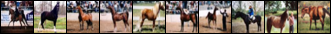

Train accuracy of dog = 83.84%
Hard negatives for dog


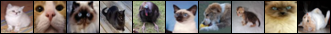

Train accuracy of frog = 99.70%
Hard negatives for frog


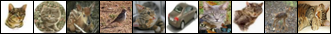

Train accuracy of horse = 94.02%
Hard negatives for horse


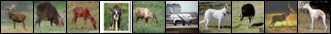

Train accuracy of ship = 97.92%
Hard negatives for ship


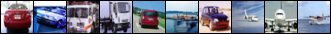

Train accuracy of truck = 97.98%
Hard negatives for truck


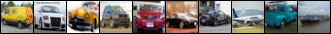


Test accuracy of the network: 75.39%
Test accuracy of plane = 75.60%
Hard negatives for plane


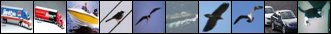

Test accuracy of car = 88.10%
Hard negatives for car


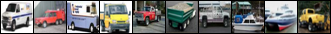

Test accuracy of bird = 61.10%
Hard negatives for bird


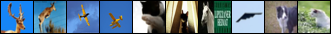

Test accuracy of cat = 48.90%
Hard negatives for cat


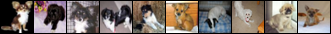

Test accuracy of deer = 79.90%
Hard negatives for deer


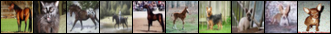

Test accuracy of dog = 62.10%
Hard negatives for dog


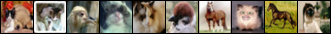

Test accuracy of frog = 92.40%
Hard negatives for frog


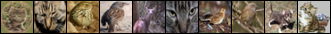

Test accuracy of horse = 76.40%
Hard negatives for horse


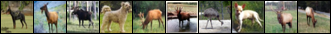

Test accuracy of ship = 84.40%
Hard negatives for ship


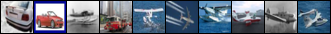

Test accuracy of truck = 85.00%
Hard negatives for truck


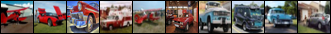

Batch Size 512
Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 2.265



Epoch 1 summary -- loss = 2.055



Epoch 2 summary -- loss = 1.765



Epoch 3 summary -- loss = 1.588



Epoch 4 summary -- loss = 1.474



Epoch 5 summary -- loss = 1.398



Epoch 6 summary -- loss = 1.335



Epoch 7 summary -- loss = 1.274



Epoch 8 summary -- loss = 1.205



Epoch 9 summary -- loss = 1.155
Evaluating epoch 10



Train accuracy of the network: 58.23%
Train accuracy of plane = 73.24%
Hard negatives for plane


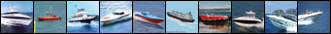

Train accuracy of car = 84.60%
Hard negatives for car


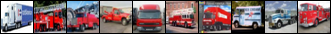

Train accuracy of bird = 52.82%
Hard negatives for bird


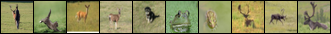

Train accuracy of cat = 27.30%
Hard negatives for cat


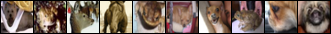

Train accuracy of deer = 49.08%
Hard negatives for deer


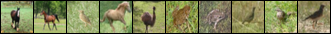

Train accuracy of dog = 59.54%
Hard negatives for dog


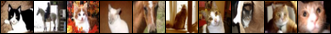

Train accuracy of frog = 52.28%
Hard negatives for frog


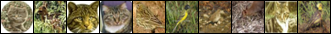

Train accuracy of horse = 73.06%
Hard negatives for horse


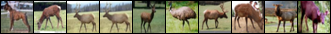

Train accuracy of ship = 56.42%
Hard negatives for ship


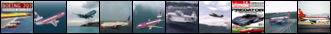

Train accuracy of truck = 53.44%
Hard negatives for truck


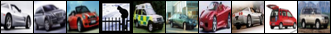


Test accuracy of the network: 56.90%
Test accuracy of plane = 71.20%
Hard negatives for plane


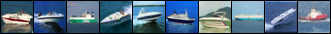

Test accuracy of car = 84.60%
Hard negatives for car


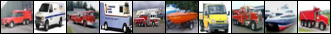

Test accuracy of bird = 50.40%
Hard negatives for bird


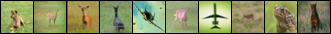

Test accuracy of cat = 24.50%
Hard negatives for cat


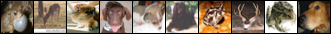

Test accuracy of deer = 47.90%
Hard negatives for deer


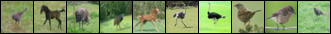

Test accuracy of dog = 58.70%
Hard negatives for dog


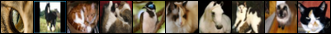

Test accuracy of frog = 52.00%
Hard negatives for frog


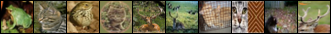

Test accuracy of horse = 74.00%
Hard negatives for horse


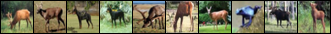

Test accuracy of ship = 54.70%
Hard negatives for ship


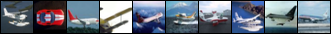

Test accuracy of truck = 51.00%
Hard negatives for truck


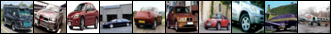


Epoch 10 summary -- loss = 1.091



Epoch 11 summary -- loss = 1.042



Epoch 12 summary -- loss = 0.986



Epoch 13 summary -- loss = 0.938



Epoch 14 summary -- loss = 0.901



Epoch 15 summary -- loss = 0.856



Epoch 16 summary -- loss = 0.817



Epoch 17 summary -- loss = 0.789



Epoch 18 summary -- loss = 0.742



Epoch 19 summary -- loss = 0.721
Evaluating epoch 20



Train accuracy of the network: 76.28%
Train accuracy of plane = 80.10%
Hard negatives for plane


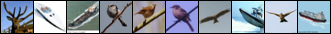

Train accuracy of car = 89.00%
Hard negatives for car


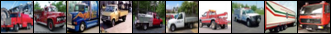

Train accuracy of bird = 66.98%
Hard negatives for bird


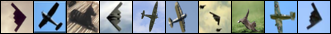

Train accuracy of cat = 50.94%
Hard negatives for cat


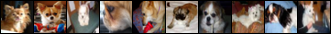

Train accuracy of deer = 78.44%
Hard negatives for deer


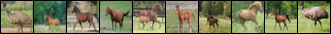

Train accuracy of dog = 61.30%
Hard negatives for dog


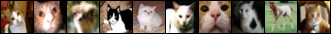

Train accuracy of frog = 80.50%
Hard negatives for frog


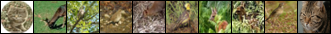

Train accuracy of horse = 77.00%
Hard negatives for horse


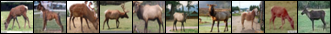

Train accuracy of ship = 89.60%
Hard negatives for ship


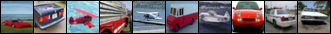

Train accuracy of truck = 89.34%
Hard negatives for truck


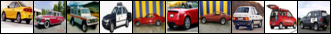


Test accuracy of the network: 71.76%
Test accuracy of plane = 73.50%
Hard negatives for plane


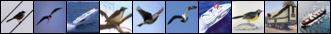

Test accuracy of car = 84.40%
Hard negatives for car


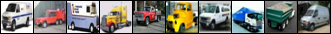

Test accuracy of bird = 59.60%
Hard negatives for bird


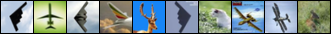

Test accuracy of cat = 45.80%
Hard negatives for cat


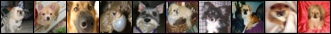

Test accuracy of deer = 74.90%
Hard negatives for deer


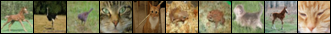

Test accuracy of dog = 57.30%
Hard negatives for dog


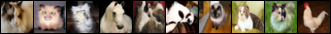

Test accuracy of frog = 79.10%
Hard negatives for frog


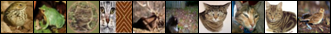

Test accuracy of horse = 73.20%
Hard negatives for horse


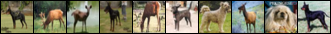

Test accuracy of ship = 84.40%
Hard negatives for ship


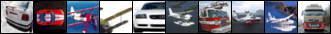

Test accuracy of truck = 85.40%
Hard negatives for truck


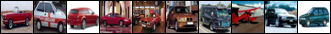


Epoch 20 summary -- loss = 0.693



Epoch 21 summary -- loss = 0.667



Epoch 22 summary -- loss = 0.635



Epoch 23 summary -- loss = 0.611



Epoch 24 summary -- loss = 0.595



Epoch 25 summary -- loss = 0.567



Epoch 26 summary -- loss = 0.547



Epoch 27 summary -- loss = 0.528



Epoch 28 summary -- loss = 0.503



Epoch 29 summary -- loss = 0.482
Evaluating epoch 30



Train accuracy of the network: 85.53%
Train accuracy of plane = 85.80%
Hard negatives for plane


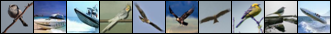

Train accuracy of car = 96.46%
Hard negatives for car


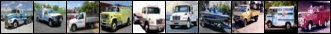

Train accuracy of bird = 75.98%
Hard negatives for bird


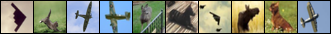

Train accuracy of cat = 72.42%
Hard negatives for cat


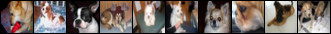

Train accuracy of deer = 84.14%
Hard negatives for deer


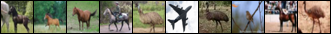

Train accuracy of dog = 74.46%
Hard negatives for dog


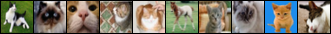

Train accuracy of frog = 92.74%
Hard negatives for frog


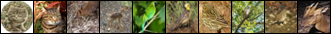

Train accuracy of horse = 87.34%
Hard negatives for horse


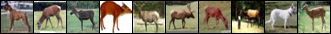

Train accuracy of ship = 96.94%
Hard negatives for ship


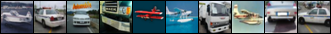

Train accuracy of truck = 88.72%
Hard negatives for truck


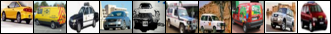


Test accuracy of the network: 75.70%
Test accuracy of plane = 75.90%
Hard negatives for plane


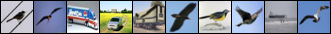

Test accuracy of car = 90.60%
Hard negatives for car


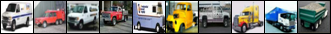

Test accuracy of bird = 58.80%
Hard negatives for bird


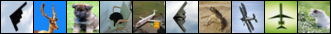

Test accuracy of cat = 59.50%
Hard negatives for cat


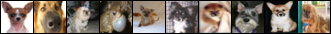

Test accuracy of deer = 73.30%
Hard negatives for deer


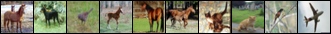

Test accuracy of dog = 64.20%
Hard negatives for dog


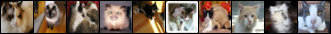

Test accuracy of frog = 86.50%
Hard negatives for frog


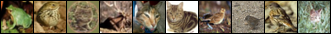

Test accuracy of horse = 77.70%
Hard negatives for horse


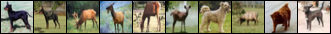

Test accuracy of ship = 90.90%
Hard negatives for ship


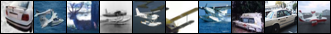

Test accuracy of truck = 79.60%
Hard negatives for truck


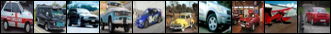

Batch Size 1024
Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 2.289



Epoch 1 summary -- loss = 2.239



Epoch 2 summary -- loss = 2.128



Epoch 3 summary -- loss = 1.970



Epoch 4 summary -- loss = 1.797



Epoch 5 summary -- loss = 1.685



Epoch 6 summary -- loss = 1.608



Epoch 7 summary -- loss = 1.541



Epoch 8 summary -- loss = 1.477



Epoch 9 summary -- loss = 1.417
Evaluating epoch 10



Train accuracy of the network: 50.15%
Train accuracy of plane = 54.18%
Hard negatives for plane


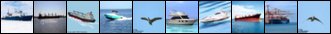

Train accuracy of car = 56.54%
Hard negatives for car


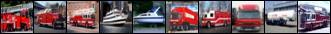

Train accuracy of bird = 29.44%
Hard negatives for bird


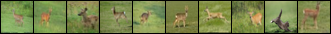

Train accuracy of cat = 33.22%
Hard negatives for cat


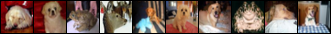

Train accuracy of deer = 28.62%
Hard negatives for deer


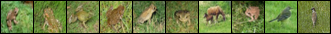

Train accuracy of dog = 43.24%
Hard negatives for dog


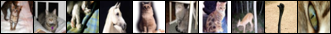

Train accuracy of frog = 63.70%
Hard negatives for frog


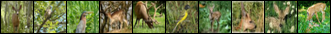

Train accuracy of horse = 56.60%
Hard negatives for horse


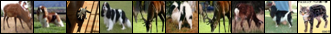

Train accuracy of ship = 68.12%
Hard negatives for ship


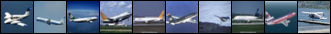

Train accuracy of truck = 67.96%
Hard negatives for truck


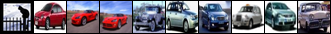


Test accuracy of the network: 49.23%
Test accuracy of plane = 53.90%
Hard negatives for plane


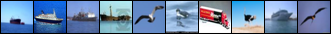

Test accuracy of car = 55.90%
Hard negatives for car


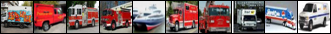

Test accuracy of bird = 25.20%
Hard negatives for bird


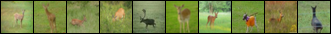

Test accuracy of cat = 28.30%
Hard negatives for cat


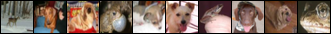

Test accuracy of deer = 28.80%
Hard negatives for deer


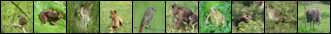

Test accuracy of dog = 43.00%
Hard negatives for dog


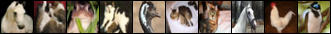

Test accuracy of frog = 65.90%
Hard negatives for frog


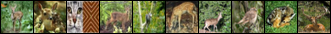

Test accuracy of horse = 59.60%
Hard negatives for horse


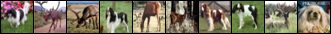

Test accuracy of ship = 66.40%
Hard negatives for ship


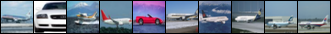

Test accuracy of truck = 65.30%
Hard negatives for truck


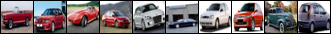


Epoch 10 summary -- loss = 1.371



Epoch 11 summary -- loss = 1.313



Epoch 12 summary -- loss = 1.277



Epoch 13 summary -- loss = 1.240



Epoch 14 summary -- loss = 1.209



Epoch 15 summary -- loss = 1.167



Epoch 16 summary -- loss = 1.131



Epoch 17 summary -- loss = 1.105



Epoch 18 summary -- loss = 1.069



Epoch 19 summary -- loss = 1.026
Evaluating epoch 20



Train accuracy of the network: 62.16%
Train accuracy of plane = 63.70%
Hard negatives for plane


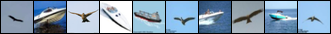

Train accuracy of car = 60.84%
Hard negatives for car


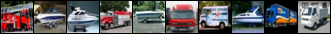

Train accuracy of bird = 41.60%
Hard negatives for bird


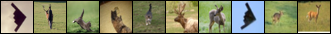

Train accuracy of cat = 44.24%
Hard negatives for cat


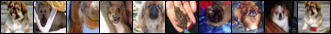

Train accuracy of deer = 41.52%
Hard negatives for deer


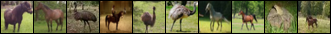

Train accuracy of dog = 54.86%
Hard negatives for dog


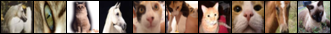

Train accuracy of frog = 84.18%
Hard negatives for frog


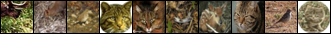

Train accuracy of horse = 62.08%
Hard negatives for horse


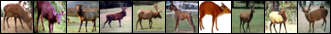

Train accuracy of ship = 80.32%
Hard negatives for ship


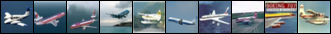

Train accuracy of truck = 87.72%
Hard negatives for truck


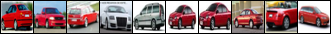


Test accuracy of the network: 60.72%
Test accuracy of plane = 62.60%
Hard negatives for plane


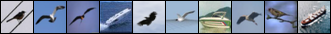

Test accuracy of car = 60.80%
Hard negatives for car


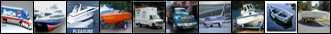

Test accuracy of bird = 37.60%
Hard negatives for bird


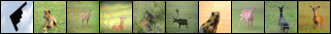

Test accuracy of cat = 41.40%
Hard negatives for cat


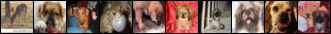

Test accuracy of deer = 40.00%
Hard negatives for deer


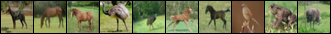

Test accuracy of dog = 54.80%
Hard negatives for dog


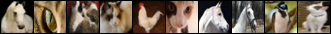

Test accuracy of frog = 84.40%
Hard negatives for frog


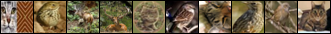

Test accuracy of horse = 62.20%
Hard negatives for horse


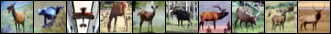

Test accuracy of ship = 76.80%
Hard negatives for ship


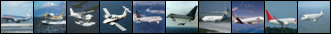

Test accuracy of truck = 86.60%
Hard negatives for truck


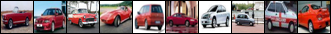


Epoch 20 summary -- loss = 1.004



Epoch 21 summary -- loss = 0.988



Epoch 22 summary -- loss = 0.950



Epoch 23 summary -- loss = 0.916



Epoch 24 summary -- loss = 0.914



Epoch 25 summary -- loss = 0.879



Epoch 26 summary -- loss = 0.864



Epoch 27 summary -- loss = 0.836



Epoch 28 summary -- loss = 0.817



Epoch 29 summary -- loss = 0.802
Evaluating epoch 30



Train accuracy of the network: 70.99%
Train accuracy of plane = 70.04%
Hard negatives for plane


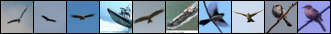

Train accuracy of car = 79.54%
Hard negatives for car


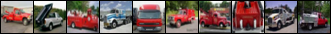

Train accuracy of bird = 64.52%
Hard negatives for bird


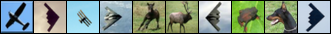

Train accuracy of cat = 65.16%
Hard negatives for cat


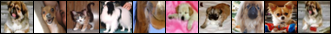

Train accuracy of deer = 50.88%
Hard negatives for deer


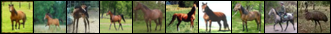

Train accuracy of dog = 50.28%
Hard negatives for dog


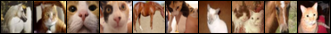

Train accuracy of frog = 88.14%
Hard negatives for frog


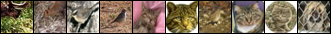

Train accuracy of horse = 62.90%
Hard negatives for horse


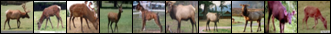

Train accuracy of ship = 91.92%
Hard negatives for ship


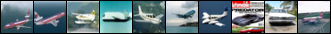

Train accuracy of truck = 85.46%
Hard negatives for truck


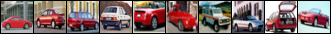


Test accuracy of the network: 67.98%
Test accuracy of plane = 67.30%
Hard negatives for plane


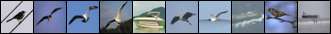

Test accuracy of car = 77.30%
Hard negatives for car


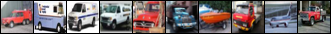

Test accuracy of bird = 58.90%
Hard negatives for bird


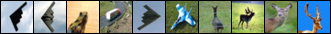

Test accuracy of cat = 61.70%
Hard negatives for cat


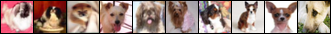

Test accuracy of deer = 46.40%
Hard negatives for deer


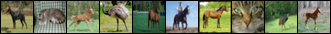

Test accuracy of dog = 49.50%
Hard negatives for dog


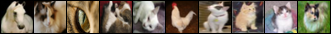

Test accuracy of frog = 87.20%
Hard negatives for frog


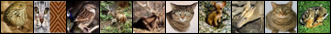

Test accuracy of horse = 58.70%
Hard negatives for horse


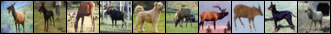

Test accuracy of ship = 89.00%
Hard negatives for ship


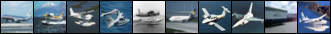

Test accuracy of truck = 83.80%
Hard negatives for truck


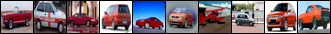

Batch Size 2048
Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 2.294



Epoch 1 summary -- loss = 2.275



Epoch 2 summary -- loss = 2.248



Epoch 3 summary -- loss = 2.208



Epoch 4 summary -- loss = 2.143



Epoch 5 summary -- loss = 2.052



Epoch 6 summary -- loss = 1.951



Epoch 7 summary -- loss = 1.856



Epoch 8 summary -- loss = 1.777



Epoch 9 summary -- loss = 1.711
Evaluating epoch 10



Train accuracy of the network: 38.62%
Train accuracy of plane = 48.28%
Hard negatives for plane


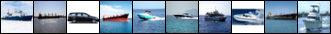

Train accuracy of car = 59.04%
Hard negatives for car


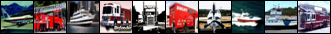

Train accuracy of bird = 9.40%
Hard negatives for bird


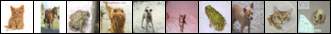

Train accuracy of cat = 12.60%
Hard negatives for cat


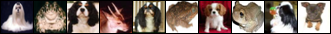

Train accuracy of deer = 45.40%
Hard negatives for deer


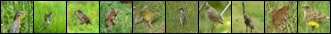

Train accuracy of dog = 31.88%
Hard negatives for dog


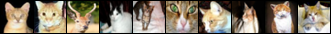

Train accuracy of frog = 45.30%
Hard negatives for frog


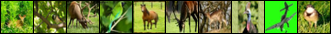

Train accuracy of horse = 41.30%
Hard negatives for horse


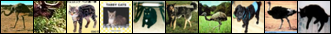

Train accuracy of ship = 52.52%
Hard negatives for ship


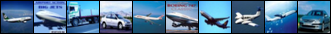

Train accuracy of truck = 39.84%
Hard negatives for truck


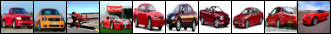


Test accuracy of the network: 39.29%
Test accuracy of plane = 48.00%
Hard negatives for plane


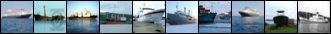

Test accuracy of car = 59.40%
Hard negatives for car


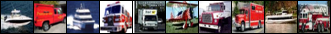

Test accuracy of bird = 9.80%
Hard negatives for bird


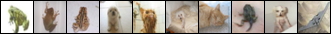

Test accuracy of cat = 13.50%
Hard negatives for cat


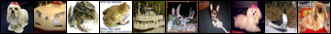

Test accuracy of deer = 46.90%
Hard negatives for deer


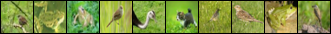

Test accuracy of dog = 32.40%
Hard negatives for dog


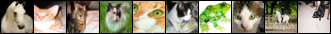

Test accuracy of frog = 47.50%
Hard negatives for frog


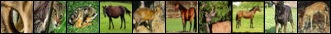

Test accuracy of horse = 44.70%
Hard negatives for horse


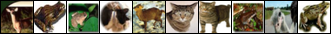

Test accuracy of ship = 51.70%
Hard negatives for ship


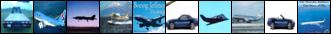

Test accuracy of truck = 39.00%
Hard negatives for truck


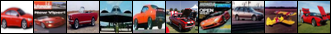


Epoch 10 summary -- loss = 1.661



Epoch 11 summary -- loss = 1.624



Epoch 12 summary -- loss = 1.582



Epoch 13 summary -- loss = 1.553



Epoch 14 summary -- loss = 1.523



Epoch 15 summary -- loss = 1.490



Epoch 16 summary -- loss = 1.469



Epoch 17 summary -- loss = 1.443



Epoch 18 summary -- loss = 1.417



Epoch 19 summary -- loss = 1.393
Evaluating epoch 20



Train accuracy of the network: 48.57%
Train accuracy of plane = 60.94%
Hard negatives for plane


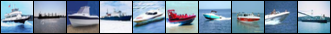

Train accuracy of car = 67.28%
Hard negatives for car


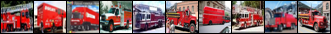

Train accuracy of bird = 26.42%
Hard negatives for bird


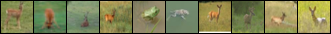

Train accuracy of cat = 15.18%
Hard negatives for cat


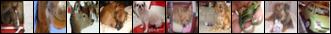

Train accuracy of deer = 33.98%
Hard negatives for deer


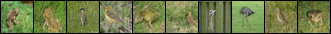

Train accuracy of dog = 48.84%
Hard negatives for dog


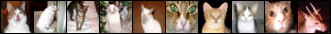

Train accuracy of frog = 57.52%
Hard negatives for frog


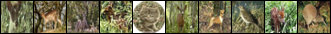

Train accuracy of horse = 59.48%
Hard negatives for horse


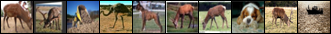

Train accuracy of ship = 56.06%
Hard negatives for ship


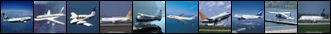

Train accuracy of truck = 59.22%
Hard negatives for truck


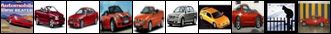


Test accuracy of the network: 47.84%
Test accuracy of plane = 59.90%
Hard negatives for plane


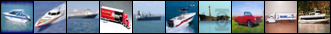

Test accuracy of car = 66.50%
Hard negatives for car


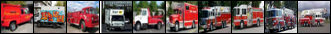

Test accuracy of bird = 23.50%
Hard negatives for bird


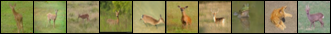

Test accuracy of cat = 14.00%
Hard negatives for cat


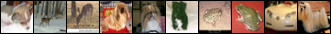

Test accuracy of deer = 34.20%
Hard negatives for deer


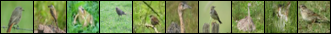

Test accuracy of dog = 47.10%
Hard negatives for dog


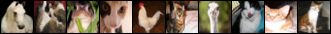

Test accuracy of frog = 60.50%
Hard negatives for frog


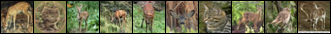

Test accuracy of horse = 61.40%
Hard negatives for horse


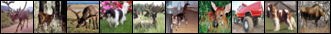

Test accuracy of ship = 54.30%
Hard negatives for ship


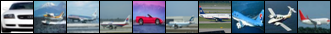

Test accuracy of truck = 57.00%
Hard negatives for truck


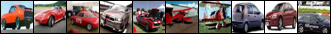


Epoch 20 summary -- loss = 1.387



Epoch 21 summary -- loss = 1.371



Epoch 22 summary -- loss = 1.347



Epoch 23 summary -- loss = 1.325



Epoch 24 summary -- loss = 1.319



Epoch 25 summary -- loss = 1.295



Epoch 26 summary -- loss = 1.278



Epoch 27 summary -- loss = 1.275



Epoch 28 summary -- loss = 1.234



Epoch 29 summary -- loss = 1.226
Evaluating epoch 30



Train accuracy of the network: 54.92%
Train accuracy of plane = 61.80%
Hard negatives for plane


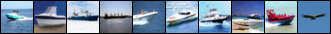

Train accuracy of car = 83.42%
Hard negatives for car


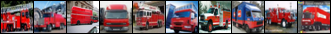

Train accuracy of bird = 35.46%
Hard negatives for bird


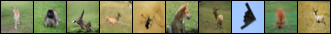

Train accuracy of cat = 31.84%
Hard negatives for cat


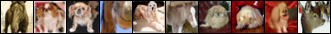

Train accuracy of deer = 44.82%
Hard negatives for deer


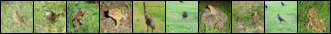

Train accuracy of dog = 48.82%
Hard negatives for dog


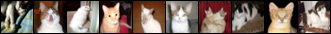

Train accuracy of frog = 71.06%
Hard negatives for frog


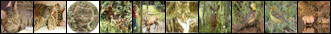

Train accuracy of horse = 61.44%
Hard negatives for horse


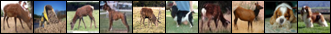

Train accuracy of ship = 68.46%
Hard negatives for ship


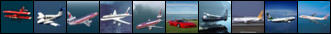

Train accuracy of truck = 42.66%
Hard negatives for truck


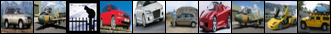


Test accuracy of the network: 54.54%
Test accuracy of plane = 60.70%
Hard negatives for plane


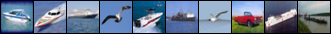

Test accuracy of car = 83.50%
Hard negatives for car


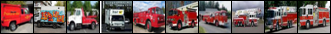

Test accuracy of bird = 31.20%
Hard negatives for bird


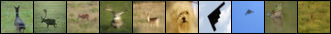

Test accuracy of cat = 31.20%
Hard negatives for cat


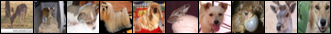

Test accuracy of deer = 44.70%
Hard negatives for deer


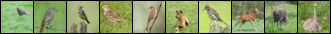

Test accuracy of dog = 49.00%
Hard negatives for dog


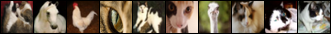

Test accuracy of frog = 72.60%
Hard negatives for frog


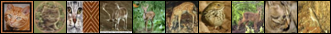

Test accuracy of horse = 62.70%
Hard negatives for horse


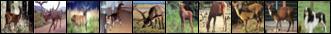

Test accuracy of ship = 66.20%
Hard negatives for ship


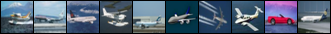

Test accuracy of truck = 43.60%
Hard negatives for truck


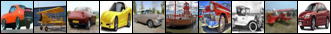

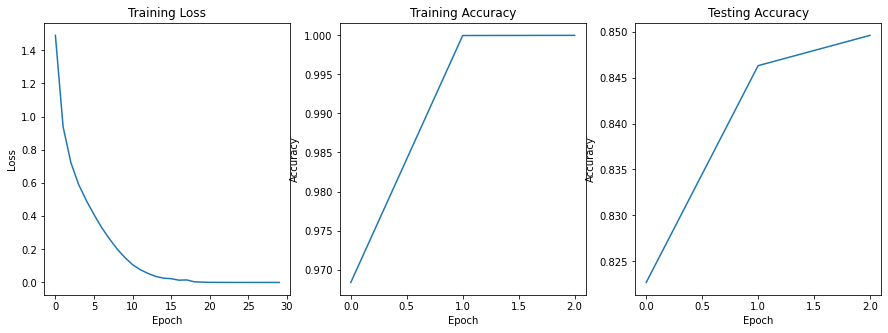

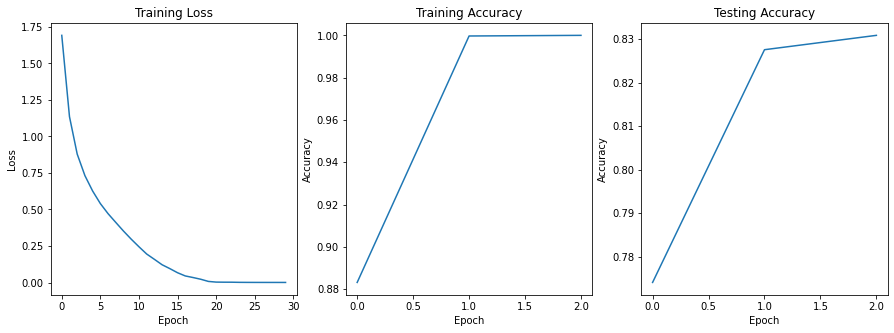

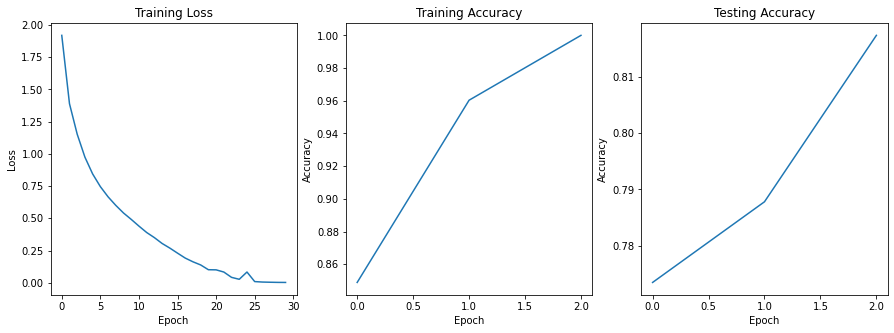

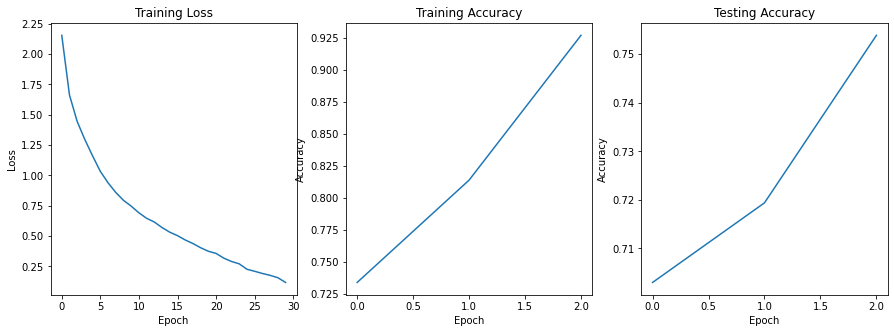

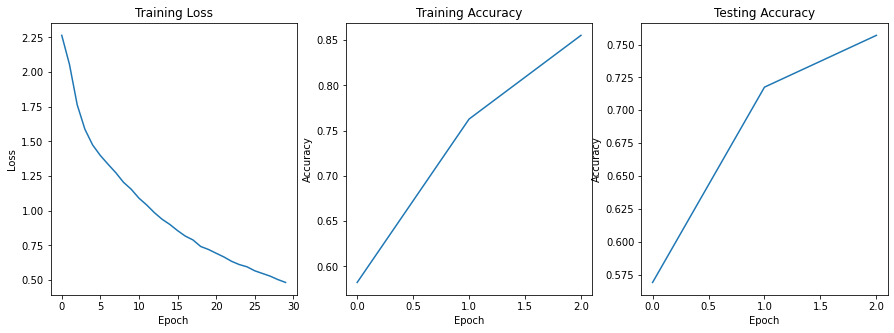

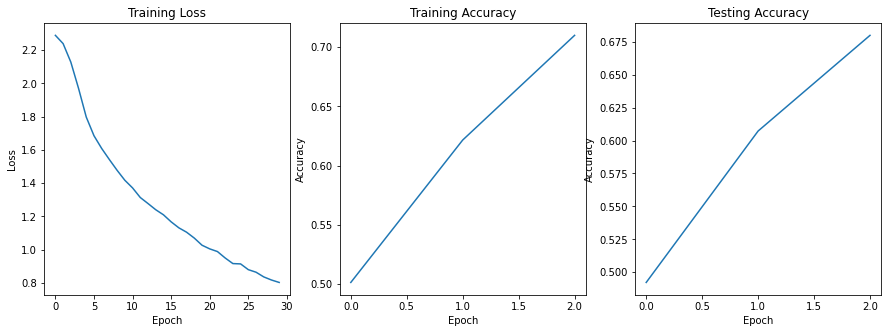

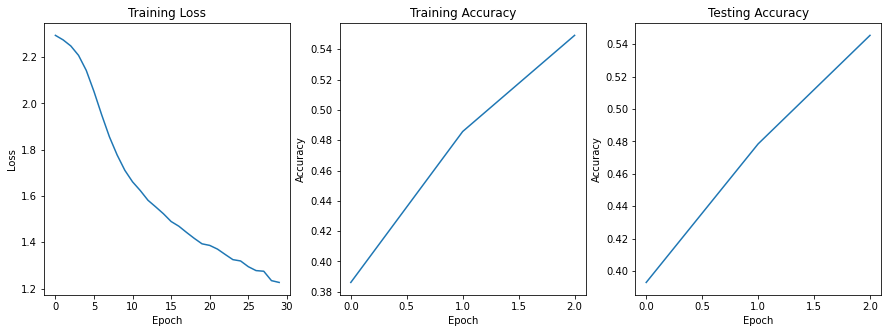

In [0]:
# TODO: Your code here
batch_sizes = [32, 64, 128, 256, 512, 1024, 2048]

for batch_size in batch_sizes:
  net = CoolNet()
  print(f"Batch Size {batch_size}")
  train_losses, train_accuracies, test_accuracies = train_network(
      net, 
      criterion=nn.CrossEntropyLoss(),
      lr=0.01, 
      epochs=30, 
      batch_size=batch_size)
  plot_results(train_losses, train_accuracies, test_accuracies)

I tried 7 different batch sizes in [32, 64, 128, 256, 512, 1024, 2048]. In case of small batch sizes such as 32 and 64, the training loss saturates after 15 epochs and training accuracy becomes 1, which indicates that the network gets over-fitted to the training data leading to relatively poor performance on the test data (test accuracy around 83%). This is because the model starts learning the noise in the training data, instead of learning the underlying pattern. In addition, the training process is slow.

When using optimal batch size such as 128, we see that the training loss saturates to 0 towards the end of training epochs, as well as the training accuracy slowly improves over time with final test accuracy of 82%. This is because the network makes the optimal number of weight updates and eventually converges to the minima, instead of getting stuck at some false minimizers when using large batch sizes.

As the batch size is increased from 256 to 512, and to 1024, we see that the test accuracy starts falling and reaches 55% with batch size of 2048. This is because the network makes less parameter updates and may not be able to reach the optimal solution.

Thus, by choosing the optimal batch size, one can save on training iterations and learn a model that generalizes well on test dataset.

### 2.3.2. How does learning rate work?

When you are trying to train a neural network it is really hard to choose a proper learning rate. 

Try to train your model with different learning rates and plot the training accuracy, test accuracy and loss and compare the training progress for learning rates = 10, 0.1, 0.01, 0.0001.

Analyze the results and choose the best one. Why did you choose this value?



Learning Rate: 10
Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = nan



Epoch 1 summary -- loss = nan



Epoch 2 summary -- loss = nan



Epoch 3 summary -- loss = nan



Epoch 4 summary -- loss = nan



Epoch 5 summary -- loss = nan



Epoch 6 summary -- loss = nan



Epoch 7 summary -- loss = nan



Epoch 8 summary -- loss = nan



Epoch 9 summary -- loss = nan
Evaluating epoch 10



Train accuracy of the network: 10.00%
Train accuracy of plane = 100.00%
Hard negatives for plane


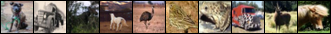

Train accuracy of car = 0.00%
No hard negatives for class: car
Train accuracy of bird = 0.00%
No hard negatives for class: bird
Train accuracy of cat = 0.00%
No hard negatives for class: cat
Train accuracy of deer = 0.00%
No hard negatives for class: deer
Train accuracy of dog = 0.00%
No hard negatives for class: dog
Train accuracy of frog = 0.00%
No hard negatives for class: frog
Train accuracy of horse = 0.00%
No hard negatives for class: horse
Train accuracy of ship = 0.00%
No hard negatives for class: ship
Train accuracy of truck = 0.00%
No hard negatives for class: truck



Test accuracy of the network: 10.00%
Test accuracy of plane = 100.00%
Hard negatives for plane


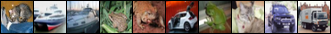

Test accuracy of car = 0.00%
No hard negatives for class: car
Test accuracy of bird = 0.00%
No hard negatives for class: bird
Test accuracy of cat = 0.00%
No hard negatives for class: cat
Test accuracy of deer = 0.00%
No hard negatives for class: deer
Test accuracy of dog = 0.00%
No hard negatives for class: dog
Test accuracy of frog = 0.00%
No hard negatives for class: frog
Test accuracy of horse = 0.00%
No hard negatives for class: horse
Test accuracy of ship = 0.00%
No hard negatives for class: ship
Test accuracy of truck = 0.00%
No hard negatives for class: truck



Epoch 10 summary -- loss = nan



Epoch 11 summary -- loss = nan



Epoch 12 summary -- loss = nan



Epoch 13 summary -- loss = nan



Epoch 14 summary -- loss = nan



Epoch 15 summary -- loss = nan



Epoch 16 summary -- loss = nan



Epoch 17 summary -- loss = nan



Epoch 18 summary -- loss = nan



Epoch 19 summary -- loss = nan
Evaluating epoch 20



Train accuracy of the network: 10.00%
Train accuracy of plane = 100.00%
Hard negatives for plane


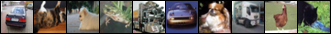

Train accuracy of car = 0.00%
No hard negatives for class: car
Train accuracy of bird = 0.00%
No hard negatives for class: bird
Train accuracy of cat = 0.00%
No hard negatives for class: cat
Train accuracy of deer = 0.00%
No hard negatives for class: deer
Train accuracy of dog = 0.00%
No hard negatives for class: dog
Train accuracy of frog = 0.00%
No hard negatives for class: frog
Train accuracy of horse = 0.00%
No hard negatives for class: horse
Train accuracy of ship = 0.00%
No hard negatives for class: ship
Train accuracy of truck = 0.00%
No hard negatives for class: truck



Test accuracy of the network: 10.00%
Test accuracy of plane = 100.00%
Hard negatives for plane


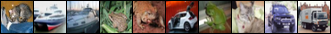

Test accuracy of car = 0.00%
No hard negatives for class: car
Test accuracy of bird = 0.00%
No hard negatives for class: bird
Test accuracy of cat = 0.00%
No hard negatives for class: cat
Test accuracy of deer = 0.00%
No hard negatives for class: deer
Test accuracy of dog = 0.00%
No hard negatives for class: dog
Test accuracy of frog = 0.00%
No hard negatives for class: frog
Test accuracy of horse = 0.00%
No hard negatives for class: horse
Test accuracy of ship = 0.00%
No hard negatives for class: ship
Test accuracy of truck = 0.00%
No hard negatives for class: truck



Epoch 20 summary -- loss = nan



Epoch 21 summary -- loss = nan



Epoch 22 summary -- loss = nan



Epoch 23 summary -- loss = nan



Epoch 24 summary -- loss = nan



Epoch 25 summary -- loss = nan



Epoch 26 summary -- loss = nan



Epoch 27 summary -- loss = nan



Epoch 28 summary -- loss = nan



Epoch 29 summary -- loss = nan
Evaluating epoch 30



Train accuracy of the network: 10.00%
Train accuracy of plane = 100.00%
Hard negatives for plane


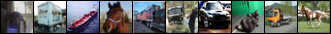

Train accuracy of car = 0.00%
No hard negatives for class: car
Train accuracy of bird = 0.00%
No hard negatives for class: bird
Train accuracy of cat = 0.00%
No hard negatives for class: cat
Train accuracy of deer = 0.00%
No hard negatives for class: deer
Train accuracy of dog = 0.00%
No hard negatives for class: dog
Train accuracy of frog = 0.00%
No hard negatives for class: frog
Train accuracy of horse = 0.00%
No hard negatives for class: horse
Train accuracy of ship = 0.00%
No hard negatives for class: ship
Train accuracy of truck = 0.00%
No hard negatives for class: truck



Test accuracy of the network: 10.00%
Test accuracy of plane = 100.00%
Hard negatives for plane


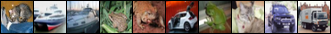

Test accuracy of car = 0.00%
No hard negatives for class: car
Test accuracy of bird = 0.00%
No hard negatives for class: bird
Test accuracy of cat = 0.00%
No hard negatives for class: cat
Test accuracy of deer = 0.00%
No hard negatives for class: deer
Test accuracy of dog = 0.00%
No hard negatives for class: dog
Test accuracy of frog = 0.00%
No hard negatives for class: frog
Test accuracy of horse = 0.00%
No hard negatives for class: horse
Test accuracy of ship = 0.00%
No hard negatives for class: ship
Test accuracy of truck = 0.00%
No hard negatives for class: truck
Learning Rate: 0.1
Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 1.489



Epoch 1 summary -- loss = 0.935



Epoch 2 summary -- loss = 0.694



Epoch 3 summary -- loss = 0.541



Epoch 4 summary -- loss = 0.432



Epoch 5 summary -- loss = 0.339



Epoch 6 summary -- loss = 0.255



Epoch 7 summary -- loss = 0.187



Epoch 8 summary -- loss = 0.125



Epoch 9 summary -- loss = 0.082
Evaluating epoch 10



Train accuracy of the network: 95.09%
Train accuracy of plane = 98.14%
Hard negatives for plane


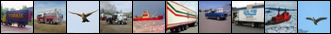

Train accuracy of car = 98.74%
Hard negatives for car


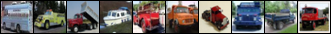

Train accuracy of bird = 96.20%
Hard negatives for bird


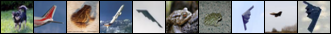

Train accuracy of cat = 86.46%
Hard negatives for cat


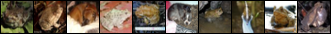

Train accuracy of deer = 99.92%
Hard negatives for deer


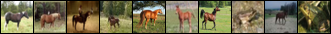

Train accuracy of dog = 97.44%
Hard negatives for dog


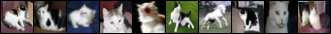

Train accuracy of frog = 83.58%
Hard negatives for frog


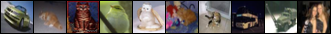

Train accuracy of horse = 97.88%
Hard negatives for horse


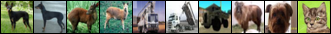

Train accuracy of ship = 98.70%
Hard negatives for ship


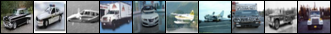

Train accuracy of truck = 93.68%
Hard negatives for truck


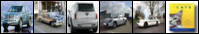


Test accuracy of the network: 81.07%
Test accuracy of plane = 88.60%
Hard negatives for plane


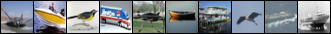

Test accuracy of car = 90.90%
Hard negatives for car


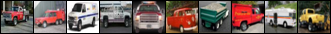

Test accuracy of bird = 74.80%
Hard negatives for bird


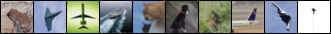

Test accuracy of cat = 53.80%
Hard negatives for cat


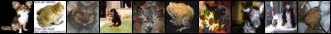

Test accuracy of deer = 93.60%
Hard negatives for deer


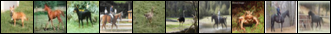

Test accuracy of dog = 80.80%
Hard negatives for dog


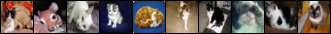

Test accuracy of frog = 69.90%
Hard negatives for frog


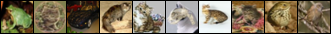

Test accuracy of horse = 85.50%
Hard negatives for horse


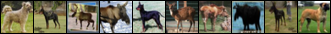

Test accuracy of ship = 89.30%
Hard negatives for ship


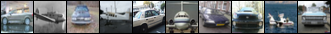

Test accuracy of truck = 83.50%
Hard negatives for truck


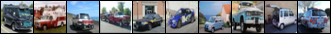


Epoch 10 summary -- loss = 0.064



Epoch 11 summary -- loss = 0.043



Epoch 12 summary -- loss = 0.032



Epoch 13 summary -- loss = 0.024



Epoch 14 summary -- loss = 0.007



Epoch 15 summary -- loss = 0.021



Epoch 16 summary -- loss = 0.001



Epoch 17 summary -- loss = 0.000



Epoch 18 summary -- loss = 0.000



Epoch 19 summary -- loss = 0.000
Evaluating epoch 20



Train accuracy of the network: 100.00%
Train accuracy of plane = 100.00%
No hard negatives for class: plane
Train accuracy of car = 100.00%
No hard negatives for class: car
Train accuracy of bird = 100.00%
No hard negatives for class: bird
Train accuracy of cat = 100.00%
No hard negatives for class: cat
Train accuracy of deer = 100.00%
No hard negatives for class: deer
Train accuracy of dog = 100.00%
No hard negatives for class: dog
Train accuracy of frog = 100.00%
No hard negatives for class: frog
Train accuracy of horse = 100.00%
No hard negatives for class: horse
Train accuracy of ship = 100.00%
No hard negatives for class: ship
Train accuracy of truck = 100.00%
No hard negatives for class: truck



Test accuracy of the network: 85.92%
Test accuracy of plane = 88.60%
Hard negatives for plane


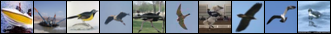

Test accuracy of car = 93.10%
Hard negatives for car


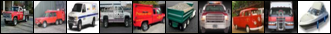

Test accuracy of bird = 77.70%
Hard negatives for bird


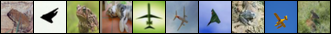

Test accuracy of cat = 72.40%
Hard negatives for cat


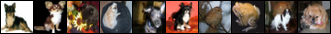

Test accuracy of deer = 85.70%
Hard negatives for deer


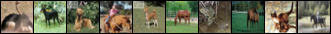

Test accuracy of dog = 79.10%
Hard negatives for dog


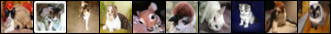

Test accuracy of frog = 91.00%
Hard negatives for frog


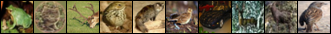

Test accuracy of horse = 88.70%
Hard negatives for horse


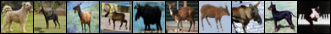

Test accuracy of ship = 91.50%
Hard negatives for ship


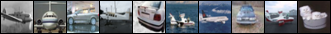

Test accuracy of truck = 91.40%
Hard negatives for truck


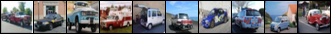


Epoch 20 summary -- loss = 0.000



Epoch 21 summary -- loss = 0.000



Epoch 22 summary -- loss = 0.000



Epoch 23 summary -- loss = 0.000



Epoch 24 summary -- loss = 0.000



Epoch 25 summary -- loss = 0.000



Epoch 26 summary -- loss = 0.000



Epoch 27 summary -- loss = 0.000



Epoch 28 summary -- loss = 0.000



Epoch 29 summary -- loss = 0.000
Evaluating epoch 30



Train accuracy of the network: 100.00%
Train accuracy of plane = 100.00%
No hard negatives for class: plane
Train accuracy of car = 100.00%
No hard negatives for class: car
Train accuracy of bird = 100.00%
No hard negatives for class: bird
Train accuracy of cat = 100.00%
No hard negatives for class: cat
Train accuracy of deer = 100.00%
No hard negatives for class: deer
Train accuracy of dog = 100.00%
No hard negatives for class: dog
Train accuracy of frog = 100.00%
No hard negatives for class: frog
Train accuracy of horse = 100.00%
No hard negatives for class: horse
Train accuracy of ship = 100.00%
No hard negatives for class: ship
Train accuracy of truck = 100.00%
No hard negatives for class: truck



Test accuracy of the network: 85.98%
Test accuracy of plane = 88.80%
Hard negatives for plane


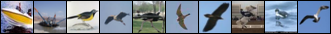

Test accuracy of car = 93.00%
Hard negatives for car


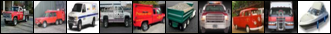

Test accuracy of bird = 77.70%
Hard negatives for bird


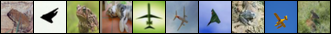

Test accuracy of cat = 72.80%
Hard negatives for cat


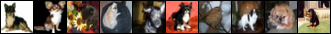

Test accuracy of deer = 85.40%
Hard negatives for deer


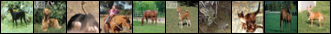

Test accuracy of dog = 79.10%
Hard negatives for dog


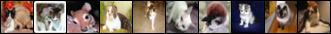

Test accuracy of frog = 91.00%
Hard negatives for frog


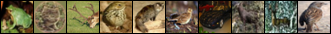

Test accuracy of horse = 88.80%
Hard negatives for horse


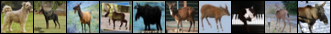

Test accuracy of ship = 91.70%
Hard negatives for ship


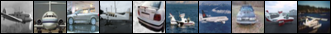

Test accuracy of truck = 91.50%
Hard negatives for truck


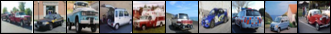

Learning Rate: 0.01
Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 1.941



Epoch 1 summary -- loss = 1.407



Epoch 2 summary -- loss = 1.156



Epoch 3 summary -- loss = 0.969



Epoch 4 summary -- loss = 0.842



Epoch 5 summary -- loss = 0.743



Epoch 6 summary -- loss = 0.668



Epoch 7 summary -- loss = 0.597



Epoch 8 summary -- loss = 0.537



Epoch 9 summary -- loss = 0.483
Evaluating epoch 10



Train accuracy of the network: 84.54%
Train accuracy of plane = 87.04%
Hard negatives for plane


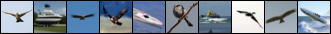

Train accuracy of car = 86.06%
Hard negatives for car


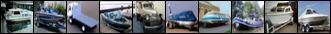

Train accuracy of bird = 80.00%
Hard negatives for bird


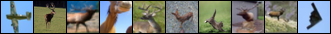

Train accuracy of cat = 71.74%
Hard negatives for cat


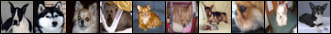

Train accuracy of deer = 77.58%
Hard negatives for deer


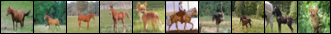

Train accuracy of dog = 72.88%
Hard negatives for dog


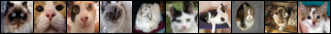

Train accuracy of frog = 91.48%
Hard negatives for frog


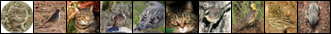

Train accuracy of horse = 90.60%
Hard negatives for horse


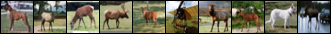

Train accuracy of ship = 89.26%
Hard negatives for ship


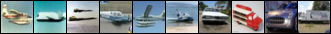

Train accuracy of truck = 98.62%
Hard negatives for truck


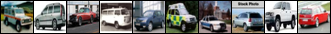


Test accuracy of the network: 77.24%
Test accuracy of plane = 80.70%
Hard negatives for plane


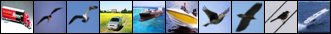

Test accuracy of car = 79.20%
Hard negatives for car


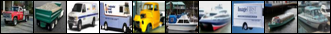

Test accuracy of bird = 69.90%
Hard negatives for bird


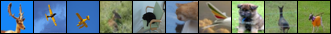

Test accuracy of cat = 60.30%
Hard negatives for cat


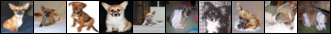

Test accuracy of deer = 69.40%
Hard negatives for deer


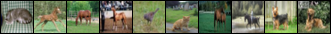

Test accuracy of dog = 66.30%
Hard negatives for dog


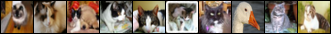

Test accuracy of frog = 86.80%
Hard negatives for frog


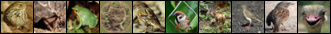

Test accuracy of horse = 83.30%
Hard negatives for horse


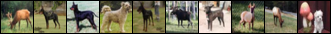

Test accuracy of ship = 82.70%
Hard negatives for ship


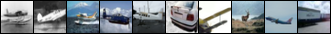

Test accuracy of truck = 93.80%
Hard negatives for truck


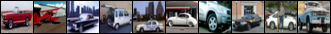


Epoch 10 summary -- loss = 0.432



Epoch 11 summary -- loss = 0.388



Epoch 12 summary -- loss = 0.347



Epoch 13 summary -- loss = 0.299



Epoch 14 summary -- loss = 0.264



Epoch 15 summary -- loss = 0.223



Epoch 16 summary -- loss = 0.184



Epoch 17 summary -- loss = 0.160



Epoch 18 summary -- loss = 0.127



Epoch 19 summary -- loss = 0.116
Evaluating epoch 20



Train accuracy of the network: 93.05%
Train accuracy of plane = 95.38%
Hard negatives for plane


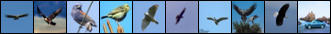

Train accuracy of car = 80.96%
Hard negatives for car


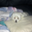

Train accuracy of bird = 92.06%
Hard negatives for bird


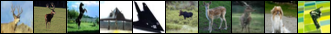

Train accuracy of cat = 97.62%
Hard negatives for cat


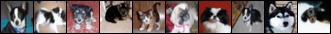

Train accuracy of deer = 89.66%
Hard negatives for deer


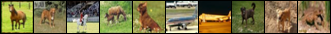

Train accuracy of dog = 82.46%
Hard negatives for dog


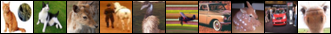

Train accuracy of frog = 98.42%
Hard negatives for frog


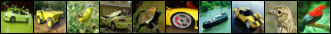

Train accuracy of horse = 99.10%
Hard negatives for horse


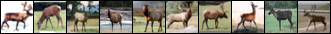

Train accuracy of ship = 95.72%
Hard negatives for ship


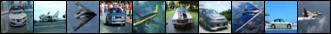

Train accuracy of truck = 99.56%
Hard negatives for truck


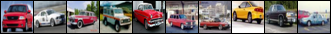


Test accuracy of the network: 76.54%
Test accuracy of plane = 79.40%
Hard negatives for plane


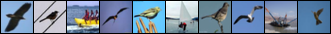

Test accuracy of car = 72.60%
Hard negatives for car


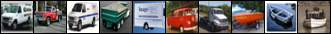

Test accuracy of bird = 63.70%
Hard negatives for bird


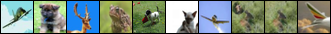

Test accuracy of cat = 76.30%
Hard negatives for cat


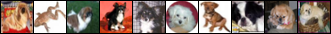

Test accuracy of deer = 66.90%
Hard negatives for deer


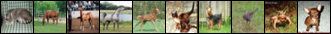

Test accuracy of dog = 57.30%
Hard negatives for dog


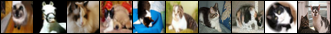

Test accuracy of frog = 86.50%
Hard negatives for frog


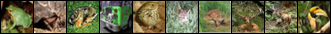

Test accuracy of horse = 87.10%
Hard negatives for horse


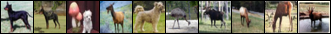

Test accuracy of ship = 83.40%
Hard negatives for ship


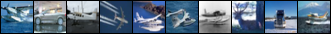

Test accuracy of truck = 92.20%
Hard negatives for truck


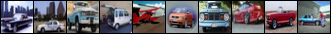


Epoch 20 summary -- loss = 0.078



Epoch 21 summary -- loss = 0.065



Epoch 22 summary -- loss = 0.049



Epoch 23 summary -- loss = 0.032



Epoch 24 summary -- loss = 0.014



Epoch 25 summary -- loss = 0.006



Epoch 26 summary -- loss = 0.004



Epoch 27 summary -- loss = 0.003



Epoch 28 summary -- loss = 0.002



Epoch 29 summary -- loss = 0.002
Evaluating epoch 30



Train accuracy of the network: 100.00%
Train accuracy of plane = 100.00%
No hard negatives for class: plane
Train accuracy of car = 100.00%
No hard negatives for class: car
Train accuracy of bird = 100.00%
No hard negatives for class: bird
Train accuracy of cat = 100.00%
No hard negatives for class: cat
Train accuracy of deer = 100.00%
No hard negatives for class: deer
Train accuracy of dog = 100.00%
No hard negatives for class: dog
Train accuracy of frog = 100.00%
No hard negatives for class: frog
Train accuracy of horse = 100.00%
No hard negatives for class: horse
Train accuracy of ship = 100.00%
No hard negatives for class: ship
Train accuracy of truck = 100.00%
No hard negatives for class: truck



Test accuracy of the network: 81.42%
Test accuracy of plane = 84.10%
Hard negatives for plane


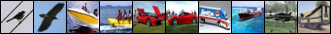

Test accuracy of car = 90.80%
Hard negatives for car


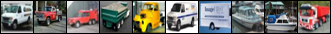

Test accuracy of bird = 74.20%
Hard negatives for bird


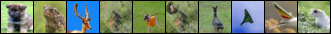

Test accuracy of cat = 67.60%
Hard negatives for cat


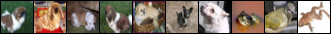

Test accuracy of deer = 79.70%
Hard negatives for deer


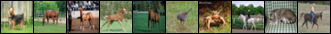

Test accuracy of dog = 74.10%
Hard negatives for dog


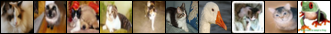

Test accuracy of frog = 83.30%
Hard negatives for frog


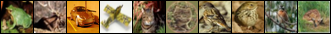

Test accuracy of horse = 84.40%
Hard negatives for horse


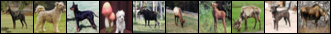

Test accuracy of ship = 87.80%
Hard negatives for ship


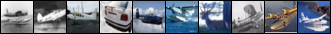

Test accuracy of truck = 88.20%
Hard negatives for truck


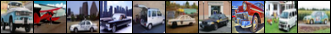

Learning Rate: 0.0001
Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 2.304



Epoch 1 summary -- loss = 2.301



Epoch 2 summary -- loss = 2.299



Epoch 3 summary -- loss = 2.296



Epoch 4 summary -- loss = 2.293



Epoch 5 summary -- loss = 2.291



Epoch 6 summary -- loss = 2.288



Epoch 7 summary -- loss = 2.285



Epoch 8 summary -- loss = 2.282



Epoch 9 summary -- loss = 2.279
Evaluating epoch 10



Train accuracy of the network: 15.70%
Train accuracy of plane = 4.96%
Hard negatives for plane


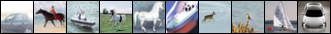

Train accuracy of car = 36.80%
Hard negatives for car


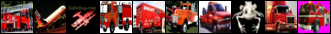

Train accuracy of bird = 0.00%
No hard negatives for class: bird
Train accuracy of cat = 3.30%
Hard negatives for cat


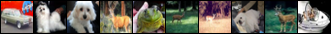

Train accuracy of deer = 0.00%
No hard negatives for class: deer
Train accuracy of dog = 0.60%
Hard negatives for dog


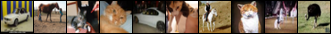

Train accuracy of frog = 36.48%
Hard negatives for frog


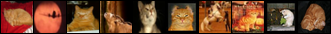

Train accuracy of horse = 0.30%
Hard negatives for horse


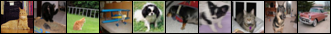

Train accuracy of ship = 4.90%
Hard negatives for ship


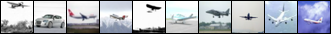

Train accuracy of truck = 70.80%
Hard negatives for truck


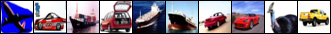


Test accuracy of the network: 15.87%
Test accuracy of plane = 4.90%
Hard negatives for plane


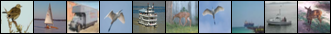

Test accuracy of car = 37.40%
Hard negatives for car


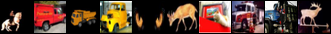

Test accuracy of bird = 0.00%
No hard negatives for class: bird
Test accuracy of cat = 4.00%
Hard negatives for cat


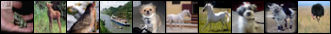

Test accuracy of deer = 0.00%
No hard negatives for class: deer
Test accuracy of dog = 0.30%
Hard negatives for dog


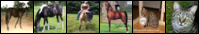

Test accuracy of frog = 36.50%
Hard negatives for frog


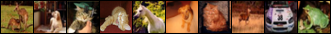

Test accuracy of horse = 0.40%
Hard negatives for horse


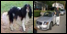

Test accuracy of ship = 4.50%
Hard negatives for ship


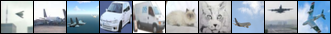

Test accuracy of truck = 70.70%
Hard negatives for truck


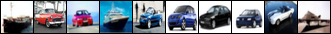


Epoch 10 summary -- loss = 2.276



Epoch 11 summary -- loss = 2.272



Epoch 12 summary -- loss = 2.268



Epoch 13 summary -- loss = 2.264



Epoch 14 summary -- loss = 2.260



Epoch 15 summary -- loss = 2.255



Epoch 16 summary -- loss = 2.250



Epoch 17 summary -- loss = 2.245



Epoch 18 summary -- loss = 2.239



Epoch 19 summary -- loss = 2.232
Evaluating epoch 20



Train accuracy of the network: 23.33%
Train accuracy of plane = 8.20%
Hard negatives for plane


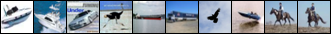

Train accuracy of car = 41.46%
Hard negatives for car


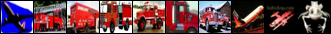

Train accuracy of bird = 0.00%
No hard negatives for class: bird
Train accuracy of cat = 12.22%
Hard negatives for cat


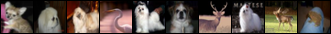

Train accuracy of deer = 0.34%
Hard negatives for deer


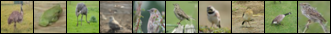

Train accuracy of dog = 6.88%
Hard negatives for dog


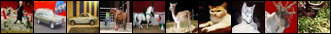

Train accuracy of frog = 47.58%
Hard negatives for frog


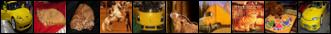

Train accuracy of horse = 8.32%
Hard negatives for horse


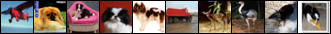

Train accuracy of ship = 46.30%
Hard negatives for ship


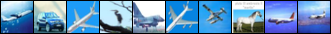

Train accuracy of truck = 62.48%
Hard negatives for truck


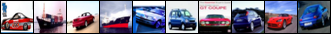


Test accuracy of the network: 23.61%
Test accuracy of plane = 8.90%
Hard negatives for plane


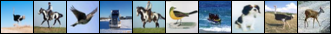

Test accuracy of car = 41.40%
Hard negatives for car


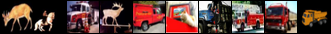

Test accuracy of bird = 0.00%
No hard negatives for class: bird
Test accuracy of cat = 13.40%
Hard negatives for cat


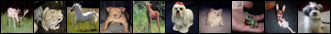

Test accuracy of deer = 0.30%
Hard negatives for deer


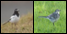

Test accuracy of dog = 7.20%
Hard negatives for dog


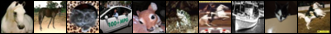

Test accuracy of frog = 48.20%
Hard negatives for frog


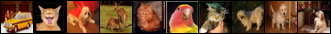

Test accuracy of horse = 10.40%
Hard negatives for horse


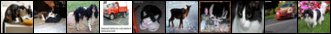

Test accuracy of ship = 43.10%
Hard negatives for ship


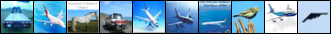

Test accuracy of truck = 63.20%
Hard negatives for truck


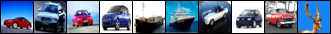


Epoch 20 summary -- loss = 2.225



Epoch 21 summary -- loss = 2.217



Epoch 22 summary -- loss = 2.208



Epoch 23 summary -- loss = 2.198



Epoch 24 summary -- loss = 2.188



Epoch 25 summary -- loss = 2.176



Epoch 26 summary -- loss = 2.164



Epoch 27 summary -- loss = 2.151



Epoch 28 summary -- loss = 2.138



Epoch 29 summary -- loss = 2.123
Evaluating epoch 30



Train accuracy of the network: 28.28%
Train accuracy of plane = 17.48%
Hard negatives for plane


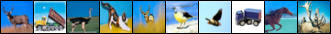

Train accuracy of car = 37.86%
Hard negatives for car


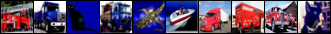

Train accuracy of bird = 0.80%
Hard negatives for bird


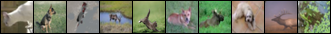

Train accuracy of cat = 17.36%
Hard negatives for cat


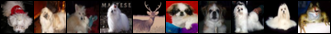

Train accuracy of deer = 1.66%
Hard negatives for deer


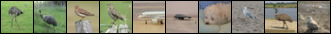

Train accuracy of dog = 11.46%
Hard negatives for dog


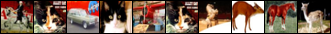

Train accuracy of frog = 64.96%
Hard negatives for frog


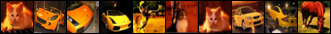

Train accuracy of horse = 18.06%
Hard negatives for horse


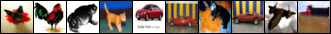

Train accuracy of ship = 65.34%
Hard negatives for ship


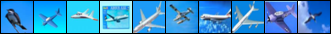

Train accuracy of truck = 46.84%
Hard negatives for truck


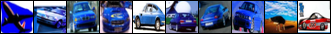


Test accuracy of the network: 28.53%
Test accuracy of plane = 17.30%
Hard negatives for plane


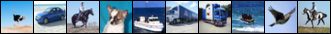

Test accuracy of car = 38.30%
Hard negatives for car


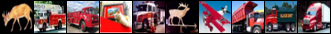

Test accuracy of bird = 0.20%
Hard negatives for bird


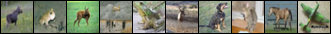

Test accuracy of cat = 17.40%
Hard negatives for cat


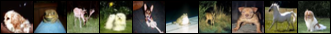

Test accuracy of deer = 1.50%
Hard negatives for deer


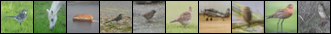

Test accuracy of dog = 10.80%
Hard negatives for dog


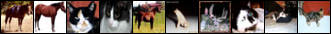

Test accuracy of frog = 68.70%
Hard negatives for frog


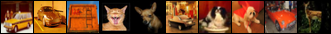

Test accuracy of horse = 21.60%
Hard negatives for horse


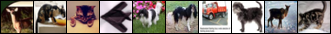

Test accuracy of ship = 62.20%
Hard negatives for ship


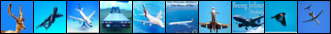

Test accuracy of truck = 47.30%
Hard negatives for truck


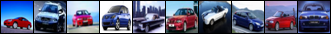

Plotting overall results to compare ....


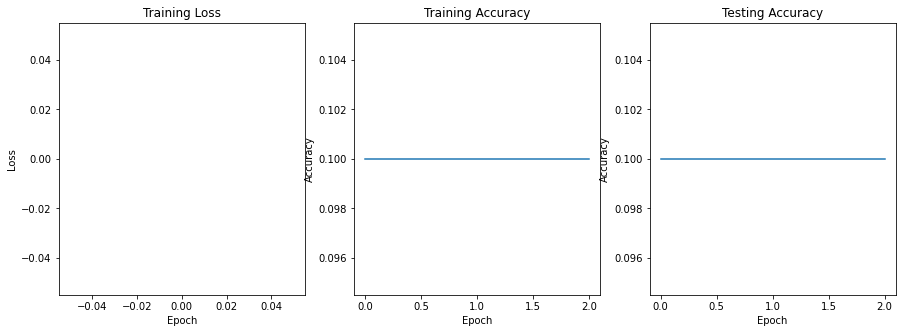

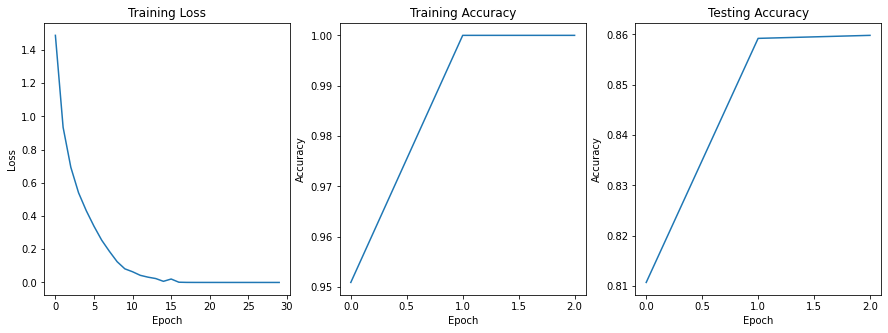

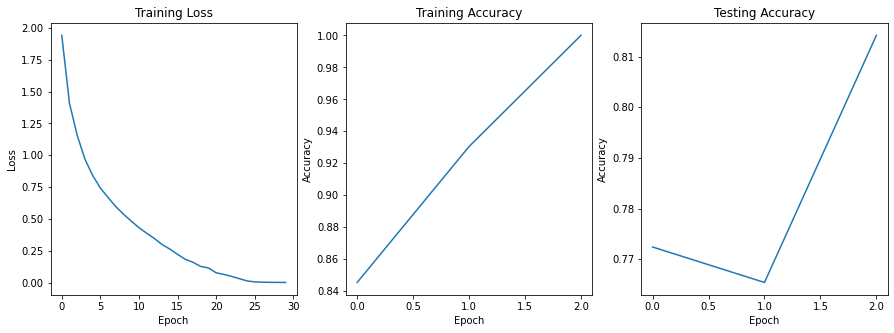

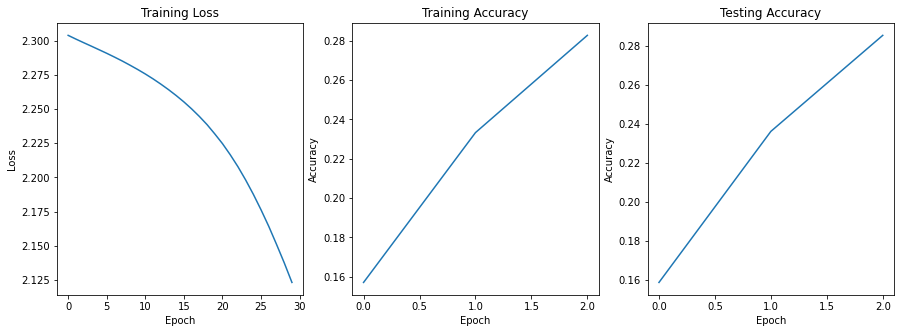

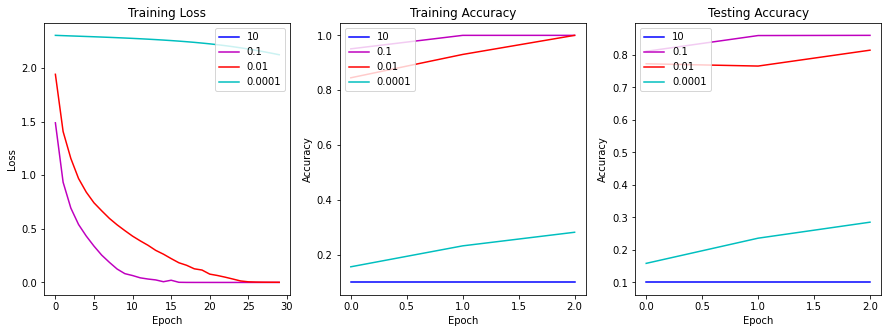

In [23]:
# TODO: Your code here
learning_rates = [10, 0.1, 0.01, 0.0001]
train_losses_dict = dict()
train_accuracies_dict = dict()
test_accuracies_dict = dict()


for lr in learning_rates:
  net = CoolNet()
  print(f"Learning Rate: {lr}")
  train_losses, train_accuracies, test_accuracies = train_network(
      net, 
      criterion=nn.CrossEntropyLoss(),
      lr=lr, 
      epochs=30, 
      batch_size=128)
  plot_results(train_losses, train_accuracies, test_accuracies)
  train_losses_dict[lr] = train_losses
  train_accuracies_dict[lr] = train_accuracies
  test_accuracies_dict[lr] = test_accuracies


print(f"Plotting overall results to compare ....")
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
colors = ['b', 'm', 'r', 'c', 'g', 'y']
for i,lr in enumerate(learning_rates):
    axes[0].plot(train_losses_dict[lr], color=colors[i], label=str(lr))
    axes[1].plot(train_accuracies_dict[lr], color=colors[i], label=str(lr))
    axes[2].plot(test_accuracies_dict[lr], color=colors[i], label=str(lr))
    
        
axes[0].set_title('Training Loss')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend(loc='upper right')

axes[1].set_title('Training Accuracy')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend(loc='upper left')
  
axes[2].set_title('Testing Accuracy')
axes[2].set_xlabel('Epoch')
axes[2].set_ylabel('Accuracy')
axes[2].legend(loc='upper left')
plt.show()


**Question**:
Analyze the results and choose one value to use. Why did you choose this value?

*TODO: Your answer here.*

For a high learning rate of 10.0, the model overshoots the local minima and keeps on oscillating with respect to different iterations, in general. And the model's test performance is 10%, which is nothing better than a random classifier.

For learning rate of 0.1, we see that the training cross entropy loss starts saturating near 20 epochs and the model seems to eventually converge. The test accuracy that we get is around 86%.

When using learning rate of 0.01, we see that it needs more epochs for the training loss to converge. The final test accuracy is 81%, that's why we choose the learning rate of 0.1 (better test accuracy).

For the smallest learning rate of 0.0001, the training seems to be very slow and it seems like the model would take 'forever' to converge.

### 2.3.3. Learning rate scheduling
During training it is often useful to reduce learning rate as the training progresses.

Fill in `set_learning_rate` below to scale the learning rate by 0.1 (reduce by 90%) every 30 epochs and observe the behavior of network for 90 epochs. 


In [0]:
def set_learning_rate(optimizer, epoch, base_lr):
    # TODO: adjust learning rate here
    # lr = ...
    if epoch == 0:
      lr = base_lr
      print(f"Initial Learning rate: {lr}")
    else:
      lr = base_lr * (0.1)**((epoch+1)//30)
      if (epoch+1)% 30 == 0:
        print (f"Learning rate updated to: {lr}")
    
    for param_group in optimizer.param_groups:
        param_group['lr'] = lr

Files already downloaded and verified
Files already downloaded and verified
Initial Learning rate: 0.1



Epoch 0 summary -- loss = 1.486



Epoch 1 summary -- loss = 0.939



Epoch 2 summary -- loss = 0.707



Epoch 3 summary -- loss = 0.555



Epoch 4 summary -- loss = 0.447



Epoch 5 summary -- loss = 0.348



Epoch 6 summary -- loss = 0.267



Epoch 7 summary -- loss = 0.193



Epoch 8 summary -- loss = 0.134



Epoch 9 summary -- loss = 0.090
Evaluating epoch 10



Train accuracy of the network: 95.69%
Train accuracy of plane = 84.50%
Hard negatives for plane


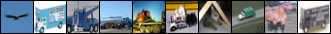

Train accuracy of car = 99.12%
Hard negatives for car


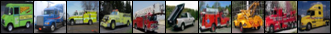

Train accuracy of bird = 97.58%
Hard negatives for bird


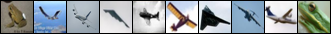

Train accuracy of cat = 92.50%
Hard negatives for cat


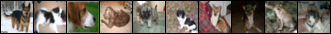

Train accuracy of deer = 99.44%
Hard negatives for deer


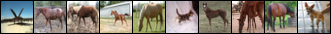

Train accuracy of dog = 97.72%
Hard negatives for dog


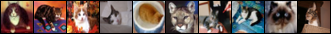

Train accuracy of frog = 99.54%
Hard negatives for frog


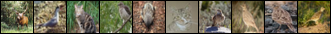

Train accuracy of horse = 97.54%
Hard negatives for horse


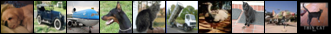

Train accuracy of ship = 99.94%
Hard negatives for ship


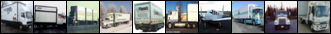

Train accuracy of truck = 88.70%
Hard negatives for truck


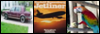


Test accuracy of the network: 81.35%
Test accuracy of plane = 68.40%
Hard negatives for plane


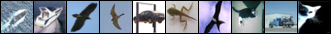

Test accuracy of car = 93.10%
Hard negatives for car


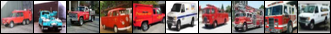

Test accuracy of bird = 77.20%
Hard negatives for bird


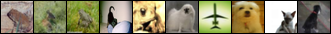

Test accuracy of cat = 60.80%
Hard negatives for cat


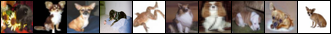

Test accuracy of deer = 89.40%
Hard negatives for deer


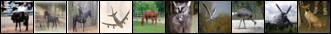

Test accuracy of dog = 77.50%
Hard negatives for dog


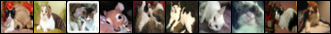

Test accuracy of frog = 90.10%
Hard negatives for frog


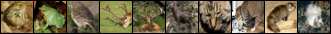

Test accuracy of horse = 84.40%
Hard negatives for horse


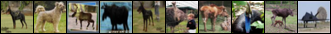

Test accuracy of ship = 95.70%
Hard negatives for ship


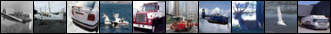

Test accuracy of truck = 76.90%
Hard negatives for truck


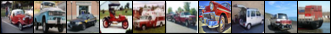


Epoch 10 summary -- loss = 0.053



Epoch 11 summary -- loss = 0.037



Epoch 12 summary -- loss = 0.019



Epoch 13 summary -- loss = 0.011



Epoch 14 summary -- loss = 0.019



Epoch 15 summary -- loss = 0.019



Epoch 16 summary -- loss = 0.004



Epoch 17 summary -- loss = 0.001



Epoch 18 summary -- loss = 0.046



Epoch 19 summary -- loss = 0.001
Evaluating epoch 20



Train accuracy of the network: 100.00%
Train accuracy of plane = 100.00%
No hard negatives for class: plane
Train accuracy of car = 100.00%
No hard negatives for class: car
Train accuracy of bird = 100.00%
Hard negatives for bird


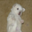

Train accuracy of cat = 100.00%
No hard negatives for class: cat
Train accuracy of deer = 100.00%
No hard negatives for class: deer
Train accuracy of dog = 99.98%
No hard negatives for class: dog
Train accuracy of frog = 100.00%
No hard negatives for class: frog
Train accuracy of horse = 100.00%
No hard negatives for class: horse
Train accuracy of ship = 100.00%
No hard negatives for class: ship
Train accuracy of truck = 100.00%
No hard negatives for class: truck



Test accuracy of the network: 85.77%
Test accuracy of plane = 89.30%
Hard negatives for plane


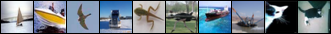

Test accuracy of car = 93.30%
Hard negatives for car


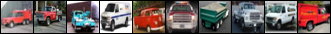

Test accuracy of bird = 77.40%
Hard negatives for bird


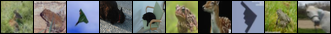

Test accuracy of cat = 73.80%
Hard negatives for cat


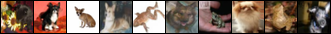

Test accuracy of deer = 85.10%
Hard negatives for deer


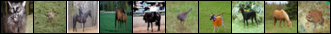

Test accuracy of dog = 77.60%
Hard negatives for dog


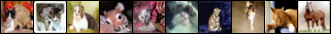

Test accuracy of frog = 89.30%
Hard negatives for frog


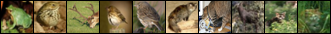

Test accuracy of horse = 88.40%
Hard negatives for horse


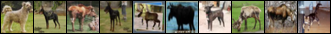

Test accuracy of ship = 92.40%
Hard negatives for ship


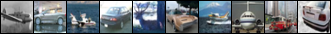

Test accuracy of truck = 91.10%
Hard negatives for truck


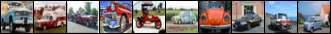


Epoch 20 summary -- loss = 0.000



Epoch 21 summary -- loss = 0.000



Epoch 22 summary -- loss = 0.000



Epoch 23 summary -- loss = 0.000



Epoch 24 summary -- loss = 0.000



Epoch 25 summary -- loss = 0.000



Epoch 26 summary -- loss = 0.000



Epoch 27 summary -- loss = 0.000



Epoch 28 summary -- loss = 0.000
Learning rate updated to: 0.010000000000000002



Epoch 29 summary -- loss = 0.000
Evaluating epoch 30



Train accuracy of the network: 100.00%
Train accuracy of plane = 100.00%
No hard negatives for class: plane
Train accuracy of car = 100.00%
No hard negatives for class: car
Train accuracy of bird = 100.00%
No hard negatives for class: bird
Train accuracy of cat = 100.00%
No hard negatives for class: cat
Train accuracy of deer = 100.00%
No hard negatives for class: deer
Train accuracy of dog = 100.00%
No hard negatives for class: dog
Train accuracy of frog = 100.00%
No hard negatives for class: frog
Train accuracy of horse = 100.00%
No hard negatives for class: horse
Train accuracy of ship = 100.00%
No hard negatives for class: ship
Train accuracy of truck = 100.00%
No hard negatives for class: truck



Test accuracy of the network: 85.97%
Test accuracy of plane = 88.30%
Hard negatives for plane


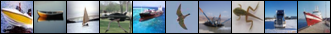

Test accuracy of car = 93.90%
Hard negatives for car


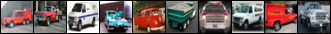

Test accuracy of bird = 78.50%
Hard negatives for bird


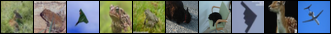

Test accuracy of cat = 72.60%
Hard negatives for cat


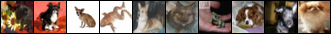

Test accuracy of deer = 86.00%
Hard negatives for deer


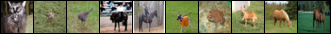

Test accuracy of dog = 79.10%
Hard negatives for dog


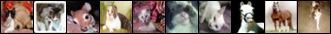

Test accuracy of frog = 89.60%
Hard negatives for frog


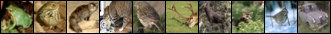

Test accuracy of horse = 89.40%
Hard negatives for horse


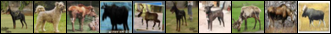

Test accuracy of ship = 91.10%
Hard negatives for ship


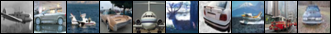

Test accuracy of truck = 91.20%
Hard negatives for truck


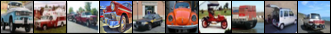


Epoch 30 summary -- loss = 0.000



Epoch 31 summary -- loss = 0.000



Epoch 32 summary -- loss = 0.000



Epoch 33 summary -- loss = 0.000



Epoch 34 summary -- loss = 0.000



Epoch 35 summary -- loss = 0.000



Epoch 36 summary -- loss = 0.000



Epoch 37 summary -- loss = 0.000



Epoch 38 summary -- loss = 0.000



Epoch 39 summary -- loss = 0.000
Evaluating epoch 40



Train accuracy of the network: 100.00%
Train accuracy of plane = 100.00%
No hard negatives for class: plane
Train accuracy of car = 100.00%
No hard negatives for class: car
Train accuracy of bird = 100.00%
No hard negatives for class: bird
Train accuracy of cat = 100.00%
No hard negatives for class: cat
Train accuracy of deer = 100.00%
No hard negatives for class: deer
Train accuracy of dog = 100.00%
No hard negatives for class: dog
Train accuracy of frog = 100.00%
No hard negatives for class: frog
Train accuracy of horse = 100.00%
No hard negatives for class: horse
Train accuracy of ship = 100.00%
No hard negatives for class: ship
Train accuracy of truck = 100.00%
No hard negatives for class: truck



Test accuracy of the network: 86.13%
Test accuracy of plane = 89.60%
Hard negatives for plane


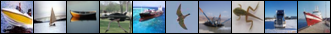

Test accuracy of car = 93.90%
Hard negatives for car


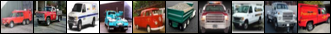

Test accuracy of bird = 79.20%
Hard negatives for bird


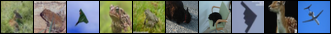

Test accuracy of cat = 72.20%
Hard negatives for cat


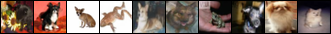

Test accuracy of deer = 85.20%
Hard negatives for deer


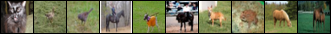

Test accuracy of dog = 80.00%
Hard negatives for dog


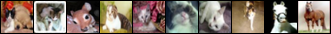

Test accuracy of frog = 89.30%
Hard negatives for frog


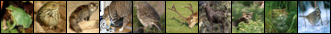

Test accuracy of horse = 89.40%
Hard negatives for horse


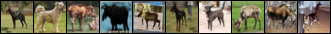

Test accuracy of ship = 91.30%
Hard negatives for ship


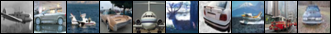

Test accuracy of truck = 91.20%
Hard negatives for truck


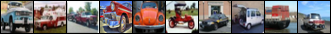


Epoch 40 summary -- loss = 0.000



Epoch 41 summary -- loss = 0.000



Epoch 42 summary -- loss = 0.000



Epoch 43 summary -- loss = 0.000



Epoch 44 summary -- loss = 0.000



Epoch 45 summary -- loss = 0.000



Epoch 46 summary -- loss = 0.000



Epoch 47 summary -- loss = 0.000



Epoch 48 summary -- loss = 0.000



Epoch 49 summary -- loss = 0.000
Evaluating epoch 50



Train accuracy of the network: 100.00%
Train accuracy of plane = 100.00%
No hard negatives for class: plane
Train accuracy of car = 100.00%
No hard negatives for class: car
Train accuracy of bird = 100.00%
No hard negatives for class: bird
Train accuracy of cat = 100.00%
No hard negatives for class: cat
Train accuracy of deer = 100.00%
No hard negatives for class: deer
Train accuracy of dog = 100.00%
No hard negatives for class: dog
Train accuracy of frog = 100.00%
No hard negatives for class: frog
Train accuracy of horse = 100.00%
No hard negatives for class: horse
Train accuracy of ship = 100.00%
No hard negatives for class: ship
Train accuracy of truck = 100.00%
No hard negatives for class: truck



Test accuracy of the network: 86.13%
Test accuracy of plane = 89.70%
Hard negatives for plane


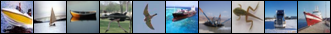

Test accuracy of car = 93.80%
Hard negatives for car


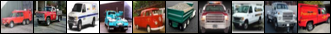

Test accuracy of bird = 79.10%
Hard negatives for bird


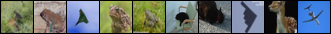

Test accuracy of cat = 72.30%
Hard negatives for cat


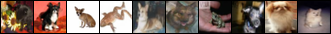

Test accuracy of deer = 85.30%
Hard negatives for deer


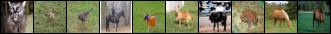

Test accuracy of dog = 79.90%
Hard negatives for dog


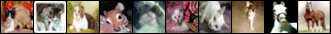

Test accuracy of frog = 89.20%
Hard negatives for frog


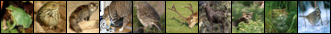

Test accuracy of horse = 89.40%
Hard negatives for horse


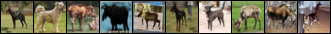

Test accuracy of ship = 91.50%
Hard negatives for ship


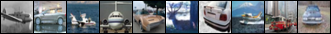

Test accuracy of truck = 91.10%
Hard negatives for truck


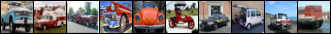


Epoch 50 summary -- loss = 0.000



Epoch 51 summary -- loss = 0.000



Epoch 52 summary -- loss = 0.000



Epoch 53 summary -- loss = 0.000



Epoch 54 summary -- loss = 0.000



Epoch 55 summary -- loss = 0.000



Epoch 56 summary -- loss = 0.000



Epoch 57 summary -- loss = 0.000



Epoch 58 summary -- loss = 0.000
Learning rate updated to: 0.0010000000000000002



Epoch 59 summary -- loss = 0.000
Evaluating epoch 60



Train accuracy of the network: 100.00%
Train accuracy of plane = 100.00%
No hard negatives for class: plane
Train accuracy of car = 100.00%
No hard negatives for class: car
Train accuracy of bird = 100.00%
No hard negatives for class: bird
Train accuracy of cat = 100.00%
No hard negatives for class: cat
Train accuracy of deer = 100.00%
No hard negatives for class: deer
Train accuracy of dog = 100.00%
No hard negatives for class: dog
Train accuracy of frog = 100.00%
No hard negatives for class: frog
Train accuracy of horse = 100.00%
No hard negatives for class: horse
Train accuracy of ship = 100.00%
No hard negatives for class: ship
Train accuracy of truck = 100.00%
No hard negatives for class: truck



Test accuracy of the network: 86.13%
Test accuracy of plane = 89.70%
Hard negatives for plane


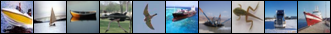

Test accuracy of car = 93.80%
Hard negatives for car


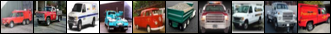

Test accuracy of bird = 79.00%
Hard negatives for bird


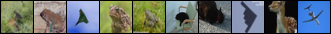

Test accuracy of cat = 72.30%
Hard negatives for cat


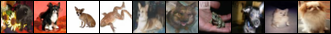

Test accuracy of deer = 85.30%
Hard negatives for deer


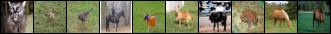

Test accuracy of dog = 80.10%
Hard negatives for dog


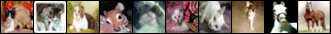

Test accuracy of frog = 89.20%
Hard negatives for frog


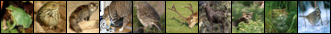

Test accuracy of horse = 89.30%
Hard negatives for horse


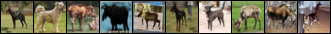

Test accuracy of ship = 91.50%
Hard negatives for ship


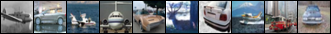

Test accuracy of truck = 91.10%
Hard negatives for truck


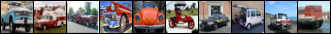


Epoch 60 summary -- loss = 0.000



Epoch 61 summary -- loss = 0.000



Epoch 62 summary -- loss = 0.000



Epoch 63 summary -- loss = 0.000



Epoch 64 summary -- loss = 0.000



Epoch 65 summary -- loss = 0.000



Epoch 66 summary -- loss = 0.000



Epoch 67 summary -- loss = 0.000



Epoch 68 summary -- loss = 0.000



Epoch 69 summary -- loss = 0.000
Evaluating epoch 70



Train accuracy of the network: 100.00%
Train accuracy of plane = 100.00%
No hard negatives for class: plane
Train accuracy of car = 100.00%
No hard negatives for class: car
Train accuracy of bird = 100.00%
No hard negatives for class: bird
Train accuracy of cat = 100.00%
No hard negatives for class: cat
Train accuracy of deer = 100.00%
No hard negatives for class: deer
Train accuracy of dog = 100.00%
No hard negatives for class: dog
Train accuracy of frog = 100.00%
No hard negatives for class: frog
Train accuracy of horse = 100.00%
No hard negatives for class: horse
Train accuracy of ship = 100.00%
No hard negatives for class: ship
Train accuracy of truck = 100.00%
No hard negatives for class: truck



Test accuracy of the network: 86.13%
Test accuracy of plane = 89.70%
Hard negatives for plane


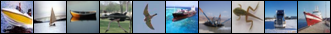

Test accuracy of car = 93.80%
Hard negatives for car


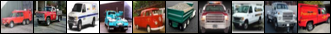

Test accuracy of bird = 79.00%
Hard negatives for bird


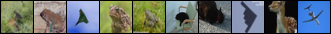

Test accuracy of cat = 72.30%
Hard negatives for cat


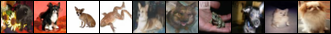

Test accuracy of deer = 85.30%
Hard negatives for deer


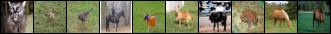

Test accuracy of dog = 80.10%
Hard negatives for dog


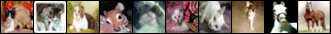

Test accuracy of frog = 89.20%
Hard negatives for frog


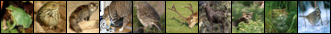

Test accuracy of horse = 89.30%
Hard negatives for horse


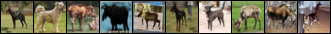

Test accuracy of ship = 91.50%
Hard negatives for ship


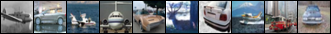

Test accuracy of truck = 91.10%
Hard negatives for truck


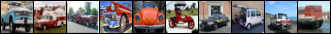


Epoch 70 summary -- loss = 0.000



Epoch 71 summary -- loss = 0.000



Epoch 72 summary -- loss = 0.000



Epoch 73 summary -- loss = 0.000



Epoch 74 summary -- loss = 0.000



Epoch 75 summary -- loss = 0.000



Epoch 76 summary -- loss = 0.000



Epoch 77 summary -- loss = 0.000



Epoch 78 summary -- loss = 0.000



Epoch 79 summary -- loss = 0.000
Evaluating epoch 80



Train accuracy of the network: 100.00%
Train accuracy of plane = 100.00%
No hard negatives for class: plane
Train accuracy of car = 100.00%
No hard negatives for class: car
Train accuracy of bird = 100.00%
No hard negatives for class: bird
Train accuracy of cat = 100.00%
No hard negatives for class: cat
Train accuracy of deer = 100.00%
No hard negatives for class: deer
Train accuracy of dog = 100.00%
No hard negatives for class: dog
Train accuracy of frog = 100.00%
No hard negatives for class: frog
Train accuracy of horse = 100.00%
No hard negatives for class: horse
Train accuracy of ship = 100.00%
No hard negatives for class: ship
Train accuracy of truck = 100.00%
No hard negatives for class: truck



Test accuracy of the network: 86.13%
Test accuracy of plane = 89.70%
Hard negatives for plane


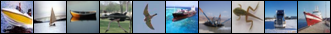

Test accuracy of car = 93.80%
Hard negatives for car


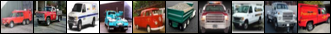

Test accuracy of bird = 79.00%
Hard negatives for bird


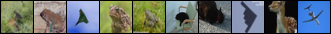

Test accuracy of cat = 72.30%
Hard negatives for cat


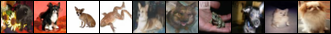

Test accuracy of deer = 85.30%
Hard negatives for deer


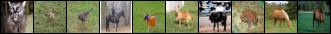

Test accuracy of dog = 80.10%
Hard negatives for dog


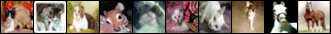

Test accuracy of frog = 89.20%
Hard negatives for frog


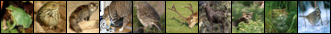

Test accuracy of horse = 89.30%
Hard negatives for horse


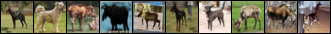

Test accuracy of ship = 91.50%
Hard negatives for ship


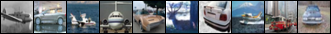

Test accuracy of truck = 91.10%
Hard negatives for truck


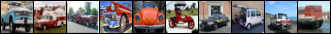


Epoch 80 summary -- loss = 0.000



Epoch 81 summary -- loss = 0.000



Epoch 82 summary -- loss = 0.000



Epoch 83 summary -- loss = 0.000



Epoch 84 summary -- loss = 0.000



Epoch 85 summary -- loss = 0.000



Epoch 86 summary -- loss = 0.000



Epoch 87 summary -- loss = 0.000



Epoch 88 summary -- loss = 0.000
Learning rate updated to: 0.00010000000000000003



Epoch 89 summary -- loss = 0.000
Evaluating epoch 90



Train accuracy of the network: 100.00%
Train accuracy of plane = 100.00%
No hard negatives for class: plane
Train accuracy of car = 100.00%
No hard negatives for class: car
Train accuracy of bird = 100.00%
No hard negatives for class: bird
Train accuracy of cat = 100.00%
No hard negatives for class: cat
Train accuracy of deer = 100.00%
No hard negatives for class: deer
Train accuracy of dog = 100.00%
No hard negatives for class: dog
Train accuracy of frog = 100.00%
No hard negatives for class: frog
Train accuracy of horse = 100.00%
No hard negatives for class: horse
Train accuracy of ship = 100.00%
No hard negatives for class: ship
Train accuracy of truck = 100.00%
No hard negatives for class: truck



Test accuracy of the network: 86.14%
Test accuracy of plane = 89.70%
Hard negatives for plane


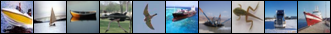

Test accuracy of car = 93.80%
Hard negatives for car


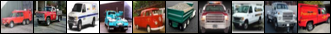

Test accuracy of bird = 79.00%
Hard negatives for bird


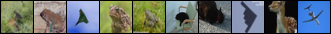

Test accuracy of cat = 72.40%
Hard negatives for cat


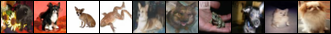

Test accuracy of deer = 85.30%
Hard negatives for deer


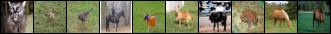

Test accuracy of dog = 80.10%
Hard negatives for dog


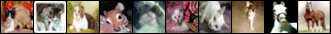

Test accuracy of frog = 89.20%
Hard negatives for frog


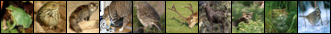

Test accuracy of horse = 89.30%
Hard negatives for horse


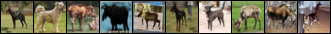

Test accuracy of ship = 91.50%
Hard negatives for ship


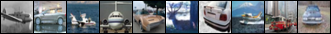

Test accuracy of truck = 91.10%
Hard negatives for truck


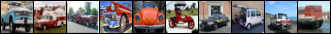

In [25]:
net = CoolNet()
train_losses, train_accuracies, test_accuracies = train_network(
    net, 
    lr_func=set_learning_rate,
    criterion=nn.CrossEntropyLoss(),
    lr=0.1, 
    epochs=90, 
    batch_size=128)

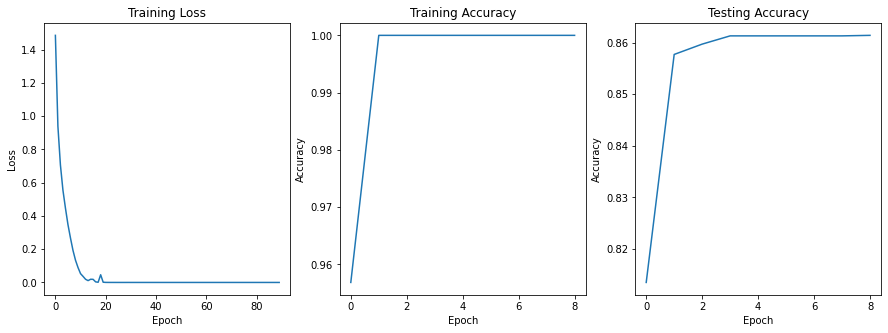

In [26]:
plot_results(train_losses, train_accuracies, test_accuracies)

**Question**: 
What do you observe? Why do you think it is useful to decrease the learning rate over time?

*TODO: Your answer here.*

We observe that starting with a high learning rate and decreasing it as training progresses leads to faster and stable convergence. Using large learning rate in the beginning helps in learning good weights early in fewer epochs. 

As the training goes on, decreasing the learning rate will keep the loss from oscillating when there's already less kinetic energy in the network. So slowly decreasing the learning rate over time keeps the weight updates stable and helps in finetuning them further. 

This is what we observe in above plots when the training loss drops significantly during first few epochs and then the further fine-tuning improves the test accuracy to upto 86.2%.

### 2.3.4. Data Augmentation

Most of the popular computer vision datasets have tens of thousands of images. 

Cifar-10 is a dataset of 60000 32x32 colour images in 10 classes, which can be relatively small in compare to ImageNet which has 1M images. 

The more the number of parameters is, the more likely our model is to overfit to the small dataset. 
As you might have already faced this issue while training the CoolNet, after some iterations the training accuracy reaches its maximum (saturates) while the test accuracy is still relatively low. 

To solve this problem, we use the data augmentation to help the network avoid overfitting.

Add data transformations in to the class below and compare the results. You are free to use any type and any number of data augmentation techniques.

Just be aware that data augmentation should just happen during training phase. 

In [0]:
train_transform = transforms.Compose([
    # TODO: Add data augmentations here
    # You can find a list of transforms here:
    #  https://pytorch.org/docs/stable/torchvision/transforms.html
    transforms.RandomCrop(32, padding=3),
    transforms.RandomHorizontalFlip(p=0.4),
    transforms.RandomAffine(degrees=(-20,20)),
    transforms.ToTensor(),
    # Normalize rescales and shifts the data so that it has a zero mean 
    # and unit variance. This reduces bias and makes it easier to learn!
    # The values here are the mean and variance of our inputs.
    # This will change the input images to be centered at 0 and be 
    # between -1 and 1.
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 1.645



Epoch 1 summary -- loss = 1.244



Epoch 2 summary -- loss = 1.040



Epoch 3 summary -- loss = 0.895



Epoch 4 summary -- loss = 0.792



Epoch 5 summary -- loss = 0.714



Epoch 6 summary -- loss = 0.654



Epoch 7 summary -- loss = 0.611



Epoch 8 summary -- loss = 0.574



Epoch 9 summary -- loss = 0.536
Evaluating epoch 10



Train accuracy of the network: 81.57%
Train accuracy of plane = 83.44%
Hard negatives for plane


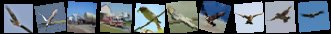

Train accuracy of car = 94.54%
Hard negatives for car


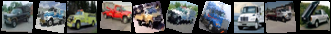

Train accuracy of bird = 65.30%
Hard negatives for bird


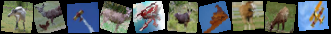

Train accuracy of cat = 54.18%
Hard negatives for cat


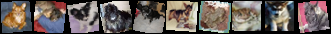

Train accuracy of deer = 77.50%
Hard negatives for deer


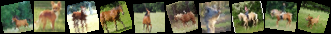

Train accuracy of dog = 88.42%
Hard negatives for dog


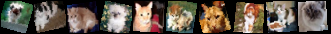

Train accuracy of frog = 88.18%
Hard negatives for frog


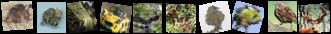

Train accuracy of horse = 81.30%
Hard negatives for horse


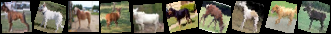

Train accuracy of ship = 91.16%
Hard negatives for ship


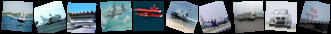

Train accuracy of truck = 90.22%
Hard negatives for truck


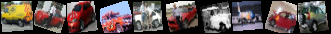


Test accuracy of the network: 81.09%
Test accuracy of plane = 81.50%
Hard negatives for plane


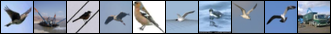

Test accuracy of car = 93.50%
Hard negatives for car


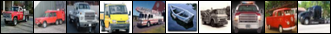

Test accuracy of bird = 64.70%
Hard negatives for bird


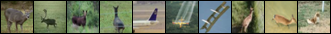

Test accuracy of cat = 54.30%
Hard negatives for cat


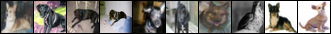

Test accuracy of deer = 73.30%
Hard negatives for deer


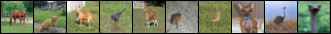

Test accuracy of dog = 87.50%
Hard negatives for dog


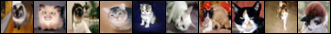

Test accuracy of frog = 89.30%
Hard negatives for frog


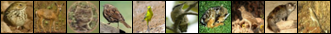

Test accuracy of horse = 83.60%
Hard negatives for horse


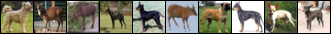

Test accuracy of ship = 91.00%
Hard negatives for ship


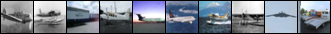

Test accuracy of truck = 92.20%
Hard negatives for truck


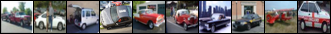


Epoch 10 summary -- loss = 0.503



Epoch 11 summary -- loss = 0.474



Epoch 12 summary -- loss = 0.453



Epoch 13 summary -- loss = 0.427



Epoch 14 summary -- loss = 0.405



Epoch 15 summary -- loss = 0.392



Epoch 16 summary -- loss = 0.373



Epoch 17 summary -- loss = 0.357



Epoch 18 summary -- loss = 0.336



Epoch 19 summary -- loss = 0.324
Evaluating epoch 20



Train accuracy of the network: 88.84%
Train accuracy of plane = 89.98%
Hard negatives for plane


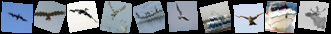

Train accuracy of car = 95.06%
Hard negatives for car


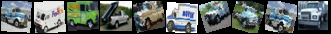

Train accuracy of bird = 82.62%
Hard negatives for bird


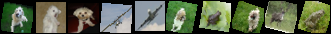

Train accuracy of cat = 80.76%
Hard negatives for cat


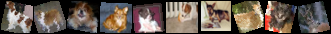

Train accuracy of deer = 88.06%
Hard negatives for deer


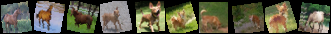

Train accuracy of dog = 74.90%
Hard negatives for dog


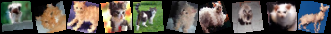

Train accuracy of frog = 98.02%
Hard negatives for frog


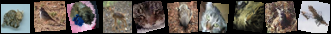

Train accuracy of horse = 91.30%
Hard negatives for horse


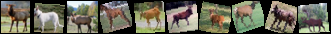

Train accuracy of ship = 94.46%
Hard negatives for ship


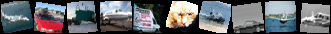

Train accuracy of truck = 93.80%
Hard negatives for truck


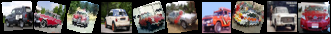


Test accuracy of the network: 85.20%
Test accuracy of plane = 85.50%
Hard negatives for plane


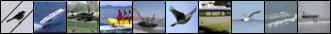

Test accuracy of car = 94.10%
Hard negatives for car


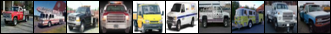

Test accuracy of bird = 77.00%
Hard negatives for bird


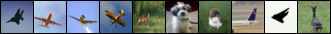

Test accuracy of cat = 73.50%
Hard negatives for cat


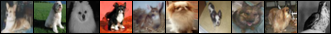

Test accuracy of deer = 81.00%
Hard negatives for deer


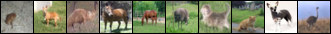

Test accuracy of dog = 70.90%
Hard negatives for dog


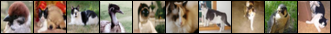

Test accuracy of frog = 96.40%
Hard negatives for frog


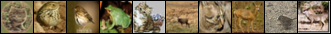

Test accuracy of horse = 88.40%
Hard negatives for horse


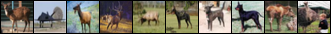

Test accuracy of ship = 92.20%
Hard negatives for ship


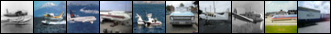

Test accuracy of truck = 93.00%
Hard negatives for truck


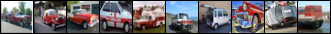


Epoch 20 summary -- loss = 0.308



Epoch 21 summary -- loss = 0.300



Epoch 22 summary -- loss = 0.288



Epoch 23 summary -- loss = 0.276



Epoch 24 summary -- loss = 0.264



Epoch 25 summary -- loss = 0.251



Epoch 26 summary -- loss = 0.242



Epoch 27 summary -- loss = 0.232



Epoch 28 summary -- loss = 0.225



Epoch 29 summary -- loss = 0.215
Evaluating epoch 30



Train accuracy of the network: 91.81%
Train accuracy of plane = 93.06%
Hard negatives for plane


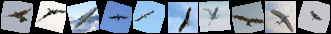

Train accuracy of car = 97.20%
Hard negatives for car


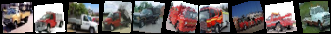

Train accuracy of bird = 83.02%
Hard negatives for bird


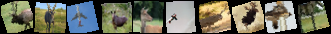

Train accuracy of cat = 93.20%
Hard negatives for cat


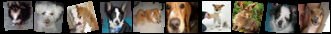

Train accuracy of deer = 83.56%
Hard negatives for deer


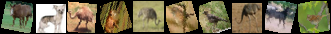

Train accuracy of dog = 82.50%
Hard negatives for dog


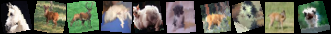

Train accuracy of frog = 96.72%
Hard negatives for frog


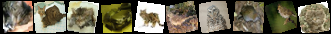

Train accuracy of horse = 96.50%
Hard negatives for horse


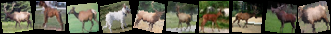

Train accuracy of ship = 97.88%
Hard negatives for ship


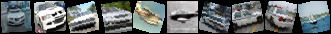

Train accuracy of truck = 94.68%
Hard negatives for truck


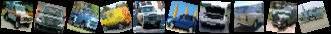


Test accuracy of the network: 85.30%
Test accuracy of plane = 87.10%
Hard negatives for plane


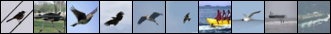

Test accuracy of car = 93.20%
Hard negatives for car


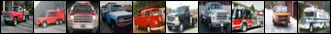

Test accuracy of bird = 71.40%
Hard negatives for bird


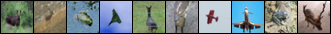

Test accuracy of cat = 84.70%
Hard negatives for cat


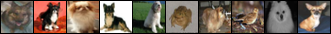

Test accuracy of deer = 70.50%
Hard negatives for deer


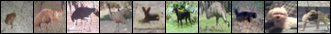

Test accuracy of dog = 74.60%
Hard negatives for dog


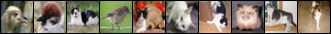

Test accuracy of frog = 93.60%
Hard negatives for frog


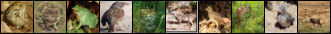

Test accuracy of horse = 91.90%
Hard negatives for horse


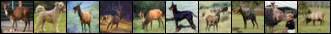

Test accuracy of ship = 95.00%
Hard negatives for ship


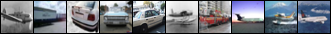

Test accuracy of truck = 91.00%
Hard negatives for truck


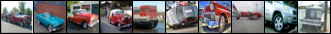

In [28]:
net = CoolNet()
train_losses, train_accuracies, test_accuracies = train_network(
    net, 
    criterion=nn.CrossEntropyLoss(),
    train_transform=train_transform,
    lr=0.1, 
    epochs=30, 
    batch_size=128)

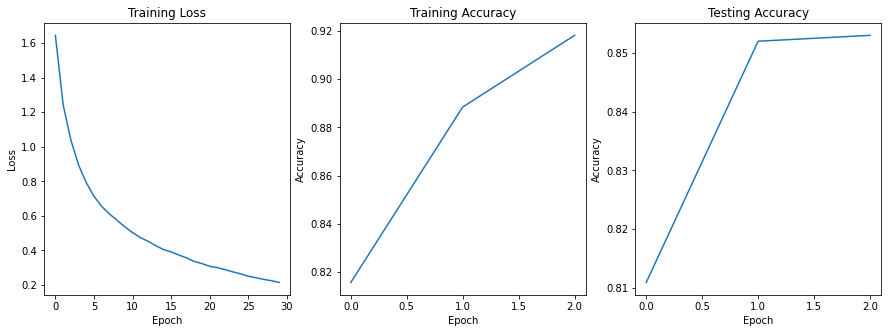

In [29]:
plot_results(train_losses, train_accuracies, test_accuracies)

**Question**: How does the model trained with data augmentation compared to the model trained without?

*TODO: Your answer here.*

When using data augmentation techniques such as random crop, random flipping, we introduce more diversity in the training dataset. As a result the network doesn't overfit on the training data and that leads to better generalization on the test set.

Here, we observe that when training with a batch size of 128 and learning rate of 0.1, the training accuracy goes to 92% (as opposed to 100% training accuracy without any training data augmentation). The test accuracy is around 85.5 % (as opposed to 86% test accuracy without any training data augmentation). So, in this case, the gap between the training and test accuracy is lower, suggesting better generalizability of the model on unseen test set.

### 2.3.5. Change the loss function

Try Mean Squared Error loss instead of Cross Entropy.

Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 0.095



Epoch 1 summary -- loss = 0.090



Epoch 2 summary -- loss = 0.089



Epoch 3 summary -- loss = 0.088



Epoch 4 summary -- loss = 0.087



Epoch 5 summary -- loss = 0.087



Epoch 6 summary -- loss = 0.086



Epoch 7 summary -- loss = 0.085



Epoch 8 summary -- loss = 0.085



Epoch 9 summary -- loss = 0.084
Evaluating epoch 10



Train accuracy of the network: 33.27%
Train accuracy of plane = 53.10%
Hard negatives for plane


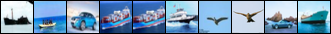

Train accuracy of car = 57.86%
Hard negatives for car


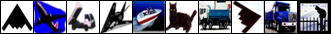

Train accuracy of bird = 18.80%
Hard negatives for bird


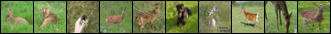

Train accuracy of cat = 13.26%
Hard negatives for cat


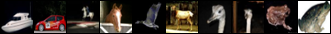

Train accuracy of deer = 23.30%
Hard negatives for deer


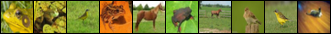

Train accuracy of dog = 23.14%
Hard negatives for dog


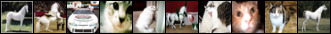

Train accuracy of frog = 51.50%
Hard negatives for frog


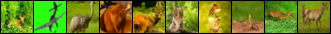

Train accuracy of horse = 38.82%
Hard negatives for horse


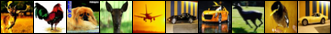

Train accuracy of ship = 33.36%
Hard negatives for ship


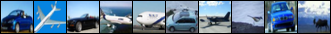

Train accuracy of truck = 19.80%
Hard negatives for truck


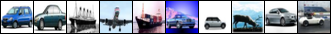


Test accuracy of the network: 33.33%
Test accuracy of plane = 56.10%
Hard negatives for plane


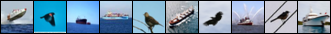

Test accuracy of car = 58.00%
Hard negatives for car


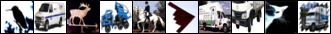

Test accuracy of bird = 16.10%
Hard negatives for bird


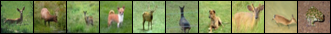

Test accuracy of cat = 12.00%
Hard negatives for cat


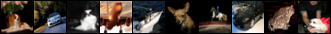

Test accuracy of deer = 24.60%
Hard negatives for deer


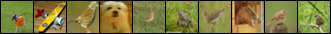

Test accuracy of dog = 21.40%
Hard negatives for dog


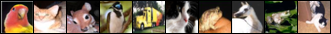

Test accuracy of frog = 54.90%
Hard negatives for frog


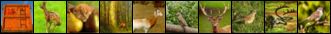

Test accuracy of horse = 39.80%
Hard negatives for horse


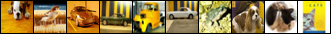

Test accuracy of ship = 31.80%
Hard negatives for ship


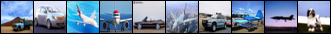

Test accuracy of truck = 18.60%
Hard negatives for truck


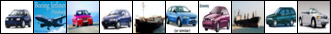


Epoch 10 summary -- loss = 0.083



Epoch 11 summary -- loss = 0.083



Epoch 12 summary -- loss = 0.082



Epoch 13 summary -- loss = 0.082



Epoch 14 summary -- loss = 0.081



Epoch 15 summary -- loss = 0.081



Epoch 16 summary -- loss = 0.081



Epoch 17 summary -- loss = 0.080



Epoch 18 summary -- loss = 0.080



Epoch 19 summary -- loss = 0.080
Evaluating epoch 20



Train accuracy of the network: 38.87%
Train accuracy of plane = 54.42%
Hard negatives for plane


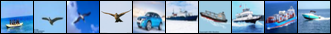

Train accuracy of car = 58.94%
Hard negatives for car


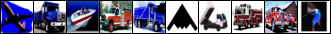

Train accuracy of bird = 14.42%
Hard negatives for bird


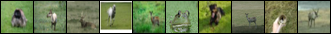

Train accuracy of cat = 16.50%
Hard negatives for cat


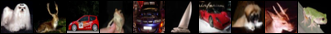

Train accuracy of deer = 38.30%
Hard negatives for deer


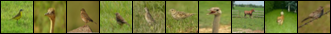

Train accuracy of dog = 29.08%
Hard negatives for dog


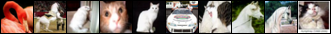

Train accuracy of frog = 55.84%
Hard negatives for frog


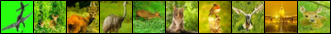

Train accuracy of horse = 43.16%
Hard negatives for horse


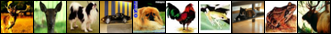

Train accuracy of ship = 50.58%
Hard negatives for ship


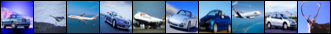

Train accuracy of truck = 28.12%
Hard negatives for truck


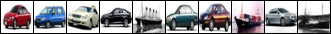


Test accuracy of the network: 39.17%
Test accuracy of plane = 55.50%
Hard negatives for plane


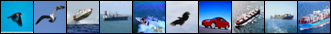

Test accuracy of car = 59.10%
Hard negatives for car


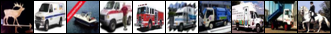

Test accuracy of bird = 13.30%
Hard negatives for bird


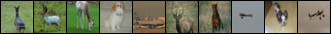

Test accuracy of cat = 13.90%
Hard negatives for cat


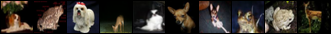

Test accuracy of deer = 39.30%
Hard negatives for deer


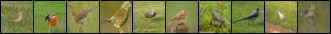

Test accuracy of dog = 28.40%
Hard negatives for dog


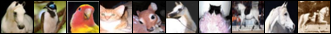

Test accuracy of frog = 58.40%
Hard negatives for frog


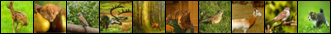

Test accuracy of horse = 45.00%
Hard negatives for horse


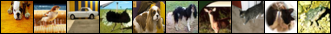

Test accuracy of ship = 50.60%
Hard negatives for ship


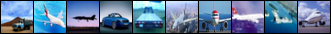

Test accuracy of truck = 28.20%
Hard negatives for truck


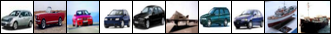


Epoch 20 summary -- loss = 0.079



Epoch 21 summary -- loss = 0.079



Epoch 22 summary -- loss = 0.079



Epoch 23 summary -- loss = 0.078



Epoch 24 summary -- loss = 0.078



Epoch 25 summary -- loss = 0.078



Epoch 26 summary -- loss = 0.077



Epoch 27 summary -- loss = 0.077



Epoch 28 summary -- loss = 0.077



Epoch 29 summary -- loss = 0.076
Evaluating epoch 30



Train accuracy of the network: 42.82%
Train accuracy of plane = 53.92%
Hard negatives for plane


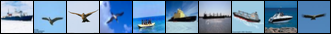

Train accuracy of car = 61.68%
Hard negatives for car


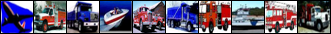

Train accuracy of bird = 14.36%
Hard negatives for bird


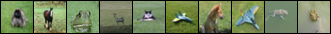

Train accuracy of cat = 24.26%
Hard negatives for cat


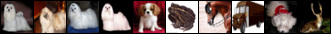

Train accuracy of deer = 39.52%
Hard negatives for deer


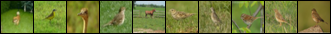

Train accuracy of dog = 35.44%
Hard negatives for dog


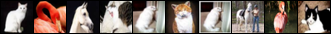

Train accuracy of frog = 57.16%
Hard negatives for frog


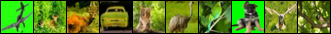

Train accuracy of horse = 48.74%
Hard negatives for horse


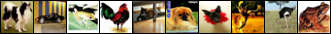

Train accuracy of ship = 54.58%
Hard negatives for ship


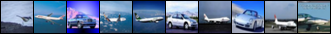

Train accuracy of truck = 38.08%
Hard negatives for truck


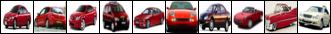


Test accuracy of the network: 43.03%
Test accuracy of plane = 54.90%
Hard negatives for plane


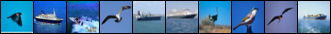

Test accuracy of car = 63.00%
Hard negatives for car


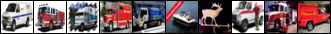

Test accuracy of bird = 12.00%
Hard negatives for bird


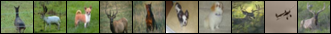

Test accuracy of cat = 22.60%
Hard negatives for cat


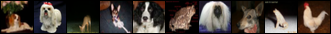

Test accuracy of deer = 40.40%
Hard negatives for deer


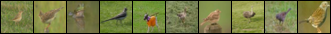

Test accuracy of dog = 34.50%
Hard negatives for dog


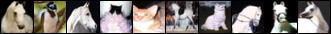

Test accuracy of frog = 60.60%
Hard negatives for frog


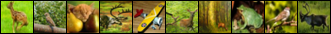

Test accuracy of horse = 51.90%
Hard negatives for horse


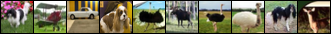

Test accuracy of ship = 54.10%
Hard negatives for ship


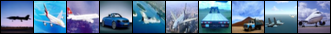

Test accuracy of truck = 36.30%
Hard negatives for truck


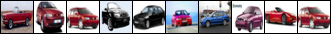


Epoch 30 summary -- loss = 0.076



Epoch 31 summary -- loss = 0.076



Epoch 32 summary -- loss = 0.076



Epoch 33 summary -- loss = 0.075



Epoch 34 summary -- loss = 0.075



Epoch 35 summary -- loss = 0.075



Epoch 36 summary -- loss = 0.075



Epoch 37 summary -- loss = 0.075



Epoch 38 summary -- loss = 0.074



Epoch 39 summary -- loss = 0.074
Evaluating epoch 40



Train accuracy of the network: 45.63%
Train accuracy of plane = 53.64%
Hard negatives for plane


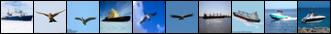

Train accuracy of car = 61.52%
Hard negatives for car


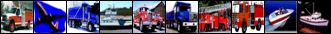

Train accuracy of bird = 14.16%
Hard negatives for bird


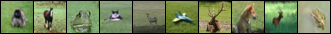

Train accuracy of cat = 30.64%
Hard negatives for cat


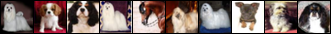

Train accuracy of deer = 39.32%
Hard negatives for deer


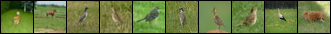

Train accuracy of dog = 41.04%
Hard negatives for dog


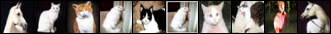

Train accuracy of frog = 60.40%
Hard negatives for frog


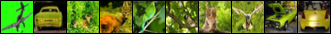

Train accuracy of horse = 51.40%
Hard negatives for horse


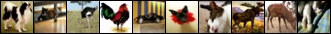

Train accuracy of ship = 56.36%
Hard negatives for ship


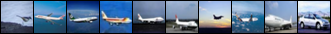

Train accuracy of truck = 47.38%
Hard negatives for truck


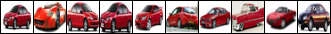


Test accuracy of the network: 45.51%
Test accuracy of plane = 55.30%
Hard negatives for plane


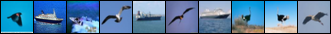

Test accuracy of car = 62.40%
Hard negatives for car


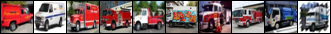

Test accuracy of bird = 11.00%
Hard negatives for bird


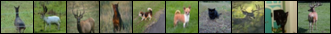

Test accuracy of cat = 29.00%
Hard negatives for cat


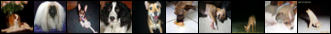

Test accuracy of deer = 39.40%
Hard negatives for deer


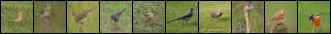

Test accuracy of dog = 39.80%
Hard negatives for dog


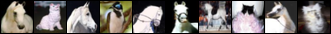

Test accuracy of frog = 64.50%
Hard negatives for frog


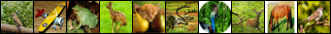

Test accuracy of horse = 54.60%
Hard negatives for horse


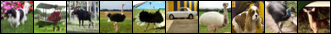

Test accuracy of ship = 55.70%
Hard negatives for ship


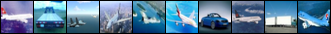

Test accuracy of truck = 43.40%
Hard negatives for truck


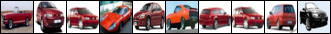


Epoch 40 summary -- loss = 0.074



Epoch 41 summary -- loss = 0.074



Epoch 42 summary -- loss = 0.074



Epoch 43 summary -- loss = 0.073



Epoch 44 summary -- loss = 0.073



Epoch 45 summary -- loss = 0.073



Epoch 46 summary -- loss = 0.073



Epoch 47 summary -- loss = 0.073



Epoch 48 summary -- loss = 0.072



Epoch 49 summary -- loss = 0.072
Evaluating epoch 50



Train accuracy of the network: 47.62%
Train accuracy of plane = 54.46%
Hard negatives for plane


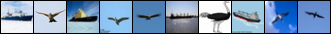

Train accuracy of car = 64.52%
Hard negatives for car


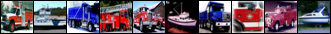

Train accuracy of bird = 15.80%
Hard negatives for bird


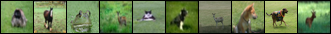

Train accuracy of cat = 34.16%
Hard negatives for cat


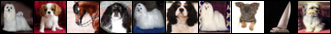

Train accuracy of deer = 39.24%
Hard negatives for deer


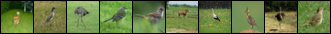

Train accuracy of dog = 42.80%
Hard negatives for dog


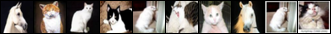

Train accuracy of frog = 61.94%
Hard negatives for frog


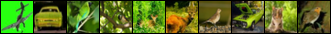

Train accuracy of horse = 55.06%
Hard negatives for horse


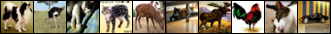

Train accuracy of ship = 57.68%
Hard negatives for ship


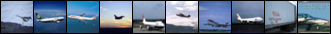

Train accuracy of truck = 50.64%
Hard negatives for truck


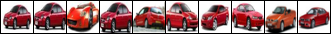


Test accuracy of the network: 47.25%
Test accuracy of plane = 56.40%
Hard negatives for plane


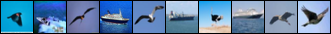

Test accuracy of car = 64.30%
Hard negatives for car


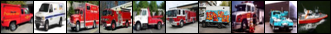

Test accuracy of bird = 13.10%
Hard negatives for bird


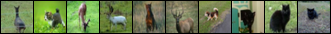

Test accuracy of cat = 32.20%
Hard negatives for cat


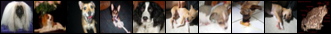

Test accuracy of deer = 39.80%
Hard negatives for deer


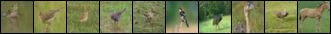

Test accuracy of dog = 40.40%
Hard negatives for dog


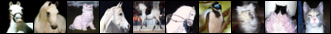

Test accuracy of frog = 65.00%
Hard negatives for frog


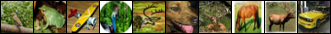

Test accuracy of horse = 57.50%
Hard negatives for horse


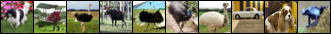

Test accuracy of ship = 57.50%
Hard negatives for ship


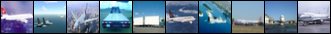

Test accuracy of truck = 46.30%
Hard negatives for truck


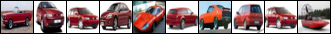

In [39]:
class MSELossClassification(nn.Module):
  def forward(self, output, labels):
    one_hot_encoded_labels = \
      torch.nn.functional.one_hot(labels, num_classes=output.shape[1]).float()
    return nn.functional.mse_loss(output, one_hot_encoded_labels)

net = CoolNet()
train_losses, train_accuracies, test_accuracies = train_network(
    net, 
    criterion=MSELossClassification(),
    lr=0.01, 
    epochs=50, 
    batch_size=1024)
# didn't change the learning rate and batch size as we tried and tuned learning rate and batch sizes corresponding to Cross entropy loss

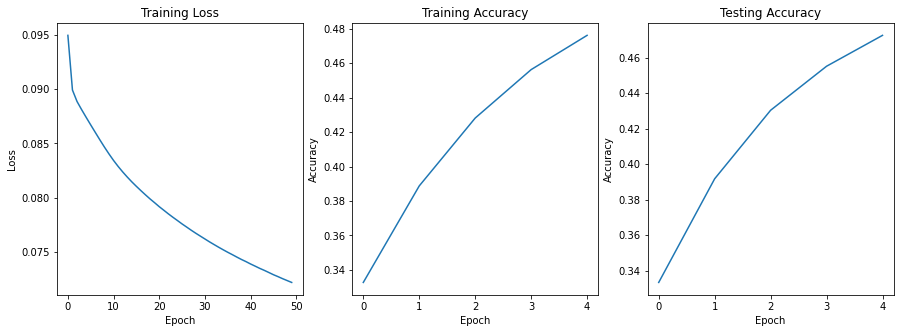

In [40]:
plot_results(train_losses, train_accuracies, test_accuracies)

**Question**:
How does this affects the results? Explain why you think this is happening.

*TODO: Your answer here.*

When the Cool Net is trained using Cross entropy loss for 30 epochs with learning rate of 0.01 and batch size of 1024, we get training and test accuracy as 71.67% and 69% respectively. When the network is trained in similar settings with 50 epochs and mean squared error as loss, the training and test accuracy reduces to 47.62% and 47.25% respectively.

The loss landscape changes as well with MSE loss eventually dropping to 0.07 from 0.095 (as compared to CE loss dropping to 0.8 from 2.2).

The difference could be attributed to MSE loss selection as the task-at-hand is a multi-class classification task, whereas Mean Squared error loss is used for regression. CE loss penalizes the predictions that deviate a lot from the target class heavily (because only the predictions against the correct class are weighed into), whereas MSE loss tries to learn the actual value corresponding to each class. So instead of learning to approximate the multinomial distribution of classes, the MSE loss will try to find a right balance of outputs at 0 and 1 positions (since it penalizes incorrect outputs for all classes equally)  and in the process learns poor confidence intervals. Hence, for MSE loss, we get relatively bad performance when compared against Cross entropy.

## Turning In

You're done! You just need to turn in the notebook file.

Go to `File > Download .ipynb` and download the file as `hw4.ipynb`. Turn in only this file.

Make sure that you've answered all questions and all plots are correct.